---
---

#**MACHINE LEARNING: ALGORITMOS SUPERVISADOS**
Docente: Paulette N. Reyes Baeza

<img src='https://cdn-icons-png.flaticon.com/512/25/25231.png' width=3%>   [Github](https://github.com/paulette-reyes)

---
---

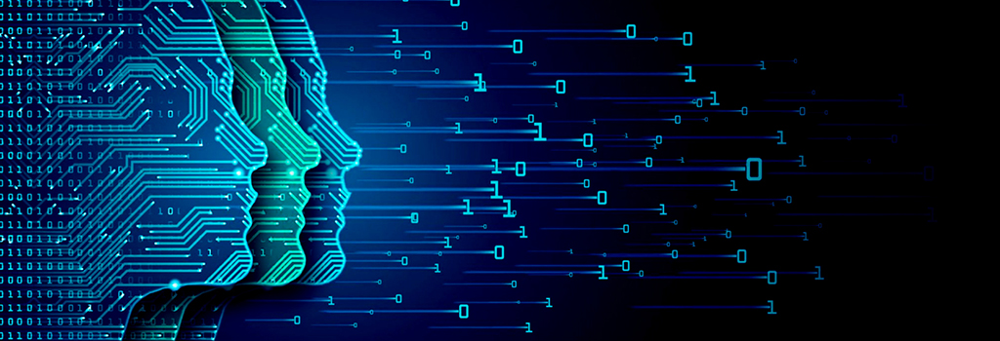

#**ETAPA I: COMPRENSIÓN DEL NEGOCIO**

**Dataset:**

El siguiente conjunto de datos contiene información de casas en venta dentro de la Región Metropolitana. Los datos fueron extraídos a través de web scrapping desde https://chilepropiedades.cl/

Este dataset solo contiene CASAS en venta. No incluye departamentos o terrenos.

Es muy posible que hayan avisos cuya información fue ingresada incorrectamente. ej: Una casa con 100 km2 de terreno.

FUENTE: https://www.kaggle.com/datasets/luisfelipetn/valor-casas-usadas-chile-rm-08032023/code

**Objetivo:**

> Predecir el precio de las casas y su venta.

**Diccionario de variables:**

*   Precio_CLP: Precio de casa en pesos chilenos (CLP)
*   Precio_UF: Precio de casa en unidades de fomento (UF)
*   Comuna: Comuna en la que se encuentra la casa.
*   Ubicacion: Ubicación más específica de la casa
*   N_Habitaciones: Cuantas habitaciones tiene la casa
*   N_Baños: Cuantos baños tiene la casa
*   Superficie_Construida_M2: Cuantos metros cuadrados construidos tiene la casa
*   Total_Superficie_M2: Cuantos metros cuadrados tiene toda la propiedad
*   N_Estacionamientos: Cuantos estacionamentos tiene la casa
*   id: Codigo de la casa en https://chilepropiedades.cl/ ; Ej: https://chilepropiedades.cl/ver-publicacion/11607213
*   Corredora: El corredor de bienes raíces
*   Estado: Estado de la publicación de la casa, EN VENTA o VENDIDA

**Desarrollo:**

➡️ Identifique las variables dependientes e independientes.

➡️ Realizar una separación del dataset en conjuntos de entrenamiento y prueba para validar los resultados de los modelos.

➡️ Experimente con distintos modelos para realizar sus predicciones.

➡️ Evalúe el nivel de error y exactitud de cada modelo.

➡️ Compare los modelos realizados y elija el modelo ganador con base en los criterios de la etapa de evaluación.

➡️ Realice un pronóstico de la variable objetivo con el modelo ganador, cargando datos nuevos no utilizados en el proceso de entrenamiento y validación de los modelos.

➡️ Interprete sus resultados.




---



#**ETAPA II: COMPRENSIÓN DE LOS DATOS**

✅ Importar librerías básicas

In [ ]:
#Librerías de Python

import numpy as np #Programación vectorial
import pandas as pd #Estructura y manipulación de datos
import matplotlib.pyplot as plt #Visualización

import seaborn as sb #Gráficos
from seaborn import kdeplot
from seaborn import lmplot
from seaborn import boxplot

import warnings #Advertencias
warnings.filterwarnings('ignore')

✅ Cargar archivo

**Opción 1:** Subir el archivo a Colab directamente en la carpeta "Archivos". (Advertencia: El archivo se elimina luego que se desconecta el entorno de ejecución por lo que no es recomendable para tareas que requieren mucho tiempo de trabajo)

In [ ]:
data = pd.read_csv("Guia_ML_Supervisado.csv", sep= ";", encoding='latin-1', error_bad_lines=False)

**Opción 2:** Abrir un archivo local desde el computador

In [ ]:
from google.colab import files
uploaded = files.upload()

for fn in uploaded.keys():
    name=fn
data = pd.read_csv(name, sep= ";", encoding='latin-1', error_bad_lines=False)

Saving Guia_Machine_Learning.csv to Guia_Machine_Learning.csv


**Opción 3:** Importar desde Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

data = pd.read_csv("/content/drive/My Drive/MATERIAL CLASES/Machine Learning/Guia_ML_Supervisado.csv",
                   sep= ";", encoding='latin-1', error_bad_lines=False)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


##**1. Exploración inicial**

Primero revisamos cuantos registros (filas) y cuántas variables (columnas) tiene el set de datos:

In [ ]:
#Cantidad de filas x cantidad de columnas
print(data.shape)

(17069, 12)


In [ ]:
len(data.columns)

12

Revisamos los nombres de las variables, es decir, de cada columna:

In [ ]:
list(data.columns.values)

['Precio_CLP',
 'Precio_UF',
 'Comuna',
 'Ubicacion',
 'N_Habitaciones',
 'N_Baños',
 'Superficie_Construida_M2',
 'Total_Superficie_M2',
 'N_Estacionamientos',
 'id',
 'Corredora',
 'Estado']

Inspeccionamos los tipos de variables:

In [ ]:
#Tipo de datos
data.dtypes

Precio_CLP                    int64
Precio_UF                   float64
Comuna                       object
Ubicacion                    object
N_Habitaciones              float64
N_Baños                     float64
Superficie_Construida_M2    float64
Total_Superficie_M2         float64
N_Estacionamientos          float64
id                          float64
Corredora                    object
Estado                       object
dtype: object

Visualización del dataset:

In [ ]:
#Primeros registros
data.head()

,Precio_CLP,Precio_UF,Comuna,Ubicacion,N_Habitaciones,N_Baños,Superficie_Construida_M2,Total_Superficie_M2,N_Estacionamientos,id,Corredora,Estado
0,1582331400,44460.0,SanBernardo,Autopiatacentral/EstacionNos,3.0,2.0,200.0,12500.0,NaN,1213620.0,Jorge Pablo Caro Propiedades,EN VENTA
1,1604072340,44460.0,SanBernardo,Autopiatacentral/EstacionNos,3.0,2.0,200.0,12500.0,NaN,1213620.0,Jorge Pablo Caro Propiedades,EN VENTA
2,569440000,16000.0,LaReina,Loreley/MonseÃ±oredwards,4.0,3.0,180.0,600.0,1.0,1367271.0,Propiedades Ricardo Vial y Cia. Ltda.,EN VENTA
3,341308100,9590.0,ÃuÃ±oa,MetroÃuÃ±oa/PedrodeValdivia,7.0,5.0,300.0,576.0,3.0,1796413.0,Propiedades Ricardo Vial y Cia. Ltda.,EN VENTA
4,889750000,25000.0,Vitacura,Tabancura,6.0,5.0,238.0,390.0,2.0,1933271.0,Vivaqui Propiedades,EN VENTA


In [ ]:
#Ultimos registros
data.tail()

,Precio_CLP,Precio_UF,Comuna,Ubicacion,N_Habitaciones,N_Baños,Superficie_Construida_M2,Total_Superficie_M2,N_Estacionamientos,id,Corredora,Estado
17064,59990000,1663.0,Pudahuel,CruzdelSur,2.0,1.0,NaN,NaN,NaN,20155404.0,J.E Propiedades Spa,VENDIDA
17065,89990000,2494.0,MaipÃº,ElRedentor,3.0,2.0,NaN,NaN,1.0,20155428.0,J.E Propiedades Spa,VENDIDA
17066,53000000,1469.0,MaipÃº,LasTinajas,2.0,1.0,64.0,62.0,1.0,20158966.0,Paula Vivanco Arenas,EN VENTA
17067,150000000,4158.0,MaipÃº,LasNaciones180,3.0,2.0,80.0,160.0,2.0,20161463.0,NaN,EN VENTA
17068,393261100,10900.0,LasCondes,Remodelar,NaN,NaN,NaN,NaN,NaN,NaN,NaN,EN VENTA


In [ ]:
#Registro aleatorio
data.sample(5)

,Precio_CLP,Precio_UF,Comuna,Ubicacion,N_Habitaciones,N_Baños,Superficie_Construida_M2,Total_Superficie_M2,N_Estacionamientos,id,Corredora,Estado
16143,110000000,3049.0,Santiago,JoseMiguelInfante,3.0,1.0,54.0,54.0,1.0,19474217.0,Corredores Asociados,VENDIDA
6489,100000000,2772.0,Renca,Costaneranorteag/toconce,7.0,3.0,154.0,210.0,NaN,10890015.0,Propiedades Centro Santiago SPA,VENDIDA
14048,645814100,17900.0,LasCondes,SanCarlosdeApoquindo,6.0,5.0,210.0,340.0,NaN,16854974.0,AgustÃ­n Fuenzalida Propiedades,EN VENTA
5549,120000000,3372.0,LaFlorida,Sevendeacogedoracasa1pisolaflorida120millone...,3.0,1.0,65.0,166.0,1.0,10217391.0,Scn Propiedades Ltda,VENDIDA
12663,793738000,22000.0,AlhuÃ©,Lagorapel,6.0,5.0,320.0,1000.0,NaN,14521082.0,NaN,EN VENTA


Transformamos el set de datos en un `dataframe` de Pandas para poder realizar modificaciones a los datos:

In [ ]:
#Transformacion a Data Frame
df = pd.DataFrame(data)

In [ ]:
#Resumen
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17069 entries, 0 to 17068
Data columns (total 12 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Precio_CLP                17069 non-null  int64  
 1   Precio_UF                 17069 non-null  float64
 2   Comuna                    17069 non-null  object 
 3   Ubicacion                 17069 non-null  object 
 4   N_Habitaciones            16979 non-null  float64
 5   N_Baños                   16850 non-null  float64
 6   Superficie_Construida_M2  16544 non-null  float64
 7   Total_Superficie_M2       16626 non-null  float64
 8   N_Estacionamientos        11858 non-null  float64
 9   id                        17068 non-null  float64
 10  Corredora                 15307 non-null  object 
 11  Estado                    17069 non-null  object 
dtypes: float64(7), int64(1), object(4)
memory usage: 1.6+ MB


Conociendo las clases únicas de variables categóricas (cualitativas):

In [ ]:
df['Comuna'].unique()

array(['SanBernardo', 'LaReina', 'Ã\x91uÃ±oa', 'Vitacura', 'LaCisterna',
       'EstaciÃ³nCentral', 'LasCondes', 'ElBosque', 'LoBarnechea',
       'PuenteAlto', 'ConchalÃ\xad', 'Buin', 'SanMiguel', 'Talagante',
       'LaFlorida', 'PeÃ±aflor', 'Colina', 'Providencia', 'Santiago',
       'Quilicura', 'LoEspejo', 'PeÃ±alolÃ©n', 'PedroAguirreCerda',
       'Cerrillos', 'QuintaNormal', 'Tiltil', 'SanJoaquÃ\xadn', 'MaipÃº',
       'PadreHurtado', 'Macul', 'SanJosÃ©deMaipo', 'Huechuraba', 'Lampa',
       'Recoleta', 'Pudahuel', 'CaleradeTango', 'Melipilla', 'LaPintana',
       'LaGranja', 'Independencia', 'Renca', 'CuracavÃ\xad', 'Pirque',
       'LoPrado', 'CerroNavia', 'Paine', 'IsladeMaipo', 'ElMonte',
       'SanRamÃ³n', 'SanPedro', 'MarÃ\xadaPinto', 'AlhuÃ©'], dtype=object)

In [ ]:
df['Estado'].unique()

array(['EN VENTA', 'VENDIDA'], dtype=object)

Filtros personalizados para descubrir nueva información:

In [ ]:
vendida = df[(df.Estado == "VENDIDA")]
print("Casas vendidas: ", len(vendida))
publicada = df[(df.Estado == "EN VENTA")]
print("Casas en venta: ", len(publicada))

Casas vendidas:  3438
Casas en venta:  13631


Agrupación de datos en tablas para resumir información del dataset:

In [ ]:
grouped = df[["Estado","Precio_UF"]].groupby(by="Estado") # Agrupar datos
grouped.agg("mean") # Agregamos los valores agrupados utilizando el valor promedio

,Precio_UF
Estado,
EN VENTA,12507.095591
VENDIDA,2968.376963


In [ ]:
grouped = df[["Comuna","Precio_UF"]].groupby(by="Comuna") # Agrupar datos
grouped.agg("sum") # Agregamos los valores agrupados utilizando el valor total

,Precio_UF
Comuna,
AlhuÃ©,22000.0
Buin,1645149.0
CaleradeTango,656994.0
Cerrillos,614308.0
CerroNavia,379975.0
Colina,18124487.0
ConchalÃ­,527670.0
CuracavÃ­,393293.0
ElBosque,718735.0


In [ ]:
grouped = df[["Estado","Precio_UF","N_Habitaciones", "Total_Superficie_M2"]].groupby(by="Estado") # Agrupar datos
grouped.agg("mean") # Agregamos los datos utilizando el valor promedio

,Precio_UF,N_Habitaciones,Total_Superficie_M2
Estado,,,
EN VENTA,12507.095591,4.178189,960.097722
VENDIDA,2968.376963,3.354641,418.780317


####**1.2. Variables Numéricas**

Resumen estadístico de las variables numéricas:

In [ ]:
pd.set_option('display.float_format', '{:.0f}'.format) #Configura el formato de punto flotante a cero decimales
df.describe()

,Precio_CLP,Precio_UF,N_Habitaciones,N_Baños,Superficie_Construida_M2,Total_Superficie_M2,N_Estacionamientos,id
count,17069,17069,16979,16850,16544,16626,11858,17068
mean,379645106,10586,4,3,3423,853,3,12196415
std,396343848,11049,2,1,389303,10332,12,3977914
min,2085,0,1,1,1,1,1,1213620
25%,124652945,3465,3,2,88,130,1,9490361
50%,220622410,6182,4,3,130,220,2,11490752
75%,505378000,14160,5,3,202,460,3,14922676
max,5516450000,155000,35,29,50000000,720000,1269,20161463


In [ ]:
pip install pandas-profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 5.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 357.3/357.3 kB 11.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 12.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 14.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 14.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 26.4 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=8db562ec0802a8d91d9b8fad334466e1714acbb3d265d60fa6b8f7471287cbca
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [ ]:
from pandas_profiling import ProfileReport

profile = ProfileReport(df)

# Utiliza to_widgets() para mostrar el informe en el cuaderno
profile.to_widgets()

#profile.to_file("informe.html")  # generar informe en HTML

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

Distribución de las variables numéricas:

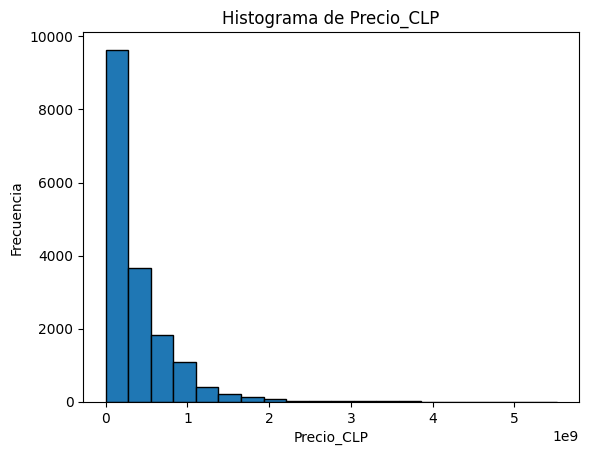

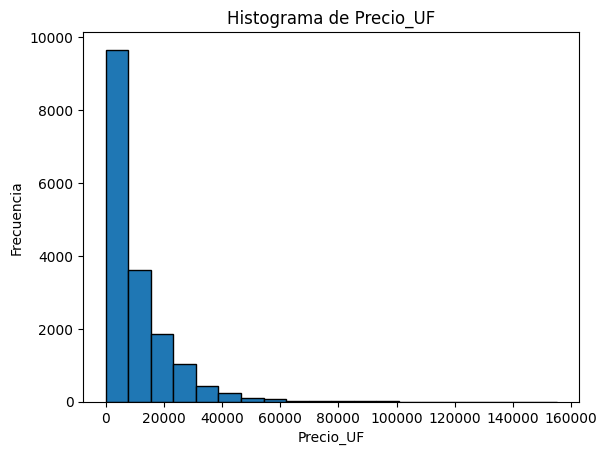

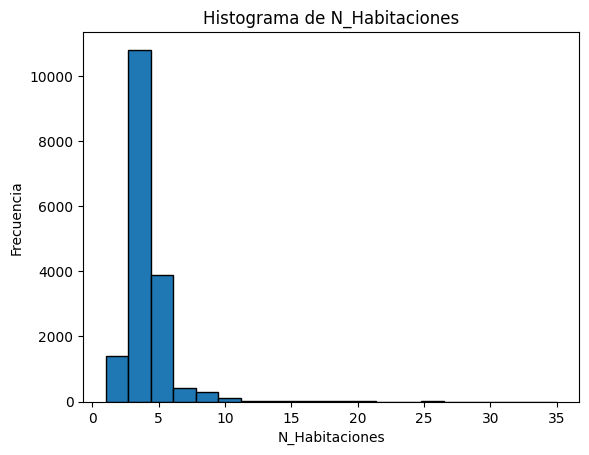

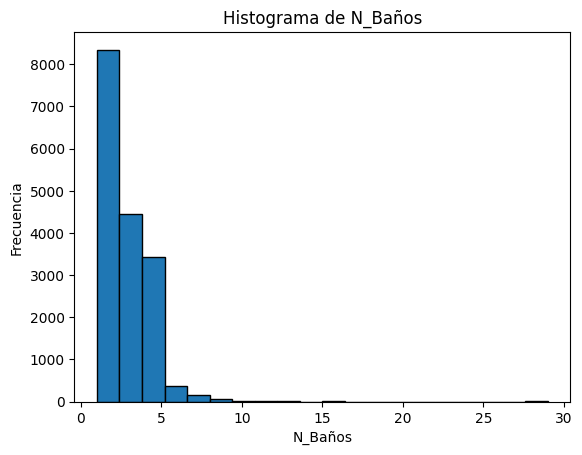

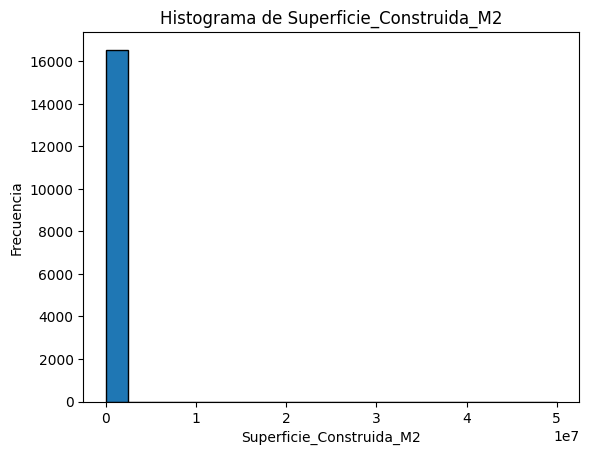

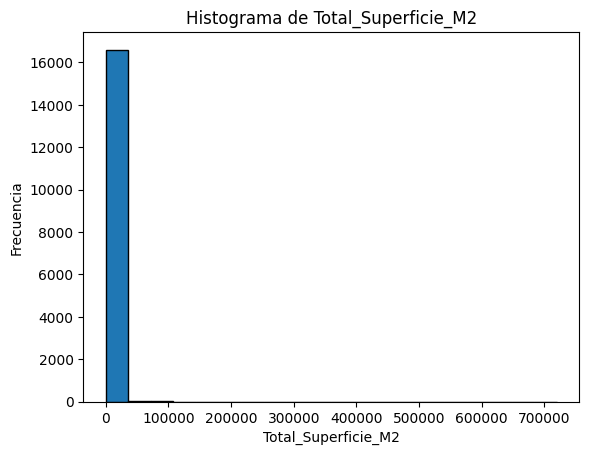

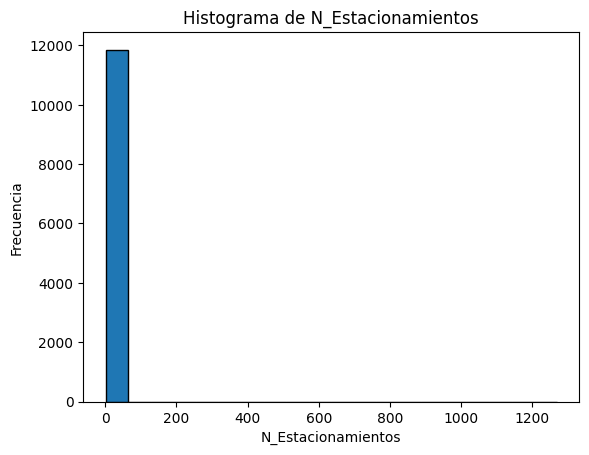

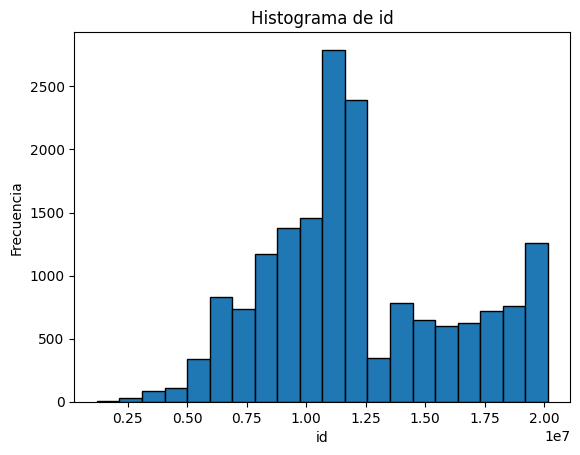

In [ ]:
# Filtrar las columnas numéricas
numeric_columns = data.select_dtypes(include=['int64', 'float64'])

# Iterar a través de las columnas numéricas y crear histogramas
for col in numeric_columns.columns:
    plt.hist(data[col], bins=20, edgecolor='black')
    plt.xlabel(col)
    plt.ylabel('Frecuencia')
    plt.title(f'Histograma de {col}')
    plt.show()

####**1.2. Variables Categóricas**

Proporción de las clases de las variables categóricas:

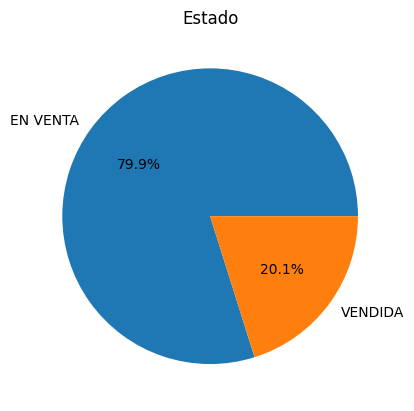

In [ ]:
#Gráfico de torta
frecuencia = df['Estado'].value_counts()
plt.pie(frecuencia, labels=frecuencia.index, autopct='%1.1f%%')
plt.title("Estado")
plt.show()

In [ ]:
print(df.groupby('Estado').size())

Estado
EN VENTA    13631
VENDIDA      3438
dtype: int64


Text(0.5, 1.0, 'Comuna')

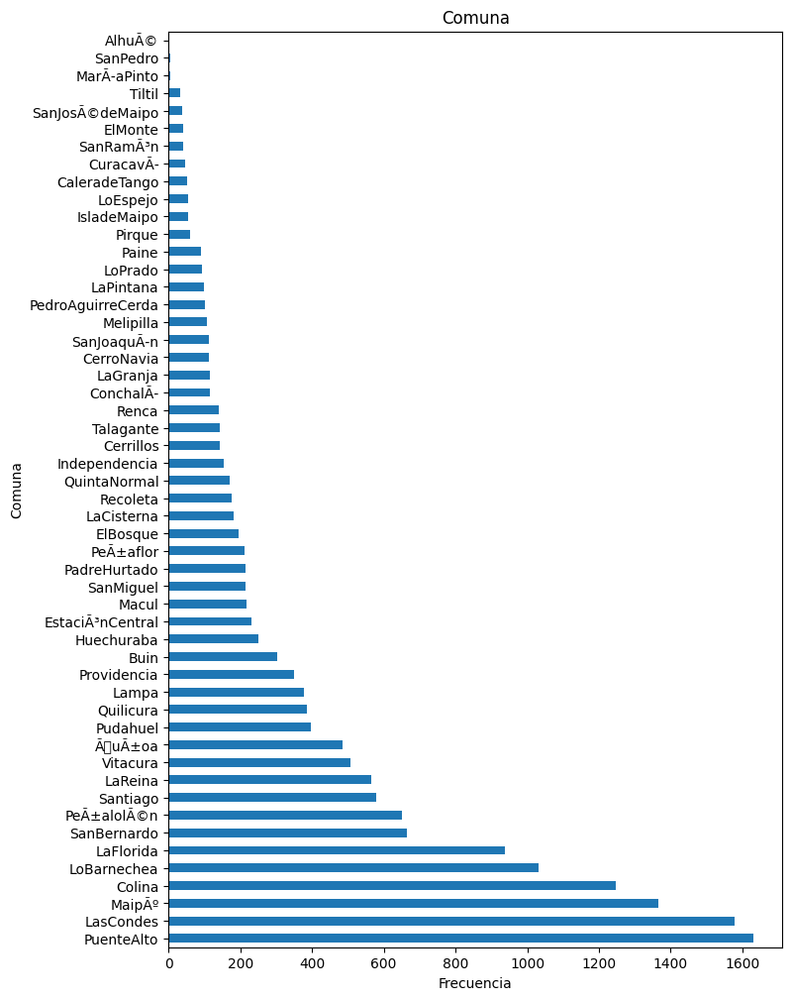

In [ ]:
#Gráfico de barras horizontal
plt.figure(figsize=(8, 12))
df['Comuna'].value_counts(sort=True).plot.barh()
plt.xlabel("Frecuencia")
plt.ylabel("Comuna")
plt.title("Comuna")

In [ ]:
print(df.groupby('Comuna').size())

Comuna
AlhuÃ©                  1
Buin                  303
CaleradeTango          52
Cerrillos             143
CerroNavia            113
Colina               1246
ConchalÃ­             116
CuracavÃ­              46
ElBosque              195
ElMonte                40
EstaciÃ³nCentral      232
Huechuraba            251
Independencia         154
IsladeMaipo            54
LaCisterna            181
LaFlorida             939
LaGranja              114
LaPintana              99
LaReina               565
Lampa                 378
LasCondes            1577
LoBarnechea          1032
LoEspejo               54
LoPrado                94
Macul                 217
MaipÃº               1367
MarÃ­aPinto             5
Melipilla             106
PadreHurtado          214
Paine                  90
PedroAguirreCerda     101
PeÃ±aflor             212
PeÃ±alolÃ©n           650
Pirque                 59
Providencia           350
Pudahuel              398
PuenteAlto           1630
Quilicura             385
Quint

####**1.3. Medidas de Tendencia Central**

In [ ]:
#Media de variables numericas
df.mean()

Precio_CLP                 379645106
Precio_UF                      10586
N_Habitaciones                     4
N_Baños                            3
Superficie_Construida_M2        3423
Total_Superficie_M2              853
N_Estacionamientos                 3
id                          12196415
dtype: float64

In [ ]:
#Mediana de variables numericas
df.median()

Precio_CLP                 220622410
Precio_UF                       6182
N_Habitaciones                     4
N_Baños                            3
Superficie_Construida_M2         130
Total_Superficie_M2              220
N_Estacionamientos                 2
id                          11490752
dtype: float64

In [ ]:
#Moda de todas las variables (incluye variables categoricas)
df.mode().iloc[0]

Precio_CLP                   120000000
Precio_UF                         3326
Comuna                      PuenteAlto
Ubicacion                       MaipÃº
N_Habitaciones                       3
N_Baños                              2
Superficie_Construida_M2           140
Total_Superficie_M2                200
N_Estacionamientos                   2
id                            10215663
Corredora                         Unne
Estado                        EN VENTA
Name: 0, dtype: object

###**1.4. Medidas de Dispersión**

In [ ]:
#Desviación Estandar
df.std()

Precio_CLP                 396343848
Precio_UF                      11049
N_Habitaciones                     2
N_Baños                            1
Superficie_Construida_M2      389303
Total_Superficie_M2            10332
N_Estacionamientos                12
id                           3977914
dtype: float64

In [ ]:
#Varianza
df.var()

Precio_CLP                 157088446110879072
Precio_UF                           122080564
N_Habitaciones                              3
N_Baños                                     2
Superficie_Construida_M2         151556878392
Total_Superficie_M2                 106752100
N_Estacionamientos                        148
id                             15823798821992
dtype: float64

###**1.5. Medidas de Posición no central**

Diagrama de caja y bigotes (boxplot)

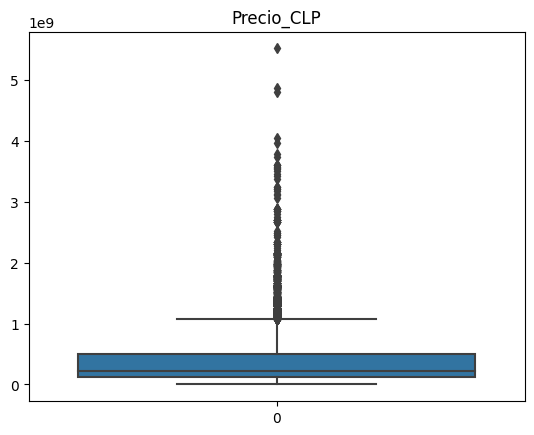

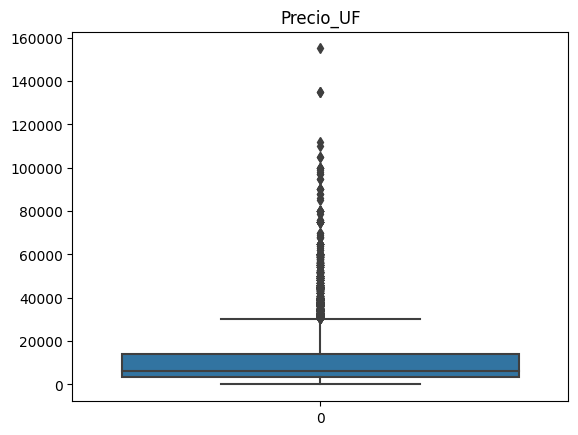

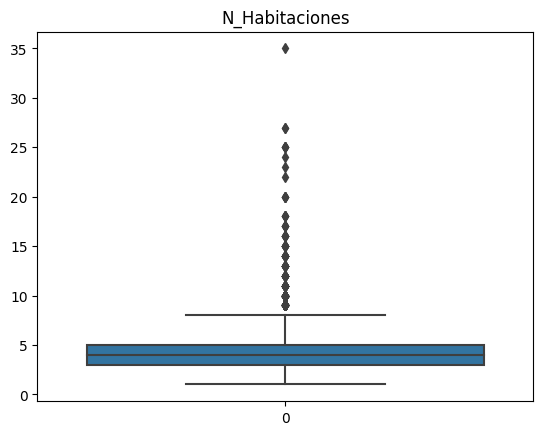

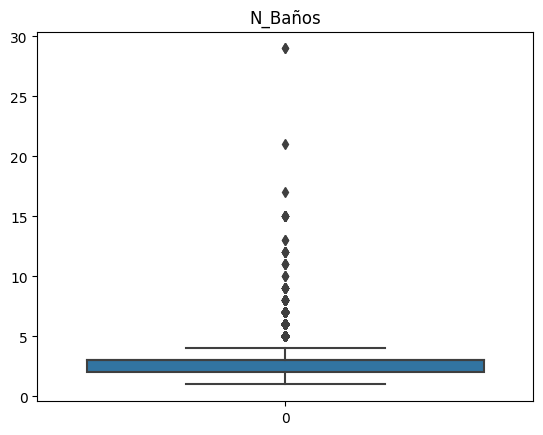

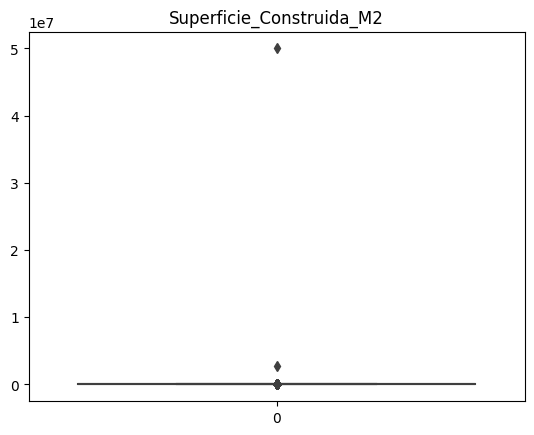

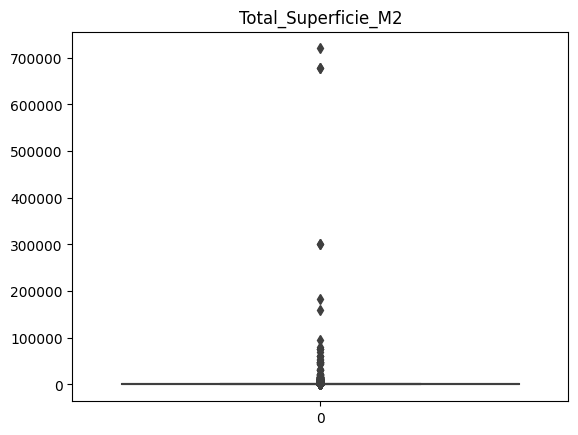

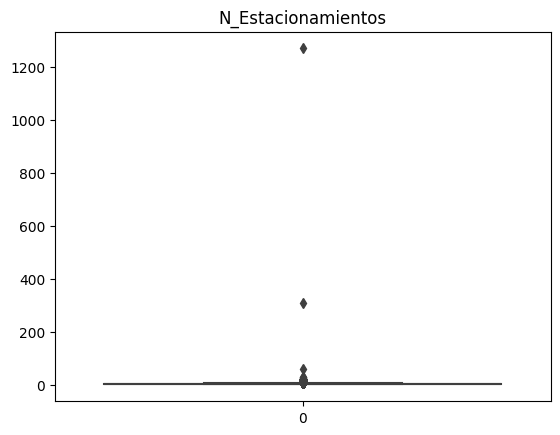

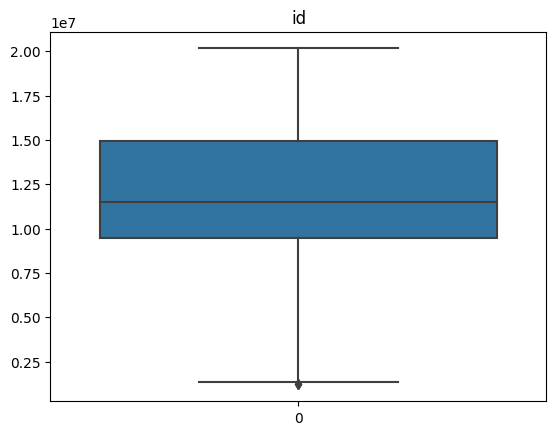

In [ ]:
num_vars = df.select_dtypes(include=['float64', 'int64'])
for col in num_vars.columns:
    plt.figure()
    plt.title(col)
    sb.boxplot(num_vars[col])
    plt.show()

Text(0.5, 1.0, 'Boxplot')

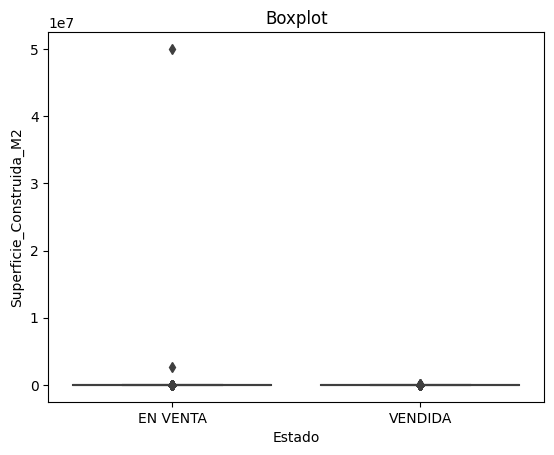

In [ ]:
boxplot(x="Estado", y="Superficie_Construida_M2", data=df)
plt.xlabel("Estado")
plt.ylabel("Superficie_Construida_M2")
plt.title("Boxplot")

Text(0.5, 1.0, 'Boxplot')

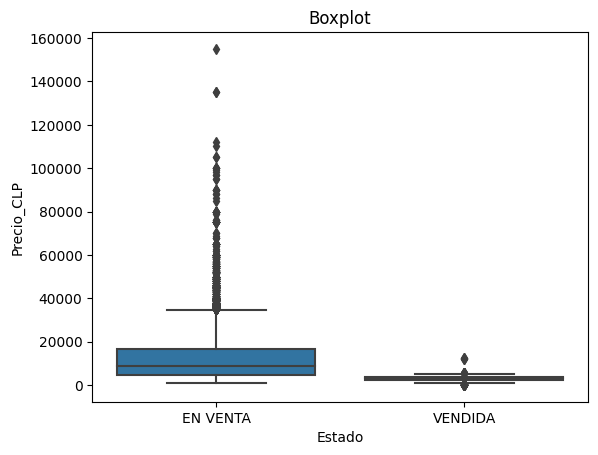

In [ ]:
boxplot(x="Estado", y="Precio_UF", data=df)
plt.xlabel("Estado")
plt.ylabel("Precio_CLP")
plt.title("Boxplot")

Text(0.5, 1.0, 'Boxplot')

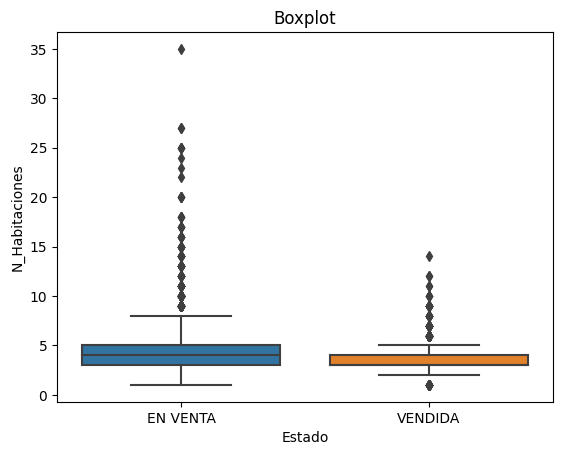

In [ ]:
boxplot(x="Estado", y="N_Habitaciones", data=df)
plt.xlabel("Estado")
plt.ylabel("N_Habitaciones")
plt.title("Boxplot")



---



#**ETAPA III: PREPARACIÓN**

En esta etapa se corrigen los errores de registro encontrados en el dataset.

##**1. Limpieza**


###**1.1. Duplicados**

Se identifican valores duplicados.

In [ ]:
duplicates_count = df.duplicated().sum()
print(f'Cantidad de duplicados: {duplicates_count}')

Cantidad de duplicados: 1


In [ ]:
duplicates = df[df.duplicated()]
duplicates

,Precio_CLP,Precio_UF,Comuna,Ubicacion,N_Habitaciones,N_Baños,Superficie_Construida_M2,Total_Superficie_M2,N_Estacionamientos,id,Corredora,Estado
5538,266925000,7500.00,Tiltil,Sevendecasaconampliaparcelaentiltil,4.00,3.00,250.00,6000.00,1.00,10215663.00,Movahome Corredores Integrados,EN VENTA


Se eliminan valores duplicados.

In [ ]:
df = df.drop_duplicates()

In [ ]:
df.duplicated().sum()

0

###**1.2. Eliminación de variables**

Se eliminan todas las variables que no aporten información al estudio:

In [ ]:
df = df.drop(columns=['id','Corredora','Ubicacion'])

In [ ]:
list(df.columns.values)

['Precio_CLP',
 'Precio_UF',
 'Comuna',
 'N_Habitaciones',
 'N_Baños',
 'Superficie_Construida_M2',
 'Total_Superficie_M2',
 'N_Estacionamientos',
 'Estado']

###**1.3. Errores de registro**

In [ ]:
df['Comuna'].unique()

array(['SanBernardo', 'LaReina', 'Ã\x91uÃ±oa', 'Vitacura', 'LaCisterna',
       'EstaciÃ³nCentral', 'LasCondes', 'ElBosque', 'LoBarnechea',
       'PuenteAlto', 'ConchalÃ\xad', 'Buin', 'SanMiguel', 'Talagante',
       'LaFlorida', 'PeÃ±aflor', 'Colina', 'Providencia', 'Santiago',
       'Quilicura', 'LoEspejo', 'PeÃ±alolÃ©n', 'PedroAguirreCerda',
       'Cerrillos', 'QuintaNormal', 'Tiltil', 'SanJoaquÃ\xadn', 'MaipÃº',
       'PadreHurtado', 'Macul', 'SanJosÃ©deMaipo', 'Huechuraba', 'Lampa',
       'Recoleta', 'Pudahuel', 'CaleradeTango', 'Melipilla', 'LaPintana',
       'LaGranja', 'Independencia', 'Renca', 'CuracavÃ\xad', 'Pirque',
       'LoPrado', 'CerroNavia', 'Paine', 'IsladeMaipo', 'ElMonte',
       'SanRamÃ³n', 'SanPedro', 'MarÃ\xadaPinto', 'AlhuÃ©'], dtype=object)

In [ ]:
df['Comuna'] = df['Comuna'].replace({'Ã\x91uÃ±oa': 'Ñuñoa', 'EstaciÃ³nCentral': 'EstacionCentral',
                                     'ConchalÃ\xad': 'Conchali','PeÃ±aflor':'Peñaflor',
                                     'PeÃ±alolÃ©n':'Peñalolen','SanJoaquÃ\xadn':'San Joaquin',
                                     'MaipÃº':'Maipu','SanJosÃ©deMaipo':'SanJoseDeMaipo',
                                     'CuracavÃ\xad':'Curacavi','SanRamÃ³n':'SanRamon',
                                     'MarÃ\xadaPinto':'MariaPinto','AlhuÃ©':'Alhue'
                                     })

In [ ]:
df['Comuna'].unique()

array(['SanBernardo', 'LaReina', 'Ñuñoa', 'Vitacura', 'LaCisterna',
       'EstacionCentral', 'LasCondes', 'ElBosque', 'LoBarnechea',
       'PuenteAlto', 'Conchali', 'Buin', 'SanMiguel', 'Talagante',
       'LaFlorida', 'Peñaflor', 'Colina', 'Providencia', 'Santiago',
       'Quilicura', 'LoEspejo', 'Peñalolen', 'PedroAguirreCerda',
       'Cerrillos', 'QuintaNormal', 'Tiltil', 'San Joaquin', 'Maipu',
       'PadreHurtado', 'Macul', 'SanJoseDeMaipo', 'Huechuraba', 'Lampa',
       'Recoleta', 'Pudahuel', 'CaleradeTango', 'Melipilla', 'LaPintana',
       'LaGranja', 'Independencia', 'Renca', 'Curacavi', 'Pirque',
       'LoPrado', 'CerroNavia', 'Paine', 'IsladeMaipo', 'ElMonte',
       'SanRamon', 'SanPedro', 'MariaPinto', 'Alhue'], dtype=object)

##**2. Tratamiento de datos nulos (missing)**

▶ Identificacion de datos nulos.

In [ ]:
#Datos nulos
df.isna().sum()

Precio_CLP                     0
Precio_UF                      0
Comuna                         0
N_Habitaciones                90
N_Baños                      219
Superficie_Construida_M2     525
Total_Superficie_M2          443
N_Estacionamientos          5211
Estado                         0
dtype: int64

▶ Eliminación de registros con menor cantidad de nulos:

In [ ]:
df = df.dropna(subset=['N_Habitaciones','N_Baños'])

▶ Imputación de datos faltantes de las variables con mayor cantidad de nulos:

In [ ]:
#Rellenar con ceros
df['N_Estacionamientos'].fillna(0, inplace=True)

In [ ]:
#Imputacion por media
mean_value = df['Superficie_Construida_M2'].mean()
df['Superficie_Construida_M2'] = df['Superficie_Construida_M2'].fillna(mean_value)

➡️ `KNNImputer()`:  K-Nearest Neighbors (KNN) es un algoritmo de aprendizaje automático que realiza predicciones basado en la cercanía de los datos en un espacio de características, es decir, buscando el vecino más cercano. El espacio de características es el espacio matemático en el cual se representan los datos. El valor de k representa el número de vecinos más cercanos (n_neighbors) que se deben tener en cuenta al hacer una predicción.

KNN también se puede utilizar para imputar valores faltantes en un conjunto de datos, por medio de la función `KNNImputer()`. KNN puede encontrar los k vecinos más cercanos de cada punto de datos con valores faltantes y utilizar los valores conocidos de esos vecinos para estimar el valor faltante.

In [ ]:
#Imputacion por KNN
from sklearn.impute import KNNImputer

# Selecciona la columna (queda como serie)
column_for_knn = df['Total_Superficie_M2']

# Reformatea la serie en una matriz 2D
column_for_knn_2d = column_for_knn.values.reshape(-1, 1)

# Inicializa el imputador KNN con el número de vecinos deseado (n_neighbors)
imputer = KNNImputer(n_neighbors=5)  # Puedes ajustar el número de vecinos según tus necesidades

# Ajusta el imputador a tus datos para calcular los valores imputados
column_for_knn_imputed = imputer.fit_transform(column_for_knn_2d)

# Asigna los valores imputados nuevamente a la columna 'Total_Superficie_M2' en el DataFrame original
df['Total_Superficie_M2'] = column_for_knn_imputed

In [ ]:
#Datos nulos
df.isna().sum()

Precio_CLP                  0
Precio_UF                   0
Comuna                      0
N_Habitaciones              0
N_Baños                     0
Superficie_Construida_M2    0
Total_Superficie_M2         0
N_Estacionamientos          0
Estado                      0
dtype: int64

In [ ]:
df.shape

(16813, 9)

##**3. Tratamiento de datos atípicos (outliers)**

Se calcula el rango de datos que se considera normal:

In [ ]:
# Calcular el rango intercuartil
Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)
IQR = Q3 - Q1

# Identificar los valores atípicos (fuera del rango Q1 - 1.5 * IQR hasta Q3 + 1.5 * IQR)
outliers = (df < (Q1 - 1.5 * IQR)) | (df > (Q3 + 1.5 * IQR))

Se calcula el total de valores atípicos:

In [ ]:
# Calcular el recuento de valores atípicos por columna
outlier_columna = ((df < (Q1 - 1.5 * IQR)) | (df > (Q3 + 1.5 * IQR))).sum()

# Mostrar el recuento de valores atípicos por columna
print("Recuento de valores atípicos por variable:")
print(outlier_columna)

# Contar cuántos valores atípicos hay en cada fila
outlier_counts = ((df < (Q1 - 1.5 * IQR)) | (df > (Q3 + 1.5 * IQR))).sum(axis=1)

# Calcular el recuento total de valores atípicos
total_outliers = outlier_counts.sum()

# Mostrar el recuento total de valores
print("Total de valores atípicos:", total_outliers)

Recuento de valores atípicos por variable:
Comuna                         0
Estado                         0
N_Baños                     1692
N_Estacionamientos           481
N_Habitaciones               266
Precio_CLP                   945
Precio_UF                    988
Superficie_Construida_M2     984
Total_Superficie_M2         1640
dtype: int64
Total de valores atípicos: 6996


**Opciones:**

1. Remover los registros con valores fuera del rango Q1 - 1.5 x IQR hasta Q3 + 1.5 x IQR

```
df = df[~((df < (Q1 - 1.5 * IQR)) | (df > (Q3 + 1.5 * IQR))).any(axis=1)].dropna()
```

2. Imputar por mediana

```
for col in df.columns:
    median = df[col].median()
    df[col][outliers[col]] = median
```

3. Imputar utilizando `KNNImputer()`

```
# Filtrar solo las columnas numéricas
numeric_columns = df.select_dtypes(include=['float64', 'int64']).columns
df_numeric = df[numeric_columns]

# Utilizar KNN para imputar valores faltantes en el DataFrame numérico
imputer = KNNImputer(n_neighbors=5)  # Puedes ajustar el número de vecinos según tus necesidades
df_numeric_imputed = imputer.fit_transform(df_numeric)

# Convertir el resultado de vuelta a un DataFrame y asignarlo a las columnas numéricas de df original
df_numeric_imputed = pd.DataFrame(df_numeric_imputed, columns=df_numeric.columns)
df[numeric_columns] = df_numeric_imputed

```

---
⚠️ **NOTA** ⚠️

> Es importante revisar el comportamiento de las variables antes de este paso, ya que en otros casos puede que hayan datos que no sean realmente atípicos pero por su naturaleza queden fuera del rango normal, por lo que no sería necesario realizar ninguna modificación. En otros casos hay que hacer un filtro para eliminar sólo los datos de las variables que correspondan. Por otro lado, cuando hay demasiados datos atípicos (más de un 10-20% de los registros) es mejor imputar los datos en vez de eliminarlos.
---

En este caso son muchos registros con datos atípicos como para seguir eliminando, por lo que se decide imputar los valores atípicos:

In [ ]:
# Filtrar solo las columnas numéricas
numeric_columns = df.select_dtypes(include=['float64', 'int64']).columns

# Calcular el rango intercuartil y los valores atípicos en las columnas numéricas
for col in numeric_columns:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1

    # Identificar los valores atípicos en cada columna numérica (fuera del rango Q1 - 1.5 * IQR hasta Q3 + 1.5 * IQR)
    outliers = (df[col] < (Q1 - 1.5 * IQR)) | (df[col] > (Q3 + 1.5 * IQR))

    # Imputar los valores atípicos con la mediana de la columna correspondiente
    median = df[col].median()
    df.loc[outliers, col] = median

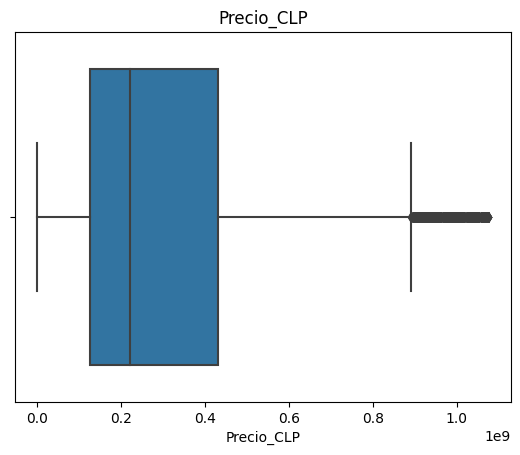

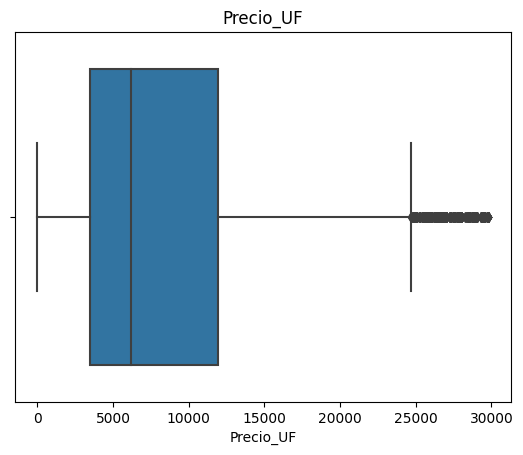

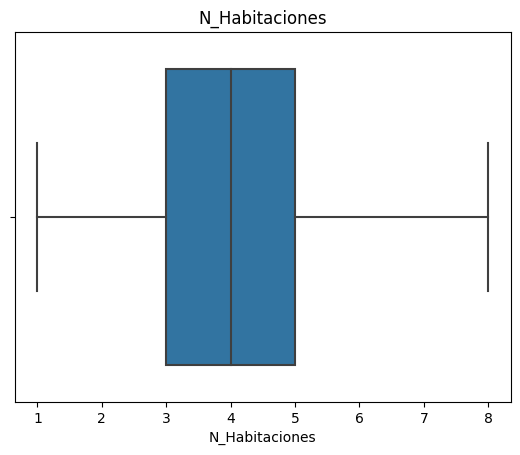

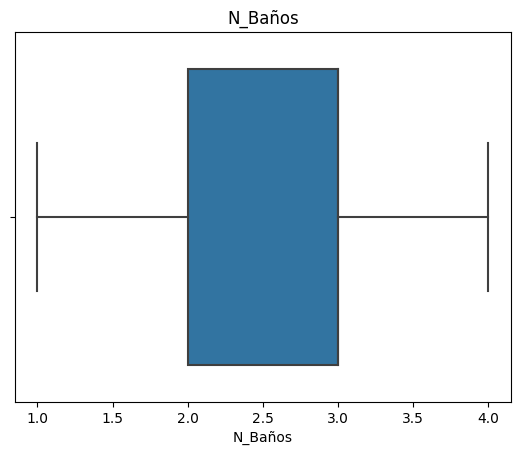

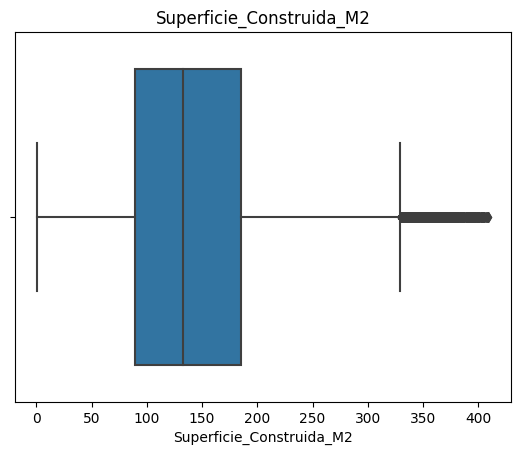

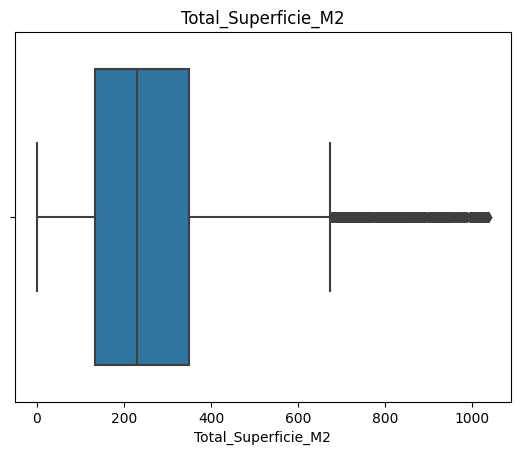

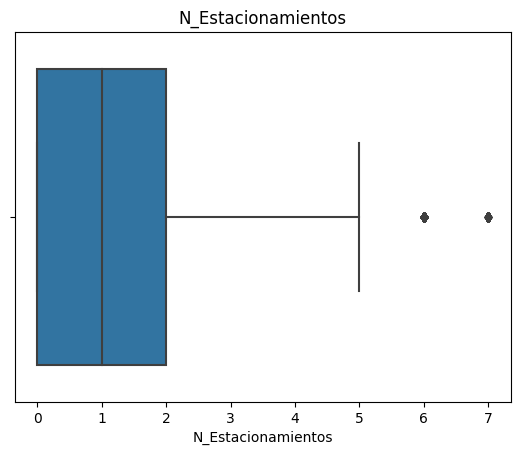

In [ ]:
num_vars = df.select_dtypes(include=['float64', 'int64'])

for col in num_vars.columns:
    plt.figure()
    plt.title(col)
    sb.boxplot(x=num_vars[col])
    plt.show()

Aun se ven valores demasiado altos

In [ ]:
# Calcula y almacena el límite superior para cada columna numérica
upper_limits = {}
outlier_counts = {}  # Diccionario para almacenar el recuento de valores atípicos por columna

for col in df.select_dtypes(include=['float64', 'int64']).columns:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    upper_limit = Q3 + 1.5 * IQR  # Puedes ajustar el factor multiplicativo según tus preferencias
    upper_limits[col] = upper_limit

    # Cuenta cuántas filas están fuera del rango
    outlier_count = len(df[df[col] > upper_limit])
    outlier_counts[col] = outlier_count

# Itera a través del diccionario y muestra el recuento de valores atípicos por columna
for col, count in outlier_counts.items():
    print(f"Columna '{col}': {count} valores atípicos")

# Calcula la cantidad total de registros con valores atípicos
total_outliers = sum(outlier_counts.values())

print("Total valores atípicos:", total_outliers)

Columna 'Precio_CLP': 683 valores atípicos
Columna 'Precio_UF': 678 valores atípicos
Columna 'N_Habitaciones': 0 valores atípicos
Columna 'N_Baños': 0 valores atípicos
Columna 'Superficie_Construida_M2': 1227 valores atípicos
Columna 'Total_Superficie_M2': 1430 valores atípicos
Columna 'N_Estacionamientos': 497 valores atípicos
Total valores atípicos: 4515


**Opciones:**

1. Filtra y elimina los valores mayores a los límites superiores en cada columna numérica.

```
for col, limit in upper_limits.items():
    df = df[df[col] <= limit]
```

2. Imputa los valores mayores a los límites superiores en cada columna numérica con la mediana.

```
for col, limit in upper_limits.items():
    median = df[col].median()
    df[col] = df[col].apply(lambda x: median if x > limit else x)
```

3. Imputa los valores mayores a los límites superiores en cada columna numérica con el límite superior.

```
for col, limit in upper_limits.items():
    df[col] = df[col].apply(lambda x: limit if x > limit else x)
```


En este caso son muchos registros como para seguir eliminando, por lo que se decide imputar los valores atípicos:

In [ ]:
# Imputa los valores mayores a los límites superiores en cada columna numérica con el límite superior
for col, limit in upper_limits.items():
    df[col] = df[col].apply(lambda x: limit if x > limit else x)

In [ ]:
# Calcula y almacena el límite superior para cada columna numérica
upper_limits = {}
outlier_counts = {}  # Diccionario para almacenar el recuento de valores atípicos por columna

for col in df.select_dtypes(include=['float64', 'int64']).columns:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    upper_limit = Q3 + 1.5 * IQR  # Puedes ajustar el factor multiplicativo según tus preferencias
    upper_limits[col] = upper_limit

    # Cuenta cuántas filas están fuera del rango
    outlier_count = len(df[df[col] > upper_limit])
    outlier_counts[col] = outlier_count

# Itera a través del diccionario y muestra el recuento de valores atípicos por columna
for col, count in outlier_counts.items():
    print(f"Columna '{col}': {count} valores atípicos")

# Calcula la cantidad total de registros con valores atípicos
total_outliers = sum(outlier_counts.values())

print("Total valores atípicos:", total_outliers)

Columna 'Precio_CLP': 0 valores atípicos
Columna 'Precio_UF': 0 valores atípicos
Columna 'N_Habitaciones': 0 valores atípicos
Columna 'N_Baños': 0 valores atípicos
Columna 'Superficie_Construida_M2': 0 valores atípicos
Columna 'Total_Superficie_M2': 0 valores atípicos
Columna 'N_Estacionamientos': 0 valores atípicos
Total valores atípicos: 0


##**4. Transformación**

###**4.1. Tipo de datos**

Se tranforman los datos numéricos enteros a integer

In [ ]:
df['N_Habitaciones'] = df['N_Habitaciones'].astype(int)
df['N_Estacionamientos'] = df['N_Estacionamientos'].astype(int)
df['N_Baños'] = df['N_Baños'].astype(int)

In [ ]:
df.dtypes

Precio_CLP                  float64
Precio_UF                   float64
Comuna                       object
N_Habitaciones                int64
N_Baños                       int64
Superficie_Construida_M2    float64
Total_Superficie_M2         float64
N_Estacionamientos            int64
Estado                       object
dtype: object

###**4.2. Encoding**

Transformación de las variables categóricas a numéricas discretas. Se reemplazan las clases de cada variable por un código numérico.

➡️ `replace()`: Para variables con pocas clases (por lo general binarias) o donde sea importante controlar la etiqueta numérica de la clase ya sea porque son ordinales o por alguna razón lógica, se recomienda hacer el reemplazo de forma manual.

In [ ]:
#Valores unicos de la variable
df['Estado'].unique()

array(['EN VENTA', 'VENDIDA'], dtype=object)

In [ ]:
#Reemplazando valores binarios
df['Estado'].replace({
    "EN VENTA":0,"VENDIDA":1
    }, inplace=True)

➡️ `Label Encoding`: Creación de etiquetas numéricas dentro de la misma columna. Sólo sirve para variables categóricas nominales ya que las etiquetas perderían el orden para variables categoricas ordinales. Se recomienda para variables con muchas clases.

In [ ]:
from sklearn.preprocessing import LabelEncoder
#Selecciona las columnas categóricas que se van a codificar
categorical_cols = ['Comuna']

#Itera sobre las columnas categóricas y aplica LabelEncoder
label_encoders = {}
for col in categorical_cols:
    le = LabelEncoder()
    df[col] = le.fit_transform(df[col])
    label_encoders[col] = le

#Muestra los valores originales y los valores codificados
for col in categorical_cols:
    original_values = df[col]
    encoded_values = df[col]
    le = label_encoders[col]

    unique_values = original_values.unique()
    unique_encoded_values = le.inverse_transform(unique_values)

    mapping = dict(zip(unique_values, unique_encoded_values))
    print(f"Columna: {col}")
    print("Valor Codificado - Clase")
    for value, encoded_value in mapping.items():
        print(f"{value} - {encoded_value}")
    print("------------------------")

Columna: Comuna
Valor Codificado - Clase
42 - SanBernardo
18 - LaReina
51 - Ñuñoa
50 - Vitacura
14 - LaCisterna
10 - EstacionCentral
20 - LasCondes
8 - ElBosque
21 - LoBarnechea
36 - PuenteAlto
6 - Conchali
1 - Buin
44 - SanMiguel
15 - LaFlorida
31 - Peñaflor
5 - Colina
34 - Providencia
47 - Santiago
37 - Quilicura
22 - LoEspejo
32 - Peñalolen
30 - PedroAguirreCerda
3 - Cerrillos
38 - QuintaNormal
49 - Tiltil
25 - Maipu
28 - PadreHurtado
24 - Macul
43 - SanJoseDeMaipo
11 - Huechuraba
19 - Lampa
39 - Recoleta
35 - Pudahuel
2 - CaleradeTango
27 - Melipilla
17 - LaPintana
16 - LaGranja
12 - Independencia
41 - San Joaquin
40 - Renca
7 - Curacavi
33 - Pirque
23 - LoPrado
4 - CerroNavia
29 - Paine
48 - Talagante
13 - IsladeMaipo
9 - ElMonte
46 - SanRamon
45 - SanPedro
26 - MariaPinto
0 - Alhue
------------------------




---



##**5. Análisis Estadístico**

Se visualiza el Dataframe resultante del proceso de limpieza y transformación, corroborando la corrección de los errores previamente identificados:

In [ ]:
print(df.shape)

(16813, 9)


In [ ]:
#Unificación del formato de las variables decimales
pd.options.display.float_format = '{:.2f}'.format

In [ ]:
df.sample(10)

,Precio_CLP,Precio_UF,Comuna,N_Habitaciones,N_Baños,Superficie_Construida_M2,Total_Superficie_M2,N_Estacionamientos,Estado
4696,103211000.00,2900.00,10,2,1,88.00,57.00,0,1
11639,378829500.00,10500.00,48,4,4,218.00,229.00,0,0
2372,163113159.00,4521.00,25,4,2,110.00,170.00,3,0
11686,92362240.00,2560.00,35,2,1,45.00,62.00,2,1
15963,220000000.00,6180.00,20,4,4,133.00,488.00,1,0
8165,57726400.00,1600.00,42,3,1,43.00,43.00,1,1
573,130000000.00,3603.00,42,4,3,110.00,120.00,1,1
5348,67000000.00,1883.00,42,4,1,329.00,675.50,0,1
7937,115000000.00,3231.00,25,3,1,50.00,116.00,2,1
9327,50000000.00,1405.00,8,5,2,329.00,675.50,0,0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 16813 entries, 0 to 17067
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Precio_CLP                16813 non-null  float64
 1   Precio_UF                 16813 non-null  float64
 2   Comuna                    16813 non-null  int64  
 3   N_Habitaciones            16813 non-null  int64  
 4   N_Baños                   16813 non-null  int64  
 5   Superficie_Construida_M2  16813 non-null  float64
 6   Total_Superficie_M2       16813 non-null  float64
 7   N_Estacionamientos        16813 non-null  int64  
 8   Estado                    16813 non-null  int64  
dtypes: float64(4), int64(5)
memory usage: 1.3 MB


Nuevo resumen estadístico con datos corregidos:

▶ Medidas de Tendencia Central:

In [ ]:
df.mean()

Precio_CLP                 300151659.67
Precio_UF                       8318.20
Comuna                            26.02
N_Habitaciones                     3.89
N_Baños                            2.43
Superficie_Construida_M2         148.38
Total_Superficie_M2              269.54
N_Estacionamientos                 1.56
Estado                             0.20
dtype: float64

In [ ]:
df.median()

Precio_CLP                 220000000.00
Precio_UF                       6180.00
Comuna                            25.00
N_Habitaciones                     4.00
N_Baños                            3.00
Superficie_Construida_M2         133.00
Total_Superficie_M2              229.00
N_Estacionamientos                 1.00
Estado                             0.00
dtype: float64

In [ ]:
#Moda de todas las variables (incluye variables categoricas)
df.mode().iloc[0]

Precio_CLP                 220000000.00
Precio_UF                       6180.00
Comuna                            36.00
N_Habitaciones                     3.00
N_Baños                            3.00
Superficie_Construida_M2         329.00
Total_Superficie_M2              229.00
N_Estacionamientos                 0.00
Estado                             0.00
Name: 0, dtype: float64

▶ Medidas de Dispersión:

In [ ]:
#Desviación Estandar
df.std()

Precio_CLP                 236148750.22
Precio_UF                       6513.82
Comuna                            13.47
N_Habitaciones                     1.24
N_Baños                            0.97
Superficie_Construida_M2          79.79
Total_Superficie_M2              180.75
N_Estacionamientos                 1.45
Estado                             0.40
dtype: float64

In [ ]:
#Varianza
df.var()

Precio_CLP                 55766232230393792.00
Precio_UF                           42429787.72
Comuna                                   181.44
N_Habitaciones                             1.54
N_Baños                                    0.94
Superficie_Construida_M2                6365.67
Total_Superficie_M2                    32671.33
N_Estacionamientos                         2.09
Estado                                     0.16
dtype: float64

▶ Medidas de Posicion no central:

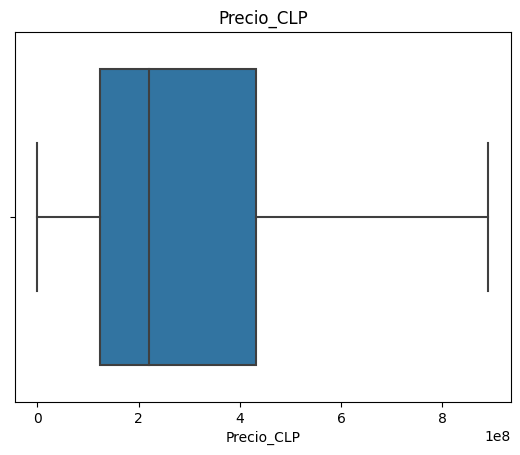

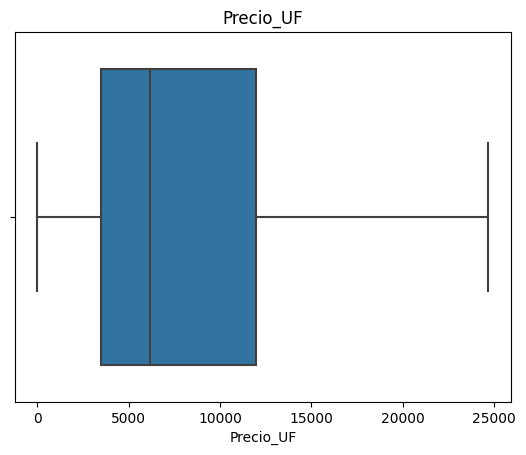

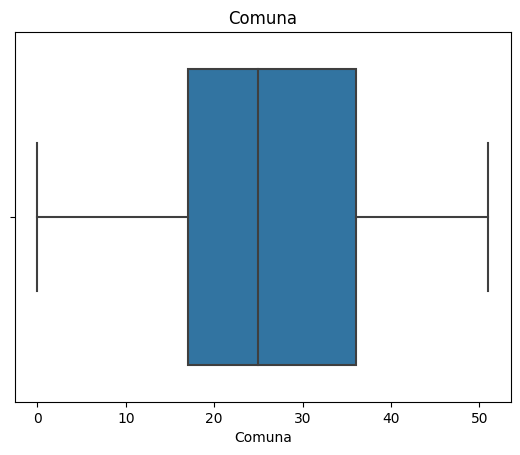

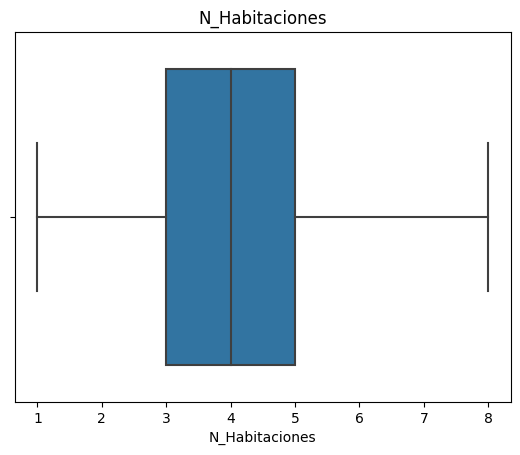

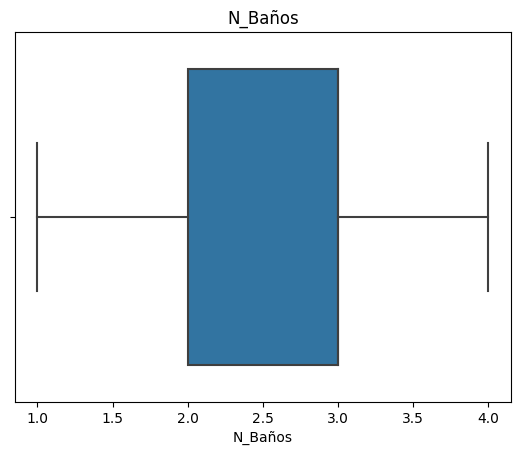

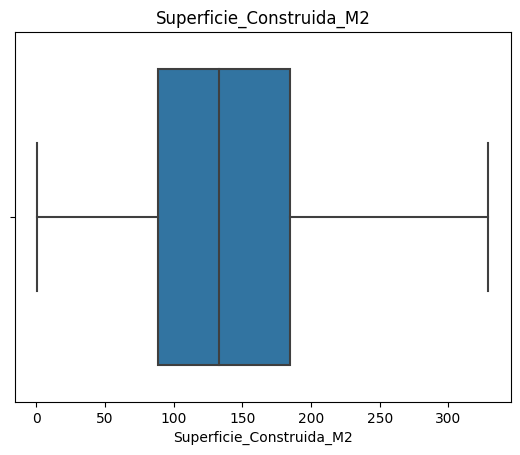

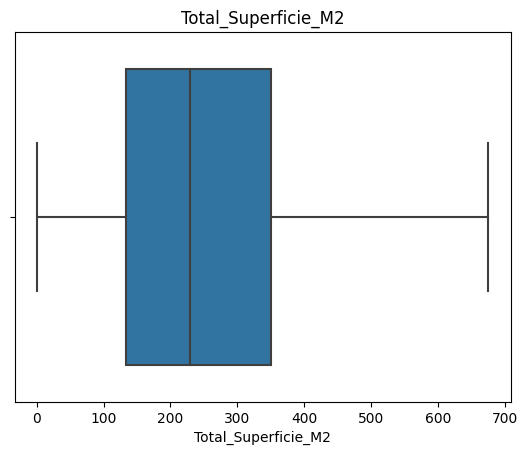

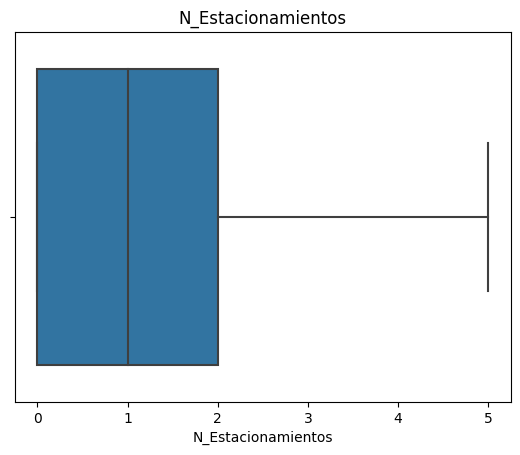

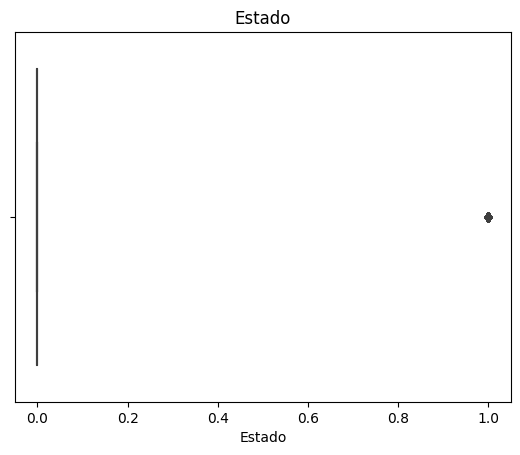

In [ ]:
num_vars = df.select_dtypes(include=['float64', 'int64'])

for col in num_vars.columns:
    plt.figure()
    plt.title(col)
    sb.boxplot(x=num_vars[col])
    plt.show()

▶ Correlación

La correlación indica cuán asociadas se encuentran dos variables entre sí. Esta medida tiene un rango entre 1 y -1, donde:

1 = las variables se relacionan de forma directa.

0 = las variables no se relacionan.

-1 = las variables se relacionan inversamente.

Entre más cercano a cero sea la correlación, más débil es la relación entre las variables, en cambio entre más cercano a 1 (sea positivo o negativo), más fuerte es la relación.

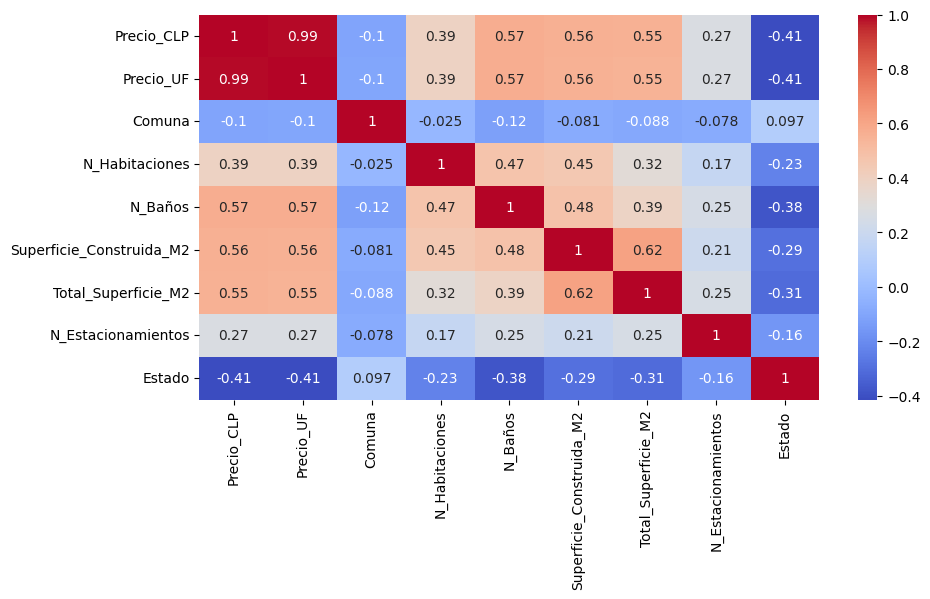

In [ ]:
corr = df.corr()
plt.figure(figsize=(10,5))
sb.heatmap(corr, cmap="coolwarm",annot=True)
plt.show()

Las variable 'Precio_UF' y 'Precio_CLP' están demasiado correlacionadas debido a que una es cálculo de la otra, por lo tanto se debe elegir solo una para hacer predicciones. En este caso se elige Precio_UF.

In [ ]:
#Correlacion de todas las variables con precio
corr_matrix = df.corr()
corr_matrix["Precio_UF"].sort_values(ascending=False)

Precio_UF                   1.00
Precio_CLP                  0.99
N_Baños                     0.57
Superficie_Construida_M2    0.56
Total_Superficie_M2         0.55
N_Habitaciones              0.39
N_Estacionamientos          0.27
Comuna                     -0.10
Estado                     -0.41
Name: Precio_UF, dtype: float64

Text(0.5, 0, 'Total_Superficie_M2')

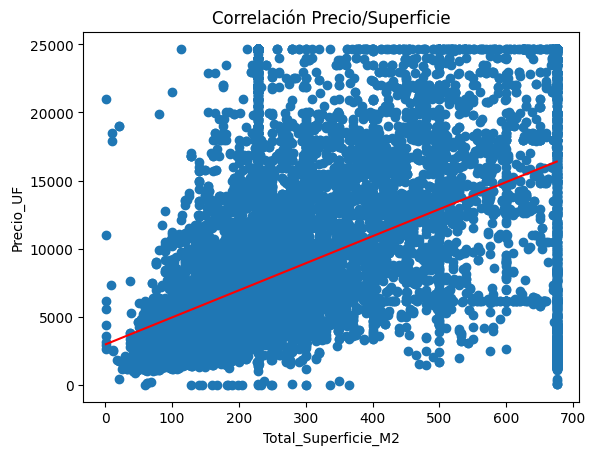

In [ ]:
#Correlacion
y = df['Precio_UF']
x = df['Total_Superficie_M2']
correlation = y.corr(x)

#Diagrama de dispersion
plt.title('Correlación Precio/Superficie')
plt.scatter(x, y)

plt.plot(np.unique(x),
         np.poly1d(np.polyfit(x, y, 1))
         (np.unique(x)), color='red')

plt.ylabel("Precio_UF")
plt.xlabel("Total_Superficie_M2")

Se guarda el dataframe resultante del proceso de Preprocesamiento.

In [ ]:
# Exportar los resultados a un archivo Excel
df.to_excel('Guia_Machine_Learning_Preprocesado.xlsx', index=False)
# index=False para no incluir el índice en el archivo

#**ETAPA IV: MODELADO**

Se utilizarán algoritmos supervisados para realizar tareas de Regresión y Clasificación.

##**1. Modelos de Regresión**

Se busca predecir una variable objetivo (target) correspondiente a una variable dependiente (Y) de tipo numérica.

In [ ]:
#Librerías de Python

import numpy as np #Programación vectorial
import pandas as pd #Estructura y manipulación de datos
import matplotlib.pyplot as plt #Visualización

import seaborn as sb #Gráficos

import warnings #Advertencias
warnings.filterwarnings('ignore')

In [ ]:
# Importación del dataset preprocesado
df = pd.read_excel("Guia_ML_Preprocesado.xlsx")

###**1. Regresión Lineal**

➡️ `LinearRegression()`:  Es un algoritmo de aprendizaje automático que se utiliza para crear modelos de regresión lineal. La regresión lineal es un método estadístico que se utiliza para modelar la relación lineal entre una variable dependiente y una o más variables independientes. El objetivo es encontrar la mejor línea recta (en el caso de la regresión lineal simple) o un hiperplano (en el caso de la regresión lineal múltiple) que minimice la suma de los cuadrados de las diferencias entre los valores observados y los valores predichos por el modelo.

Parámetros (sci-kit learn):

> ●   `fit_intercept`:  Un valor booleano que indica si se debe ajustar el término de intercepción en el modelo (es decir, la ordenada al origen). Si se establece en True el modelo incluirá un término de intercepción en el ajuste. Si se establece en False, el modelo no incluirá una intercepción. Por defecto, está en True.

####**Modelo 1**

✅ Paso 1 - Definición de variables: Definimos la variable objetivo $Y$ y las variables predictoras $X$.

In [ ]:
#Variable dependiente
Y = pd.DataFrame(df['Precio_UF'])
Y.head()

,Precio_UF
0,6180.0
1,6180.0
2,16000.0
3,9590.0
4,24677.5


In [ ]:
#Variables independientes
X = df.drop(columns=['Precio_UF','Precio_CLP'])
X.head()

,Comuna,N_Habitaciones,N_Baños,Superficie_Construida_M2,Total_Superficie_M2,N_Estacionamientos,Estado
0,42,3,2,200,229.0,0,0
1,42,3,2,200,229.0,0,0
2,18,4,3,180,600.0,1,0
3,51,7,3,300,576.0,3,0
4,50,6,3,238,390.0,2,0


✅ Paso 2 - Modelo: Creación del modelo de Regresión Lineal

In [ ]:
from sklearn.linear_model import LinearRegression

In [ ]:
modelo_1 = LinearRegression()

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con $X$ e $Y$.

In [ ]:
modelo_1.fit(X, Y)

LinearRegression()

✅ Paso 4 - Predicción: Estimación de la variable $Y$ usando como entrada la variable $X$. Como resultado obtenemos $\hat Y$ (Y_hat).

En este caso, como el modelo fue entrenado con todos los datos, se realiza una predicción con datos dentro de la muestra (in-sample)

➡️ `in-sample`: Predicción con datos utilizados durante el entrenamiento del modelo. Esto se hace sólo para experimentar y comparar entre modelos, ya que en la práctica no sirve para generalizar nuevos valores estimados de $Y$, ya que tiende a subajustarse (underfitting) o sobreajustarse (overfitting).

In [ ]:
#Ŷ (Y gorro) = Y_hat
Y_hat = modelo_1.predict(X)

In [ ]:
#Se comparan los valores originales (observacion) de la variable objetivo Y con la
#la prediccion realizada por el modelo (estimacion de Y)
Y = Y.rename(columns={'Precio_UF': 'Observación (Y)'})
Y_hat = pd.DataFrame(Y_hat, columns = ['Estimación (Ŷ)'])
Comparacion = pd.merge(Y, Y_hat, left_index=True, right_index=True)
Comparacion["Diferencia"] = Comparacion["Observación (Y)"]-Comparacion["Estimación (Ŷ)"]
Comparacion.head(10)

,Observación (Y),Estimación (Ŷ),Diferencia
0,6180.00,7674.62,-1494.62
1,6180.00,7674.62,-1494.62
2,16000.00,13230.67,2769.33
3,9590.00,15899.30,-6309.30
4,24677.50,12808.16,11869.34
5,24677.50,12808.16,11869.34
6,4989.00,6966.21,-1977.21
7,5058.00,6966.21,-1908.21
8,21000.00,15019.00,5981.00
9,18966.00,9608.07,9357.93


✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

➡️ Métricas de error: Indican la diferencia entre el valor observado de la variable objetivo $Y$, y el valor estimado de ésta, $\hat Y$.



> ●   `Error Absoluto Medio (MAE)`: Es la medida del promedio de la diferencia absoluta entre el valor real de $Y$ y su valor estimado, $\hat Y$. Al usar valores absolutos evita la cancelación de errores negativos con positivos. Permite interpretar los resultados en las mismas unidades que la variable $Y$.

> ●   `Error Cuadrático Medio (MSE)`: Mide el cuadrado de la diferencia absoluta entre el valor real de $Y$ y su valor estimado,$\hat Y$, lo cual penaliza los errores mayores. Esta medida es muy susceptible a datos atípicos (outliers), ya que entre mayores sean estos, más grande se hará la medida del error.

> ●   `Raíz del Error Cuadrático Medio (RMSE)`: Es la raíz de la media de los errores elevados al cuadrado. Permite interpretar los resultados en las mismas unidades que la variable $Y$. Es la métrica más utilizada.

➡️ Métricas de desempeño: Miden el grado de precisión con el cual el modelo hace las estimaciones, $\hat Y$.

> `Coeficiente de determinación (r2)`: Examina cómo las diferencias en una variable $Y$ pueden ser explicadas por la diferencia en otra variable $X$. Evalúa la fuerza de la relación lineal entre dos variables. Esta relación, conocida como "bondad de ajuste", se representa como un valor entre 0 y 1. Entre más cercano a 1, mejor es el ajuste del modelo. Un valor de 1 indica un ajuste perfecto y, por tanto, un modelo muy fiable para predicciones futuras, mientras que un valor de 0 indicaría que el modelo no tienen ninguna precisión.

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from statsmodels.tools.eval_measures import rmse

In [ ]:
MAE_1 = mean_absolute_error(Y, Y_hat)
MSE_1 =  mean_squared_error(Y, Y_hat)
RMSE_1 = rmse(Y, Y_hat)
r2_1 = r2_score(Y, Y_hat)

print("MAE: %.2f" % MAE_1 )
print("MSE: %.2f" % MSE_1)
print("RMSE: %.2f" % RMSE_1)
print('r2: %.2f' % r2_1)

MAE: 3384.81
MSE: 21050217.74
RMSE: 4588.05
r2: 0.50


El modelo de Regresión Lineal presenta un grado de error bastante elevado y un grado de ajuste deficiente (sólo 50%). Al ser el RMSE más alto que MAE, se evidencia la presencia de errores altos que fueron penalizados por la métrica MSE.

####**Modelo 2**

✅ Paso 1 - Definición de variables: Definimos la variable objetivo $Y$ y las variables predictoras $X$.

➡️ `Split`: Se realiza una separación (split) del set de datos en *conjunto de entrenamiento* y *conjunto de prueba*. Con esta partición el set de datos quedará dividido en 4 secciones: *Xtrain, Xtest, Ytrain, Ytest*.

> *   Conjunto de Entrenamiento (train): Porción de los datos que se utilizará para el entrenamiento del modelo. La sección de la variable $X$ de este conjunto queda almacenada en Xtrain y la variable $Y$ en Ytrain.
> *   Conjunto de Prueba/Validación (test): Porción de los datos que se utilizará en el modelo para realizar predicciones y validar los resultados. La sección de la variable $X$ de este conjunto queda almacenada en Xtest y la variable $Y$ en Ytest.

Realizar esta división del set de datos ayuda a corregir errores de sobreajuste (overfitting) y subajuste (underfitting) que pueda tener el modelo.

Parámetros (sci-kit learn):

> ●   `arrays`: Conjuntos de datos a dividir. Puedes proporcionar uno o varios arrays, dependiendo de cuántos conjuntos de datos se quieran dividir. Por lo general, se proporcionan los datos de características (X) y las etiquetas o valores objetivo (Y) como arrays separados.

> ●   `test_size/train_size`: Permiten especificar el tamaño del conjunto de prueba (test) o del conjunto de entrenamiento (train), respectivamente. Uno de ellos debe estar presente, y el otro se calculará automáticamente. Se pueden especificar como un número decimal que representa la proporción del conjunto de datos total o como un número entero que representa el número absoluto de muestras en el conjunto de prueba o entrenamiento.

> ●   `shuffle`: Indica si se deben barajar (mezclar) los datos antes de la división. Por defecto, está configurado en True, lo que significa que los datos se barajan antes de la división. Si se configura en False, los datos se dividirán en el mismo orden en que se encuentran en los arrays de entrada (no recomendado).

> ●   `stratify`: Se utiliza cuando se realiza una división estratificada, lo que significa que la división se realiza de manera que las proporciones de clases en el conjunto de entrenamiento y prueba sean similares a las proporciones en el conjunto de datos original. Se debe proporcionar un array con etiquetas de clase para utilizar este parámetro.

> ●   `random_state`: Semilla aleatoria para garantizar la reproducibilidad de los resultados.

In [ ]:
from sklearn.model_selection import train_test_split

La proporción en que se divide el set de datos se define en el argumento `test_size`, donde se indica el tamaño del conjunto de prueba.

In [ ]:
#Se define una proporcion 80/20, es decir un tamaño del conjunto de prueba de 0.2 (20%)
Xtrain, Xtest, Ytrain, Ytest = train_test_split(X,Y,test_size=0.2, random_state=123)

In [ ]:
#Conjunto de entrenamiento
print(Xtrain.shape)
print(Ytrain.shape)

(13450, 7)
(13450, 1)


In [ ]:
#Conjunto de prueba
print(Xtest.shape)
print(Ytest.shape)

(3363, 7)
(3363, 1)


✅ Paso 2 - Modelo: Creación del modelo de Regresión Lineal.

In [ ]:
modelo_2 = LinearRegression()

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_2.fit(Xtrain, Ytrain)

LinearRegression()

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

Se pone a prueba el modelo realizando una predicción con datos fuera de la muestra (out-of-sample).

➡️ `out-of-sample`: Predicción con datos que no han sido utilizados durante el entrenamiento del modelo. Esto se hace para evaluar cómo se desempeña el modelo con datos desconocidos, como lo son los datos del conjunto de prueba (Xtest), los cuales utilizamos para validar el modelo.

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_2.predict(Xtest)

In [ ]:
Ytest = Ytest.rename(columns={'Precio_UF': 'Observación (Y)'})
Y_hat = pd.DataFrame(Y_hat, columns = ['Estimación (Ŷ)'])
Comparacion = pd.merge(Ytest, Y_hat, left_index=True, right_index=True)
Comparacion["Diferencia"] = Comparacion["Observación (Y)"]-Comparacion["Estimación (Ŷ)"]
Comparacion.head(10)

,Observación (Y),Estimación (Ŷ),Diferencia
3137,1710.00,2927.72,-1217.72
1913,5600.00,11508.57,-5908.57
1205,1386.00,13909.24,-12523.24
1717,14800.00,208.43,14591.57
2419,9000.00,2699.86,6300.14
2481,2220.00,3169.60,-949.60
3223,3934.00,9064.57,-5130.57
2265,1663.00,9081.94,-7418.94
229,5001.00,7765.75,-2764.75
2820,13000.00,18140.64,-5140.64


✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_2 = mean_absolute_error(Ytest, Y_hat)
MSE_2 =  mean_squared_error(Ytest, Y_hat)
RMSE_2 = rmse(Ytest, Y_hat)
r2_2 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_2)
print("MSE: %.2f" % MSE_2)
print("RMSE: %.2f" % RMSE_2)
print('r2: %.2f' % r2_2)

MAE: 3347.52
MSE: 20699477.64
RMSE: 4549.67
r2: 0.51


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 3**

✅ Paso 1 - Definición de variables: Definimos la variable objetivo $Y$ y las variables predictoras $X$.

Dejamos la variable $Y$ del dataframe original, pero normalizamos las variables $X$.

➡️ `Normalización`: Se transforman los datos de las variables independientes para que sigan una distribución *normal estándar*. La normalización hace que los rangos de valores que puede tomar una serie de datos de una variable sea similar, para que no exista una variable que tenga mayor influencia que otra.

In [ ]:
from sklearn.preprocessing import StandardScaler

In [ ]:
scaler = StandardScaler()

scaler.fit(Xtrain)
Xtrain_sc= scaler.transform(Xtrain)

scaler.fit(Xtest)
Xtest_sc= scaler.transform(Xtest)

✅ Paso 2 - Modelo: Creación del modelo de Regresión Lineal

In [ ]:
modelo_3 = LinearRegression()

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con $X$ e $Y$.

In [ ]:
modelo_3.fit(Xtrain_sc, Ytrain)

LinearRegression()

✅ Paso 4 - Predicción: Estimación de la variable $Y$ usando como entrada la variable $X$. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_3.predict(Xtest_sc)

In [ ]:
Ytest = Ytest.rename(columns={'Precio_UF': 'Observación (Y)'})
Y_hat = pd.DataFrame(Y_hat, columns = ['Estimación (Ŷ)'])
Comparacion = pd.merge(Ytest, Y_hat, left_index=True, right_index=True)
Comparacion["Diferencia"] = Comparacion["Observación (Y)"]-Comparacion["Estimación (Ŷ)"]
Comparacion.head(10)

,Observación (Y),Estimación (Ŷ),Diferencia
3137,1710.00,2937.92,-1227.92
1913,5600.00,11553.66,-5953.66
1205,1386.00,13992.49,-12606.49
1717,14800.00,269.67,14530.33
2419,9000.00,2723.57,6276.43
2481,2220.00,3190.48,-970.48
3223,3934.00,9120.36,-5186.36
2265,1663.00,9137.76,-7474.76
229,5001.00,7794.31,-2793.31
2820,13000.00,18185.81,-5185.81


✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_3 = mean_absolute_error(Ytest, Y_hat)
MSE_3 =  mean_squared_error(Ytest, Y_hat)
RMSE_3 = rmse(Ytest, Y_hat)
r2_3 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_3)
print("MSE: %.2f" % MSE_3)
print("RMSE: %.2f" % RMSE_3)
print('r2: %.2f' % r2_3)

MAE: 3352.17
MSE: 20700594.37
RMSE: 4549.79
r2: 0.51


En este caso, se obtuvieron los mismo resultados que e el modelo anterior, por lo que la normalización no tuvo efecto. Esto significa que las diferentes escalas de las variables no afectan las predicciones.

####**Modelo 4**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo de Regresión Lineal.

In [ ]:
modelo_4 = LinearRegression(fit_intercept=False)

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_4.fit(Xtrain, Ytrain)

LinearRegression(fit_intercept=False)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

Se pone a prueba el modelo realizando una predicción con datos fuera de la muestra (out-of-sample).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_4.predict(Xtest)

In [ ]:
Ytest = Ytest.rename(columns={'Precio_UF': 'Observación (Y)'})
Y_hat = pd.DataFrame(Y_hat, columns = ['Estimación (Ŷ)'])
Comparacion = pd.merge(Ytest, Y_hat, left_index=True, right_index=True)
Comparacion["Diferencia"] = Comparacion["Observación (Y)"]-Comparacion["Estimación (Ŷ)"]
Comparacion.head(10)

,Observación (Y),Estimación (Ŷ),Diferencia
3137,1710.00,3751.92,-2041.92
1913,5600.00,11515.63,-5915.63
1205,1386.00,12431.82,-11045.82
1717,14800.00,481.92,14318.08
2419,9000.00,3533.49,5466.51
2481,2220.00,3970.45,-1750.45
3223,3934.00,9019.10,-5085.10
2265,1663.00,9110.97,-7447.97
229,5001.00,8167.63,-3166.63
2820,13000.00,17415.40,-4415.40


✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_4 = mean_absolute_error(Ytest, Y_hat)
MSE_4 =  mean_squared_error(Ytest, Y_hat)
RMSE_4 = rmse(Ytest, Y_hat)
r2_4 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_4)
print("MSE: %.2f" % MSE_4)
print("RMSE: %.2f" % RMSE_4)
print('r2: %.2f' % r2_4)

MAE: 3394.16
MSE: 20797898.42
RMSE: 4560.47
r2: 0.51


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

➡️ `validación cruzada`: Técnica para evaluar el rendimiento de un modelo y estimar cómo se comportaría en datos no vistos. La validación cruzada implica dividir los datos en varios subconjuntos, entrenar y evaluar el modelo en múltiples iteraciones para obtener una estimación más robusta del rendimiento.

➡️ `K-Folds`: Es una estrategia específica de validación cruzada en la que los datos de entrenamiento se dividen en K pliegues o particiones aproximadamente iguales. En cada iteración, se entrena el modelo en K-1 de estos pliegues y se evalúa en el pliegue restante. Esto se repite K veces, de modo que cada pliegue actúa como un conjunto de validación exactamente una vez. Al final de las K iteraciones, se obtienen K métricas de evaluación (una por cada pliegue), que se pueden usar para calcular estadísticas resumen, como el promedio o la desviación estándar.

➡️ `cros_val_score()`: Es una función que automatiza el proceso de validación cruzada y facilita el cálculo de métricas de evaluación. Se utiliza para calcular métricas de evaluación en cada iteración de la validación cruzada y devuelve una matriz de puntuaciones que representan el rendimiento del modelo en cada pliegue. Toma como entrada el estimador (modelo), los datos (X e y), el número de pliegues K y la métrica de evaluación deseada. Luego, realiza la validación cruzada y devuelve un arreglo de resultados.

Parámetros:

> ●   `estimator`:  El estimador o modelo a evaluar.

> ●   `X`: Los datos de características (variables independientes).

> ●   `y`: Variable dependiente (objetivo)

> ●   `scoring`: Métrica de evaluación. Se puede especificar una métrica predefinida (por ejemplo, "accuracy" para clasificación o "neg_mean_squared_error" para regresión) o una función personalizada.

> ●   `cv`:  Estrategia de validación cruzada a utilizar. Se puede especificar un número entero para K-Folds o un objeto que defina una estrategia específica de validación cruzada, como KFold, StratifiedKFold, ShuffleSplit, TimeSeriesSplit, entre otros.

Ejemplo:

In [ ]:
from sklearn.model_selection import cross_val_score
# Realizar la validación cruzada con 10 pliegues y calcular el MSE promedio
scores = cross_val_score(modelo_4, Xtrain, Ytrain, cv=10, scoring='neg_mean_squared_error')

# Calcular el MSE promedio (usando neg_mean_squared_error, el MSE negativo)
mse_promedio = -scores.mean()
print(f"Promedio de MSE: {mse_promedio}")

Promedio de MSE: 21343223.32689615


###**2. Árbol de Decisión**

➡️ `DecisionTreeRegressor ()`:  Es un algoritmo de aprendizaje automático que se utiliza para problemas de regresión. Se basa en la construcción de un árbol de decisiones para predecir un valor numérico (continuo) como resultado, en lugar de una etiqueta de clase como en el caso de los problemas de clasificación.

En términos generales, un árbol de regresión se construye dividiendo recursivamente el conjunto de datos en subconjuntos más pequeños, de manera que los valores objetivo (las salidas que queremos predecir) dentro de cada subconjunto sean lo más similares posible. Esto se hace eligiendo una característica del conjunto de datos y un umbral de división que minimize la varianza de los valores objetivo en los subconjuntos resultantes.

Parámetros (sci-kit learn):

> ●   `criterion`:  Controla el criterio utilizado para medir la calidad de una división. Puede ser "mse" (Error Cuadrático Medio) para regresión, "friedman_mse" para regresión usando el criterio de Friedman para árboles de regresión, o "mae" (Error Absoluto Medio). El valor predeterminado es "mse".

> ●   `splitter`:  Especifica la estrategia utilizada para elegir las divisiones en cada nodo del árbol. Puede ser "best" para elegir la mejor división o "random" para elegir una división aleatoria. El valor predeterminado es "best".

> ●   `max_depth`:  Establece la profundidad máxima del árbol. Controla la profundidad máxima de las divisiones y, por lo tanto, la complejidad del árbol. Puede ser un número entero o None para permitir que el árbol crezca hasta que todas las hojas tengan menos de min_samples_split muestras. El valor predeterminado es None.

> ●   `min_samples_split`:  Es el número mínimo de muestras requeridas para dividir un nodo interno. Puede ser un número entero o un valor flotante que representa una fracción de las muestras totales. El valor predeterminado es 2.

> ●   `min_samples_leaf`:  Es el número mínimo de muestras requeridas para que una hoja sea una hoja válida. Puede ser un número entero o un valor flotante que representa una fracción de las muestras totales. El valor predeterminado es 1.

> ●   `max_features`:  Controla el número máximo de características que se considerarán al buscar la mejor división. Puede ser un número entero, una fracción o una cadena ("auto", "sqrt", "log2"). El valor predeterminado es "auto".

> ●   `random_state`:  Permite establecer una semilla para la generación de números aleatorios, lo que garantiza reproducibilidad en los resultados.

Entre más complejo es el arbol puede mejorar el ajuste del modelo pero con riesgo de sobreajuste (overfitting).

####**Modelo 5**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo de Árbol de Regresión.

In [ ]:
from sklearn.tree import DecisionTreeRegressor

In [ ]:
modelo_5 = DecisionTreeRegressor()

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_5.fit(Xtrain, Ytrain)

DecisionTreeRegressor()

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_5.predict(Xtest)

In [ ]:
from sklearn import tree

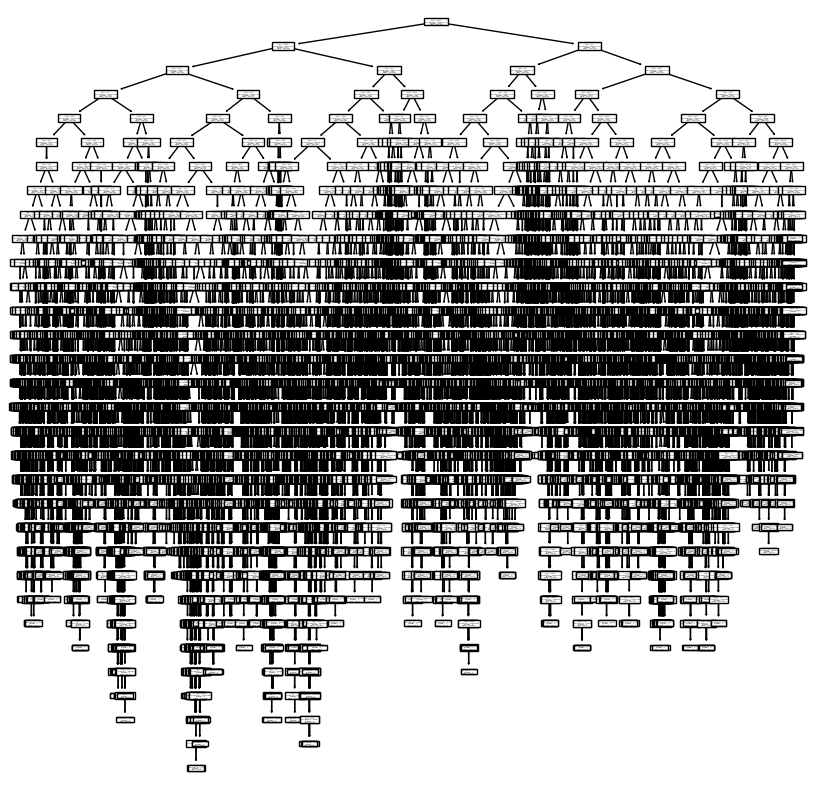

In [ ]:
#Grafico de árbol
plt.subplots(1,1,figsize=(10,10))
_= tree.plot_tree(modelo_5)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
import math

In [ ]:
MAE_5 = mean_absolute_error(Ytest, Y_hat)
MSE_5 =  mean_squared_error(Ytest, Y_hat)
RMSE_5 = math.sqrt(mean_squared_error(Ytest, Y_hat))
r2_5 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_5)
print("MSE: %.2f" % MSE_5)
print("RMSE: %.2f" % RMSE_5)
print('r2: %.2f' % r2_5)

MAE: 1516.84
MSE: 10749886.28
RMSE: 3278.70
r2: 0.74


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 6**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo de Árbol de Regresión.

➡️`Tuning`: Se sintoniza el modelo modificando los *hiperparámetros* del modelo con el fin de mejorarlo. Los hiperparámetros son configuraciones que se establecen antes de entrenar el modelo y afectan el proceso de aprendizaje, pero no son aprendidos directamente del conjunto de datos durante el entrenamiento, por lo que deben ser introducidas manualmente.

> ●   Parámetros del modelo: Son los valores que el modelo aprende directamente durante el proceso de entrenamiento. Estos valores son ajustados automáticamente por el algoritmo de entrenamiento para que el modelo se ajuste mejor a los datos de entrenamiento.

> ●   Hiperparámetros del modelo: Son valores que no son aprendidos por el modelo durante el entrenamiento, sino que deben ser configurados antes de entrenar el modelo. Estos hiperparámetros afectan la estructura o el comportamiento del modelo, como por ejemplo, la profundidad máxima de un árbol de decisión. La optimización de hiperparámetros implica encontrar los mejores valores para estos parámetros antes de entrenar el modelo.


In [ ]:
modelo_6 = DecisionTreeRegressor(max_depth=12, min_samples_split=3, min_samples_leaf=3)

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_6.fit(Xtrain, Ytrain)

DecisionTreeRegressor(max_depth=12, min_samples_leaf=3, min_samples_split=3)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_6.predict(Xtest)

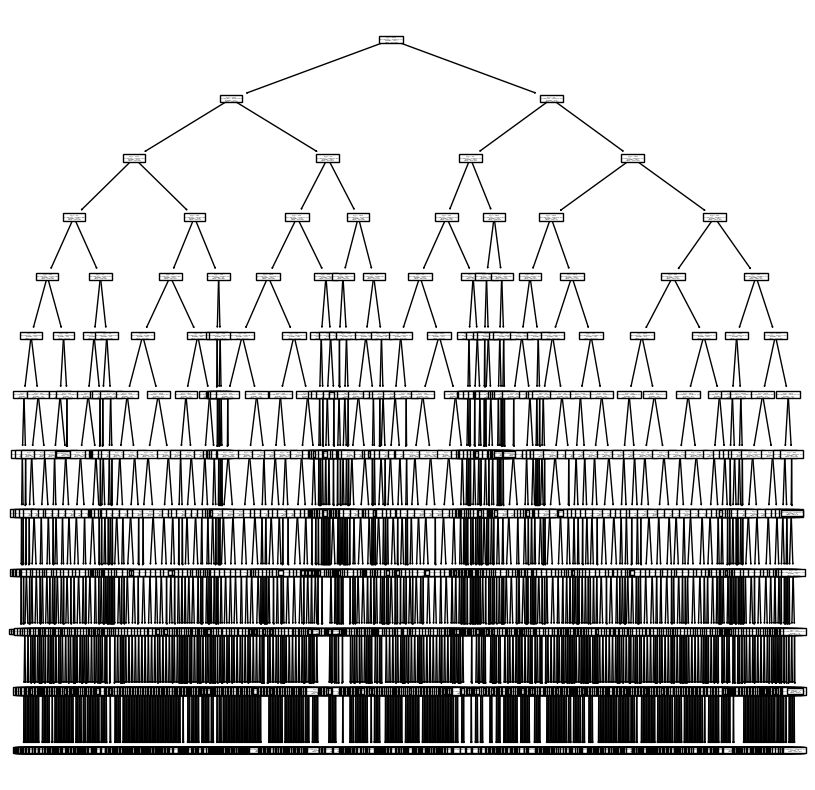

In [ ]:
#Grafico de árbol
plt.subplots(1,1,figsize=(10,10))
_= tree.plot_tree(modelo_6)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_6 = mean_absolute_error(Ytest, Y_hat)
MSE_6 =  mean_squared_error(Ytest, Y_hat)
RMSE_6 = math.sqrt(mean_squared_error(Ytest, Y_hat))
r2_6 = r2_score(Ytest, Y_hat)
print("MAE: %.2f" % MAE_6)
print("MSE: %.2f" % MSE_6)
print("RMSE: %.2f" % RMSE_6)
print('r2: %.2f' % r2_6)

MAE: 1931.02
MSE: 11383230.09
RMSE: 3373.90
r2: 0.73


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 7**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo de Árbol de Regresión.

Probar manualmente ajustando ambos hiperparámetros hasta encontrar los valores óptimos puede tomar mucho tiempo, por lo que es mejor utilizar un algoritmo que ayude a encontrar la mejor combinación de éstos.

Existen algoritmos que realizan una búsqueda de hiperparámetros y evalúan el rendimiento del modelo utilizando validación cruzada en cada combinación. Luego seleccionan la combinación que obtenga el mejor rendimiento de acuerdo con una métrica específica (por ejemplo, MSE o r2 en un problema de regresión). La mejor combinacióon de hiperparámetros contendrá los valores óptimos que maximicen el rendimiento del modelo.

Esto es una parte importante del proceso para obtener un modelo que se generalice bien a datos no vistos.

➡️ `RandomizedSearchCV`: Realiza una búsqueda aleatoria en un espacio de hiperparámetros dado y utiliza validación cruzada para evaluar el rendimiento de cada combinación de hiperparámetros.

Parámetros (sci-kit learn):

> ●   `estimator`:  Estimador (modelo) que se entrenará y ajustará durante la búsqueda de hiperparámetros.

> ●   `param_distributions`: Diccionario que mapea nombres de hiperparámetros a distribuciones de probabilidad desde las cuales se muestrearán los valores de hiperparámetros durante la búsqueda aleatoria. Cada clave en el diccionario corresponde a un hiperparámetro y el valor asociado es una tupla que especifica el rango o los valores permitidos para ese hiperparámetro.

> ●   `n_iter`: Número de combinaciones de hiperparámetros que se deben probar de forma aleatoria.

> ●   `cv`: Esquema de validación cruzada para evaluar el rendimiento del modelo. Puede ser un objeto generador de validación cruzada (como KFold o StratifiedKFold) o un entero que indica el número de divisiones (folds) en la validación cruzada.

> ●   `scoring`: La métrica utilizada para evaluar el rendimiento del modelo.Por default es 'None', por lo tanto no realiza una evaluación.

> ●   `random_state`: Semilla aleatoria para garantizar la reproducibilidad de los resultados.

In [ ]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint

In [ ]:
# Define el espacio de hiperparámetros que deseas explorar
param_dist = {
    'max_depth': randint(1, 10),  # Rango de profundidad máxima
    'min_samples_split': randint(1, 6),  # Rango de min_samples_split
    'min_samples_leaf': randint(1, 6),  # Rango de min_samples_leaf
    'max_features': randint(1, 8) # Rango de max_features
    }

# Crea un objeto DecisionTreeRegressor
modelo = DecisionTreeRegressor(random_state=123)

# Crea un objeto RandomizedSearchCV
random_search = RandomizedSearchCV(modelo, param_distributions=param_dist, n_iter=100, cv=5, scoring='r2', random_state=123)

# Realiza la búsqueda aleatoria en los datos de entrenamiento
random_search.fit(Xtrain, Ytrain)

# Muestra los mejores hiperparámetros encontrados
print("Mejores hiperparámetros encontrados:")
print(random_search.best_params_)

Mejores hiperparámetros encontrados:
{'max_depth': 9, 'max_features': 7, 'min_samples_leaf': 2, 'min_samples_split': 4}


✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
# Utiliza los mejores hiperparámetros encontrados para crear el modelo
modelo_7 = DecisionTreeRegressor(max_depth=random_search.best_params_['max_depth'],
                                   min_samples_split=random_search.best_params_['min_samples_split'],
                                   min_samples_leaf=random_search.best_params_['min_samples_leaf'],
                                   random_state=123)

# Entrena el modelo con los mejores hiperparámetros en los datos de entrenamiento
modelo_7.fit(Xtrain, Ytrain)

DecisionTreeRegressor(max_depth=9, min_samples_leaf=2, min_samples_split=4,
                      random_state=123)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_7.predict(Xtest)

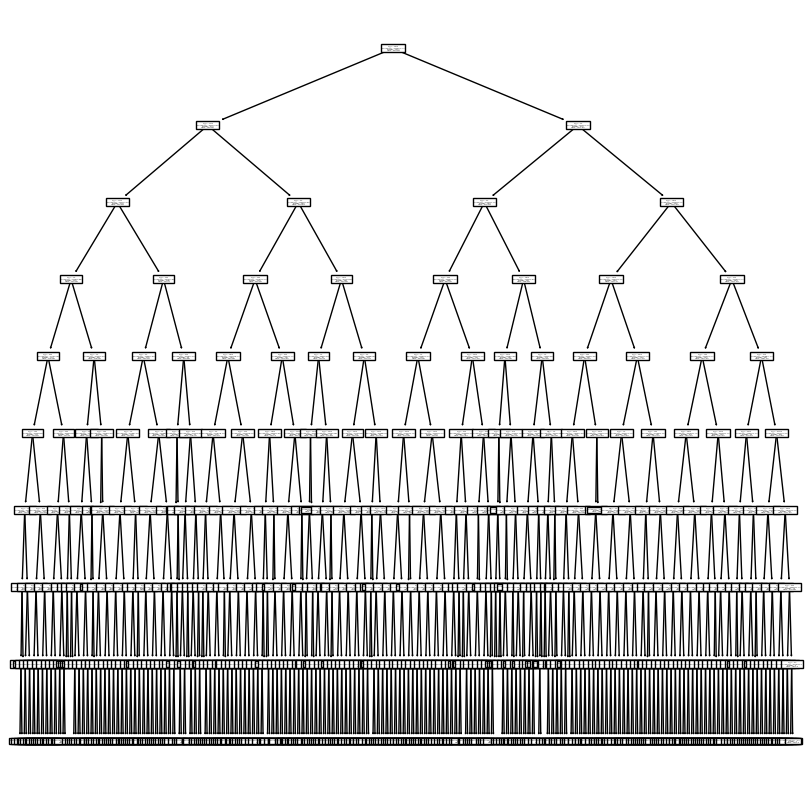

In [ ]:
plt.subplots(1,1,figsize=(10,10))
_= tree.plot_tree(modelo_7)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_7 = mean_absolute_error(Ytest, Y_hat)
MSE_7 =  mean_squared_error(Ytest, Y_hat)
RMSE_7 = math.sqrt(mean_squared_error(Ytest, Y_hat))
r2_7 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_7)
print("MSE: %.2f" % MSE_7)
print("RMSE: %.2f" % RMSE_7)
print('r2: %.2f' % r2_7)

MAE: 2184.22
MSE: 12370471.48
RMSE: 3517.17
r2: 0.71


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 8**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo de Árbol de Regresión.

➡️ `GridSearchCV`: Es una técnica de validación cruzada que se ejecuta a través de los diferentes hiperparámetros que se introducen en la cuadrícula de hiperparámetros (matriz o grilla) y extrae la mejor combinación de éstos. A diferencia de RandomSearchCV, GridSearchCV realizará una búsqueda exhaustiva a través de todas las combinaciones posibles de valores en el rango especificado.

Parámetros (sci-kit learn):

> ●   `estimator`:  Estimador (modelo) que se entrenará y ajustará durante la búsqueda de hiperparámetros.

> ●   `param_grid`: diccionario o lista de diccionarios que especifica los hiperparámetros que se desean ajustar y las combinaciones de valores que se quieren probar. Cada clave del diccionario es el nombre de un hiperparámetro, y el valor asociado es una lista de valores que se probarán.

> ●   `cv`: Esquema de validación cruzada para evaluar el rendimiento del modelo. Puede ser un objeto generador de validación cruzada (como KFold o StratifiedKFold) o un entero que indica el número de divisiones (folds) en la validación cruzada.

> ●   `scoring`: La métrica utilizada para evaluar el rendimiento del modelo.Por default es 'None', por lo tanto no realiza una evaluación.

> ●   `random_state`: Semilla aleatoria para garantizar la reproducibilidad de los resultados.

In [ ]:
from sklearn.model_selection import GridSearchCV

In [ ]:
#Definición de hiperparámetros para crear la matriz (grilla):
params = {"max_depth": np.arange(4,12),
          "min_samples_split": np.arange(2,6),
          "min_samples_leaf": np.arange(2,6),
          "max_features": np.arange(2,8)}


# Crea un objeto DecisionTreeRegressor
modelo = DecisionTreeRegressor(random_state=123)

#Búsqueda de los mejores hiperparámetros dentro de la matriz, usando como base el modelo anterior:
grid_search = GridSearchCV(estimator=modelo, param_grid=params,cv=10)

grid_search.fit(Xtrain, Ytrain)

print("Mejores hiperparámetros encontrados:")
print(grid_search.best_params_)

Mejores hiperparámetros encontrados:
{'max_depth': 11, 'max_features': 7, 'min_samples_leaf': 5, 'min_samples_split': 2}


In [ ]:
# Crear un nuevo modelo con los mejores hiperparámetros
best_params = grid_search.best_params_

modelo_8 = DecisionTreeRegressor(random_state=123,
                                      max_depth=best_params["max_depth"],
                                      min_samples_split=best_params["min_samples_split"],
                                      min_samples_leaf=best_params["min_samples_leaf"],
                                      max_features=best_params["max_features"])

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
# Ajustar el nuevo modelo a los datos de entrenamiento completos (Xtrain, Ytrain)
modelo_8.fit(Xtrain, Ytrain)

DecisionTreeRegressor(max_depth=11, max_features=7, min_samples_leaf=5,
                      random_state=123)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_8.predict(Xtest)

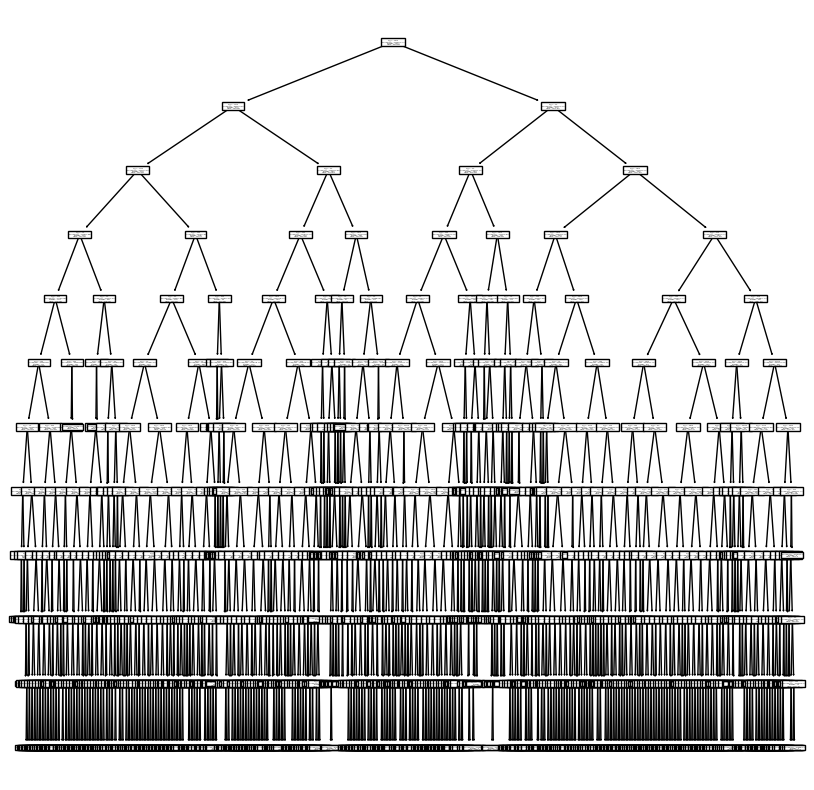

In [ ]:
plt.subplots(1,1,figsize=(10,10))
_= tree.plot_tree(modelo_8)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_8 = mean_absolute_error(Ytest, Y_hat)
MSE_8 =  mean_squared_error(Ytest, Y_hat)
RMSE_8 = math.sqrt(mean_squared_error(Ytest, Y_hat))
r2_8 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_8)
print("MSE: %.2f" % MSE_8)
print("RMSE: %.2f" % RMSE_8)
print('r2: %.2f' % r2_8)

MAE: 1985.37
MSE: 11433858.17
RMSE: 3381.40
r2: 0.73


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

###**3. K-Nearest Neighbors (KNN)**

➡️ `KNeighborsRegressor()`: Calcula un valor promedio (o ponderado) de los valores numéricos de los "vecinos" más cercanos. Este algoritmo se basa en el principio de que los puntos de datos similares tienden a estar cerca en el espacio de características. El espacio de características es un lugar abstracto donde los datos se representan y se analizan, donde cada dimensión corresponde a una característica o atributo específico de los datos.

Parámetros:

> ●   `n_neighbors`:  Define el número de vecinos cercanos (k) que se utilizarán para hacer predicciones. Valores más pequeños de "k" pueden llevar a un modelo más sensible al ruido, mientras que valores más grandes pueden suavizar la decisión, pero podrían perder detalles.

> ●   `metric`: Especifica la métrica de distancia utilizada para medir la similitud entre los puntos de datos. Algunas opciones comunes incluyen 'euclidean', 'manhattan', 'chebyshev', 'minkowski', y 'hamming', entre otras.

> ●   `p`: Controla la potencia en la métrica de Minkowski. Cuando p = 2, se utiliza la distancia euclidiana; cuando p = 1, se utiliza la distancia de Manhattan. Valores más bajos de p dan más peso a las diferencias individuales en las características, mientras que valores más altos de p dan menos peso a las diferencias individuales y tienden a considerarlas más uniformemente.

> ●   `weights`: Controla cómo se ponderan las contribuciones de los vecinos al hacer una predicción. Puede tomar dos valores principales: 'uniform' donde todos los vecinos tienen el mismo peso en la predicción y 'distance' donde los vecinos más cercanos tienen un mayor peso en la predicción que los vecinos más lejanos, y el peso se calcula en función de la inversa de la distancia.

➡️ `Métricas de distancia`:  Se usa para medir la similitud entre puntos de datos en un espacio de características.

> ●   `Distancia Euclidiana (euclidian)`: Es una métrica utilizada para medir la similitud o distancia entre dos puntos de datos en un espacio de características. En KNN, se calcula la distancia euclidiana entre un punto de consulta y todos los puntos de datos en el conjunto de entrenamiento.

> ●   `Distancia de Manhattan (manhattan)`: También conocida como distancia de la ciudad o distancia L1, esta métrica calcula la suma de las diferencias absolutas entre las coordenadas de los puntos. Es especialmente útil cuando las características tienen diferentes escalas o cuando estás trabajando en un espacio de características con restricciones de movimiento vertical y horizontal, como en una cuadrícula de calles.

> ●   `Distancia de Chebyshev (chebyshev)`: Esta métrica calcula la máxima diferencia absoluta entre las coordenadas de los puntos. En otras palabras, considera la coordenada que tiene la mayor diferencia absoluta entre los puntos.

> ●   `Distancia de Minkowski (minkowski)`:  Es una métrica generalizada que incluye tanto la distancia euclidiana como la distancia de Manhattan como casos especiales. Puedes ajustar un parámetro llamado p para controlar la forma de la métrica, donde p = 2 es equivalente a la distancia euclidiana y p = 1 es equivalente a la distancia de Manhattan.

> ●   `Distancia de Hamming (hamming)`:  Esta métrica se utiliza comúnmente cuando trabajas con datos categóricos en lugar de datos numéricos. Calcula la fracción de coordenadas en las que dos puntos difieren.

####**Modelo 9**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo KNN.

In [ ]:
from sklearn.neighbors import KNeighborsRegressor

In [ ]:
modelo_9 = KNeighborsRegressor(n_neighbors=5)

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_9.fit(Xtrain, Ytrain)

KNeighborsRegressor()

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_9.predict(Xtest)

Con este modelo se predece el precio de una casa basado en las características de casas similares cercanas.

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_9 = mean_absolute_error(Ytest, Y_hat)
MSE_9 =  mean_squared_error(Ytest, Y_hat)
RMSE_9 = rmse(Ytest, Y_hat)
r2_9 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_9)
print("MSE: %.2f" % MSE_9)
print("RMSE: %.2f" % RMSE_9)
print('r2: %.2f' % r2_9)

MAE: 2360.92
MSE: 14060124.37
RMSE: 3749.68
r2: 0.67


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 10**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo KNN.

In [ ]:
modelo_10 = KNeighborsRegressor(n_neighbors=3, metric='manhattan', weights='distance')

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_10.fit(Xtrain, Ytrain)

KNeighborsRegressor(metric='manhattan', n_neighbors=3, weights='distance')

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

Se pone a prueba el modelo realizando una predicción con datos fuera de la muestra (out-of-sample).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_10.predict(Xtest)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_10 = mean_absolute_error(Ytest, Y_hat)
MSE_10 =  mean_squared_error(Ytest, Y_hat)
RMSE_10 = rmse(Ytest, Y_hat)
r2_10 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_10)
print("MSE: %.2f" % MSE_10)
print("RMSE: %.2f" % RMSE_10)
print('r2: %.2f' % r2_10)

MAE: 1547.06
MSE: 10501612.55
RMSE: 3240.62
r2: 0.75


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 11**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo KNN.

In [ ]:
modelo_11 = KNeighborsRegressor(n_neighbors=10, metric='minkowski', p=3)

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_11.fit(Xtrain, Ytrain)

KNeighborsRegressor(n_neighbors=10, p=3)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

Se pone a prueba el modelo realizando una predicción con datos fuera de la muestra (out-of-sample).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_11.predict(Xtest)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_11 = mean_absolute_error(Ytest, Y_hat)
MSE_11 =  mean_squared_error(Ytest, Y_hat)
RMSE_11 = rmse(Ytest, Y_hat)
r2_11 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_11)
print("MSE: %.2f" % MSE_11)
print("RMSE: %.2f" % RMSE_11)
print('r2: %.2f' % r2_11)

MAE: 2542.13
MSE: 15038786.21
RMSE: 3877.99
r2: 0.64


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 12**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo KNN.

In [ ]:
# Definir la lista de hiperparámetros a probar
param_grid = {
    'n_neighbors': [3, 5, 7, 9, 12],  # Valores de K
    'metric': ['euclidean', 'manhattan', 'minkowski']  # Métricas de distancia
}

# Crear el modelo KNN Regressor
modelo = KNeighborsRegressor()

# Realizar la búsqueda en cuadrícula
grid_search = GridSearchCV(estimator=modelo, param_grid=param_grid, scoring='neg_mean_squared_error', cv=5)
grid_search.fit(Xtrain, Ytrain)  # X_train y y_train son tus datos de entrenamiento

# Obtener los mejores hiperparámetros
best_params = grid_search.best_params_
best_params

{'metric': 'manhattan', 'n_neighbors': 12}

In [ ]:
# Crear un nuevo modelo KNN Regressor con los mejores parámetros
best_k = best_params['n_neighbors']  # Mejor valor de K
best_metric = best_params['metric']  # Mejor métrica de distancia

modelo_12 = KNeighborsRegressor(n_neighbors=best_k, metric=best_metric, weights='distance')

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_12.fit(Xtrain, Ytrain)

KNeighborsRegressor(metric='manhattan', n_neighbors=12, weights='distance')

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

Se pone a prueba el modelo realizando una predicción con datos fuera de la muestra (out-of-sample).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_12.predict(Xtest)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_12 = mean_absolute_error(Ytest, Y_hat)
MSE_12 =  mean_squared_error(Ytest, Y_hat)
RMSE_12 = rmse(Ytest, Y_hat)
r2_12 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_12)
print("MSE: %.2f" % MSE_12)
print("RMSE: %.2f" % RMSE_12)
print('r2: %.2f' % r2_12)

MAE: 1562.86
MSE: 9368021.15
RMSE: 3060.72
r2: 0.78


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

###**4. Random Forest**

➡️ `RandomForestRegressor()`:  Se basa en el concepto de "ensamblaje de árboles" y pertenece a la categoría de métodos de ensamblaje, lo que significa que combina múltiples modelos de árbol de decisión para mejorar la precisión y la robustez del modelo.

Parámetros (sci-kit learn):

> ●   `n_estimators`:  Controla el número de árboles en el bosque. Un valor mayor generalmente mejora la calidad del modelo, pero también puede aumentar el costo computacional. Debes ajustarlo según tus necesidades, pero valores típicos suelen oscilar entre 50 y 500.

> ●   `max_depth`:  Controla la profundidad máxima de cada árbol en el bosque. Limitar la profundidad puede ayudar a prevenir el sobreajuste (overfitting). Si no se establece un valor, los árboles se expandirán hasta que todas las hojas contengan un número mínimo de muestras (controlado por min_samples_split o min_samples_leaf). Ajustar max_depth es útil para controlar la complejidad del modelo.

> ●   `min_samples_split`:  Define el número mínimo de muestras requeridas para dividir un nodo interno de cada árbol. Si un nodo tiene menos de este número de muestras, no se dividirá más. Ajustar este valor puede ayudar a controlar el sobreajuste.

> ●   `min_samples_leaf`:  Establece el número mínimo de muestras requeridas en una hoja (nodo terminal) de cada árbol. Similar a min_samples_split, este parámetro controla el sobreajuste regulando la cantidad de datos necesarios en cada hoja.

> ●   `max_features`:  Controla la cantidad de características que se consideran al buscar la mejor división en cada nodo de cada árbol. Se puede establecer como un número entero (el número exacto de características a considerar) o como una fracción (por ejemplo, "sqrt" para la raíz cuadrada del número total de características). La elección de características aleatorias en cada división ayuda a reducir la correlación entre los árboles y mejora la generalización.

> ●   `random_state`:  Permite establecer una semilla para la generación de números aleatorios, lo que garantiza reproducibilidad en los resultados.

####**Modelo 13**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo Random Forest.

In [ ]:
from sklearn.ensemble import RandomForestRegressor

In [ ]:
modelo_13 = RandomForestRegressor(n_estimators=100, max_depth=10)

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_13.fit(Xtrain, Ytrain)

RandomForestRegressor(max_depth=10)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_13.predict(Xtest)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_13 = mean_absolute_error(Ytest, Y_hat)
MSE_13 =  mean_squared_error(Ytest, Y_hat)
RMSE_13 = math.sqrt(mean_squared_error(Ytest, Y_hat))
r2_13 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_13)
print("MSE: %.2f" % MSE_13)
print("RMSE: %.2f" % RMSE_13)
print('r2: %.2f' % r2_13)

MAE: 1948.73
MSE: 10265308.66
RMSE: 3203.95
r2: 0.76


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 14**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo Random Forest.

In [ ]:
modelo_14 = RandomForestRegressor(n_estimators=100, max_depth=10, min_samples_split=2,min_samples_leaf=2, max_features='sqrt')

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_14.fit(Xtrain, Ytrain)

RandomForestRegressor(max_depth=10, max_features='sqrt', min_samples_leaf=2)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_14.predict(Xtest)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_14 = mean_absolute_error(Ytest, Y_hat)
MSE_14 =  mean_squared_error(Ytest, Y_hat)
RMSE_14 = math.sqrt(mean_squared_error(Ytest, Y_hat))
r2_14 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_14)
print("MSE: %.2f" % MSE_14)
print("RMSE: %.2f" % RMSE_14)
print('r2: %.2f' % r2_14)

MAE: 2217.66
MSE: 11842059.01
RMSE: 3441.23
r2: 0.72


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 15**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo Random Forest.

In [ ]:
# Ajuste de hiperparámetros utilizando GridSearchCV
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['auto', 'sqrt', 'log2']
}

# Crear una instancia del modelo Random Forest
modelo = RandomForestRegressor(random_state=123)

# Utilizar GridSearchCV para encontrar la mejor combinación de hiperparámetros
grid_search = GridSearchCV(estimator=modelo, param_grid=param_grid, cv=5, scoring='neg_mean_squared_error')
grid_search.fit(Xtrain, Ytrain)

# Obtener la mejor combinación de hiperparámetros
mejores_parametros = grid_search.best_params_
mejores_parametros

{'max_depth': 20,
 'max_features': 'auto',
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 200}

In [ ]:
# Crear un modelo Random Forest con los mejores parámetros
modelo_15 = RandomForestRegressor(**mejores_parametros, random_state=123)

'''
Se utiliza el doble asterisco (**) para desempaquetar el diccionario de parámetros
(mejores_parametros) y pasarlos como argumentos individuales al constructor del modelo.
'''

'\nSe utiliza el doble asterisco (**) para desempaquetar el diccionario de parámetros\n(mejores_parametros) y pasarlos como argumentos individuales al constructor del modelo.\n'

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_15.fit(Xtrain, Ytrain)

RandomForestRegressor(max_depth=20, max_features='auto', n_estimators=200,
                      random_state=123)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_15.predict(Xtest)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_15 = mean_absolute_error(Ytest, Y_hat)
MSE_15 =  mean_squared_error(Ytest, Y_hat)
RMSE_15 = math.sqrt(mean_squared_error(Ytest, Y_hat))
r2_15 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_15)
print("MSE: %.2f" % MSE_15)
print("RMSE: %.2f" % RMSE_15)
print('r2: %.2f' % r2_15)

MAE: 1463.30
MSE: 7598393.58
RMSE: 2756.52
r2: 0.82


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

###**5. Support Vector Machines (SVM)**

➡️ `SVR()`: Máquinas de Soporte Vectorial de Regresión es un algoritmo que busca un hiperplano en un espacio multidimensional que mejor se ajuste los datos. El objetivo de este algoritmo es encontrar una función que modele la relación entre las características y las etiquetas numéricas de manera óptima, minimizando el error de predicción. Utiliza vectores de soporte para definir un margen máximo alrededor de la línea de regresión y busca encontrar una solución que maximice este margen, lo que hace que sea eficaz para tareas de regresión tanto lineales como no lineales.

Los "vectores de soporte" son puntos de datos específicos en un conjunto de datos. Estos puntos son llamados "vectores" porque representan puntos en un espacio de características multidimensional, y son llamados "de soporte" porque desempeñan un papel crucial en la definición del hiperplano de separación o de decisión.

Parámetros:

> ●   `kernel`:  especifica el tipo de kernel a utilizar en el modelo SVR. Algunas opciones comunes son 'linear' (kernel lineal), 'poly' (kernel polinómico), 'rbf' (kernel radial), entre otros. Un kernel es una función matemática que se utiliza para transformar los datos de entrada desde un espacio de características original a un espacio de características de mayor dimensión. La idea detrás de la utilización de un kernel es permitir que SVM (u otros algoritmos) puedan manejar problemas que no son linealmente separables en el espacio de características original.

> ●   `C`: Controla el término de regularización en SVR. Determina el equilibrio entre la maximización del margen y la minimización del error de regresión. Valores más grandes de C permiten un margen más pequeño pero pueden reducir el error de entrenamiento, lo que podría llevar a un sobreajuste.

> ●   `epsilon`: Controla el ancho de la banda de insensibilidad (insensitive zone) alrededor del margen. Especifica un rango dentro del cual los errores de regresión se consideran aceptables y no se penalizan. Un valor mayor de epsilon permite un margen más amplio y tolerancia a errores más grandes.

> ●   `gamma`: Este parámetro es relevante solo para algunos kernels, como el kernel 'rbf' (radial basis function) y el kernel 'poly' (polinómico). Controla la influencia de los puntos de datos en la función de decisión. Valores más pequeños de gamma dan como resultado una función de decisión más suave, mientras que valores más grandes hacen que la función sea más sensible a los puntos de datos cercanos.

> ●   `kernel parameters`: Dependiendo del kernel seleccionado, puede haber otros parámetros específicos del kernel que se puedan ajustar. Por ejemplo, para el kernel polinómico, se puede configurar el grado del polinomio.  

####**Modelo 16**



✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo SVM.


In [ ]:
from sklearn.svm import SVR

In [ ]:
modelo_16 = SVR(kernel='linear')

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_16.fit(Xtrain, Ytrain)

SVR(kernel='linear')

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_16.predict(Xtest)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_16 = mean_absolute_error(Ytest, Y_hat)
MSE_16 = mean_squared_error(Ytest, Y_hat)
RMSE_16 = np.sqrt(MSE_16)
r2_16 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_16)
print("MSE: %.2f" % MSE_16)
print("RMSE: %.2f" % RMSE_16)
print('r2: %.2f' % r2_16)

MAE: 3215.43
MSE: 24142943.69
RMSE: 4913.55
r2: 0.43


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 17**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo SVM.

In [ ]:
modelo_17 = SVR(kernel='rbf', C=1.0, gamma=0.1)

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_17.fit(Xtrain, Ytrain)

SVR(gamma=0.1)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

Se pone a prueba el modelo realizando una predicción con datos fuera de la muestra (out-of-sample).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_17.predict(Xtest)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_17 = mean_absolute_error(Ytest, Y_hat)
MSE_17 =  mean_squared_error(Ytest, Y_hat)
RMSE_17 = np.sqrt(MSE_17)
r2_17 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_17)
print("MSE: %.2f" % MSE_17)
print("RMSE: %.2f" % RMSE_17)
print('r2: %.2f' % r2_17)

MAE: 4887.12
MSE: 46844954.93
RMSE: 6844.34
r2: -0.11


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 18**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo SVM.

In [ ]:
modelo_18 = SVR(kernel='poly', degree=3, C=1.0)

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_18.fit(Xtrain, Ytrain)

SVR(kernel='poly')

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

Se pone a prueba el modelo realizando una predicción con datos fuera de la muestra (out-of-sample).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_18.predict(Xtest)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_18 = mean_absolute_error(Ytest, Y_hat)
MSE_18 =  mean_squared_error(Ytest, Y_hat)
RMSE_18 = np.sqrt(MSE_18)
r2_18 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_18)
print("MSE: %.2f" % MSE_18)
print("RMSE: %.2f" % RMSE_18)
print('r2: %.2f' % r2_18)

MAE: 4178.71
MSE: 39846243.51
RMSE: 6312.39
r2: 0.05


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 19**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo SVM.

➡️ `Optimización Bayesiana`: La optimización bayesiana es una técnica avanzada de optimización que se utiliza para encontrar los mejores hiperparámetros de un modelo de manera eficiente. Se basa en el teorema de Bayes y utiliza una combinación de modelado probabilístico y búsqueda secuencial para explorar el espacio de hiperparámetros y encontrar la configuración óptima que minimice (o maximice) una función objetivo.

La optimización bayesiana es particularmente útil cuando el espacio de hiperparámetros es grande o cuando se dispone de recursos computacionales limitados, ya que permite encontrar una buena configuración en menos pasos que la búsqueda en rejilla o la búsqueda aleatoria.

➡️ `BayesSearchCV()`: Se utiliza para realizar una búsqueda bayesiana de hiperparámetros en modelos de aprendizaje automático. BayesSearchCV es una extensión de `GridSearchCV` y `RandomizedSearchCV`, pero utiliza un enfoque de optimización bayesiana más avanzado para explorar el espacio de hiperparámetros de manera eficiente.

Parámetros:

> ●   `estimator`: Modelo que se quiere ajustar.

> ●   `search_spaces`: diccionario que define el espacio de búsqueda de hiperparámetros. Puede incluir rangos continuos o discretos, así como distribuciones logarítmicas.

> ●   `scoring`: Métrica de evaluación que se utilizará para evaluar las configuraciones de hiperparámetros.

> ●   `n_iter`: Número de iteraciones de la búsqueda bayesiana. Especifica cuántas configuraciones de hiperparámetros se evaluarán en total.

> ●   `n_points`:  Número de puntos iniciales para la optimización. Este parámetro afecta la cantidad de exploración inicial que realiza la búsqueda bayesiana.

> ●   `random_state`: Semilla aleatoria para la reproducibilidad de los resultados.

In [ ]:
pip install scikit-optimize

In [ ]:
from skopt import BayesSearchCV
from sklearn.datasets import make_regression

In [ ]:
# Define el espacio de búsqueda de hiperparámetros
param_space = {
    'C': (0.1, 10.0, 'log-uniform'),  # Rango logarítmico para C
    'gamma': (0.01, 1.0, 'log-uniform'),  # Rango logarítmico para gamma
    'kernel': ['linear', 'rbf'],  # Kernel lineal y RBF
}

# Crea un modelo SVR
modelo = SVR()

# Realiza la búsqueda bayesiana de hiperparámetros
bayes = BayesSearchCV(
    modelo,
    param_space,
    n_iter=30,  # Número de iteraciones de la búsqueda bayesiana
    cv=5,  # Número de divisiones para la validación cruzada
    n_jobs=-1,  # Utiliza todos los núcleos del procesador
    verbose=0  # Nivel de verbosidad
)

# Ajusta el modelo SVR con los mejores hiperparámetros encontrados
bayes.fit(Xtrain, Ytrain)

# Muestra los mejores hiperparámetros encontrados
print("Mejores hiperparámetros:")
print(bayes.best_params_)

Mejores hiperparámetros:
OrderedDict([('C', 10.0), ('gamma', 1.0), ('kernel', 'linear')])


In [ ]:
modelo_19 = SVR(**bayes.best_params_)

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_19.fit(Xtrain, Ytrain)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

Se pone a prueba el modelo realizando una predicción con datos fuera de la muestra (out-of-sample).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_19.predict(Xtest)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_19 = mean_absolute_error(Ytest, Y_hat)
MSE_19 =  mean_squared_error(Ytest, Y_hat)
RMSE_19 = np.sqrt(MSE_19)
r2_19 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_19)
print("MSE: %.2f" % MSE_19)
print("RMSE: %.2f" % RMSE_19)
print('r2: %.2f' % r2_19)

MAE: 3197.25
MSE: 23412875.19
RMSE: 4838.69
r2: 0.44


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

###**6. Regresión Lasso**

➡️ `Función de Pérdida`: La función de pérdida del modelo, también conocida como función de costo o función de error, no es más que la medida que cuantifica la discrepancia entre las predicciones realizadas por un modelo de aprendizaje automático  $\hat Y$ y los valores reales o etiquetas en un conjunto de datos de entrenamiento de $Y$. Esta función representa cuánto "se equivoca" el modelo al hacer predicciones y sirve como guía para el proceso de optimización del modelo durante el entrenamiento. En el caso de regresión tenemos `MAE`, `MSE` y `RSMSE`.

➡️ `Penalización`: Es una técnica que se utiliza para agregar un término adicional a la función de pérdida del modelo durante el entrenamiento. El propósito de esta penalización es controlar la complejidad del modelo y evitar el sobreajuste (overfitting).

Cuando se ajusta un modelo a un conjunto de datos de entrenamiento, es posible que el modelo se vuelva demasiado complejo y se adapte demasiado a los datos de entrenamiento. Esto puede resultar en un rendimiento deficiente en nuevos datos (conjunto de prueba) porque el modelo ha "memorizado" el conjunto de entrenamiento en lugar de aprender patrones generales. Para abordar este problema, se utiliza la penalización, que agrega un costo o penalización por la complejidad del modelo, lo que ayuda a que los modelos de aprendizaje automático generalicen mejor en nuevos datos.

Hay dos tipos de penalizaciones comunes en el aprendizaje automático:

> ●   Penalización L1 (Lasso)

> ●   Penalización L2 (Ridge)

➡️ `Penalización L1 (Lasso - Least Absolute Shrinkage and Selection Operator)`: Agrega un término a la función de pérdida que es proporcional a la suma de los valores absolutos de los coeficientes del modelo. La penalización L1 tiende a forzar algunos coeficientes a ser exactamente cero, lo que lleva a la selección automática de características y a modelos más simples.

➡️ `Lasso()`: Se utiliza para crear un modelo de regresión Lasso. El modelo de regresión Lasso agrega una penalización L1 (valor absoluto de los coeficientes) a la función de pérdida en la regresión lineal, lo que ayuda a prevenir el sobreajuste y realizar la selección automática de características.

Parámetros:

> ●   `alpha`:  Controla la fuerza de la penalización L1 (lasso). Valores más altos de alpha aumentarán la regularización y reducirán los coeficientes de las características hacia cero. (predeterminado=1.0)

> ●   `fit_intercept`: Indica si se debe ajustar un término de intercepción (sesgo) en el modelo (coeficiente independiente). (predeterminado=True)

> ●   `max_iter`: El número máximo de iteraciones que el algoritmo de optimización permitirá antes de detenerse. (predeterminado=1000)

> ●   `selection`: Puede ser 'cyclic' o 'random'. Determina el método utilizado para actualizar los coeficientes durante las iteraciones. 'cyclic' sigue un orden cíclico, mientras que 'random' selecciona aleatoriamente las características.  (predeterminado='cyclic')

> ●   `random_state`: Semilla aleatoria para la reproducibilidad de los resultados. Esto puede afectar la aleatoriedad en el proceso de selección de características si selection se establece en 'random'.

> ●   `tol`: Especifica el criterio de convergencia (tolerancia). Si el cambio en la función de pérdida entre iteraciones es menor que tol, el algoritmo de optimización se detiene. (predeterminado=0.0001)

> ●   `positive`: Si se establece en True, restringe los coeficientes a ser no negativos. (predeterminado=False)

####**Modelo 20**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo de Regresión Lasso.

In [ ]:
from sklearn.linear_model import Lasso

In [ ]:
modelo_20 = Lasso()

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_20.fit(Xtrain, Ytrain)

Lasso()

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_20.predict(Xtest)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_20 = mean_absolute_error(Ytest, Y_hat)
MSE_20 =  mean_squared_error(Ytest, Y_hat)
RMSE_20 = np.sqrt(MSE_20)
r2_20 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_20)
print("MSE: %.2f" % MSE_20)
print("RMSE: %.2f" % RMSE_20)
print('r2: %.2f' % r2_20)

MAE: 3347.06
MSE: 20699792.33
RMSE: 4549.70
r2: 0.51


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 21**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo de Regresión Lasso.

In [ ]:
modelo_21 = Lasso(alpha=0.1, max_iter=10000, selection='random', tol=1e-5, random_state=123)

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_21.fit(Xtrain, Ytrain)

Lasso(alpha=0.1, max_iter=10000, random_state=123, selection='random',
      tol=1e-05)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_21.predict(Xtest)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_21 = mean_absolute_error(Ytest, Y_hat)
MSE_21 =  mean_squared_error(Ytest, Y_hat)
RMSE_21 = np.sqrt(MSE_21)
r2_21 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_21)
print("MSE: %.2f" % MSE_21)
print("RMSE: %.2f" % RMSE_21)
print('r2: %.2f' % r2_21)

MAE: 3347.48
MSE: 20699508.60
RMSE: 4549.67
r2: 0.51


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 22**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo de Regresión Lasso.

In [ ]:
# Definir una cuadrícula de valores de hiperparámetros para buscar
param_grid = {'alpha': [0.00000001, 0.0000001, 0.000001, 0.00001, 0.0001, 0.001, 0.01, 0.1]}

modelo = Lasso()

# Realizar una búsqueda de hiperparámetros utilizando Grid Search
grid_search = GridSearchCV(modelo, param_grid, cv=5, scoring='neg_mean_squared_error')
grid_search.fit(Xtrain, Ytrain)

# Obtener los mejores hiperparámetros
best_alpha = grid_search.best_params_['alpha']
best_alpha

1e-08

In [ ]:
modelo_22 = Lasso(best_alpha)

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_22.fit(Xtrain, Ytrain)

Lasso(alpha=1e-08)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_22.predict(Xtest)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_22 = mean_absolute_error(Ytest, Y_hat)
MSE_22 =  mean_squared_error(Ytest, Y_hat)
RMSE_22 = np.sqrt(MSE_22)
r2_22 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_22)
print("MSE: %.2f" % MSE_22)
print("RMSE: %.2f" % RMSE_22)
print('r2: %.2f' % r2_22)

MAE: 3347.52
MSE: 20699477.64
RMSE: 4549.67
r2: 0.51


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 23**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo de Regresión Lasso.

In [ ]:
# Definir una cuadrícula de valores de hiperparámetros para buscar
param_grid = {
    'alpha': [0.001, 0.01, 0.1, 1.0, 10.0],
    'max_iter': [1000, 5000, 10000],
    'selection': ['cyclic', 'random'],
    'tol': [1e-3, 1e-4, 1e-5]
}

modelo = Lasso()

# Realizar una búsqueda de hiperparámetros utilizando Grid Search y validación cruzada
grid_search = GridSearchCV(modelo, param_grid, cv=5, scoring='neg_mean_squared_error')
grid_search.fit(Xtrain, Ytrain)

# Obtener los resultados de la búsqueda
results = grid_search.cv_results_

# Extraer los mejores hiperparámetros y resultados
best_index = results['mean_test_score'].argmax()
best_params = results['params'][best_index]
best_alpha = best_params['alpha']
best_max_iter = best_params['max_iter']
best_selection = best_params['selection']
best_tol = best_params['tol']
best_mse = -results['mean_test_score'][best_index]

# Imprimir los mejores hiperparámetros y su MSE asociado
print("Mejores hiperparámetros:")
print(f"alpha: {best_alpha}")
print(f"max_iter: {best_max_iter}")
print(f"selection: {best_selection}")
print(f"tol: {best_tol}")
print(f"Mejor MSE en conjunto de prueba: {best_mse}")

Mejores hiperparámetros:
alpha: 0.001
max_iter: 10000
selection: random
tol: 0.001
Mejor MSE en conjunto de prueba: 21175487.55974854


In [ ]:
modelo_23 = Lasso(alpha=best_alpha, max_iter=best_max_iter, selection=best_selection, tol=best_tol)

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_23.fit(Xtrain, Ytrain)

Lasso(alpha=0.001, max_iter=10000, selection='random', tol=0.001)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_23.predict(Xtest)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_23 = mean_absolute_error(Ytest, Y_hat)
MSE_23 =  mean_squared_error(Ytest, Y_hat)
RMSE_23 = np.sqrt(MSE_23)
r2_23 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_23)
print("MSE: %.2f" % MSE_23)
print("RMSE: %.2f" % RMSE_23)
print('r2: %.2f' % r2_23)

MAE: 3347.52
MSE: 20699477.94
RMSE: 4549.67
r2: 0.51


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

###**7. Regresión Ridge**

➡️ `Penalización L2 (Ridge)`: Agrega un término a la función de pérdida que es proporcional a la suma de los cuadrados de los coeficientes del modelo. La penalización L2 suaviza los coeficientes al reducir su magnitud, lo que ayuda a evitar el sobreajuste sin forzar coeficientes a ser cero.

➡️ `Ridge()`: Se utiliza para crear un modelo de regresión Ridge. El modelo de regresión Ridge agrega una penalización L2 (suma de los cuadrados de los coeficientes) a la función de pérdida en la regresión lineal, lo que ayuda a prevenir el sobreajuste y realizar la selección automática de características.

Parámetros:

> ●   `alpha`:  Controla la fuerza de la penalización L2 (Ridge). Valores más altos de alpha aumentarán la regularización y reducirán los coeficientes de las características hacia cero. Su valor debe ajustarse cuidadosamente para encontrar un equilibrio entre sesgo y varianza en el modelo.. (predeterminado=1.0)

> ●   `fit_intercept`: Indica si se debe ajustar un término de intercepción (sesgo) en el modelo (coeficiente independiente). (predeterminado=True)

> ●   `max_iter`: El número máximo de iteraciones que el algoritmo de optimización permitirá antes de detenerse. (predeterminado=1000)

> ●   `solver`: algoritmo de optimización utilizado para ajustar el modelo. Puede ser uno de los siguientes valores: 'auto', 'svd', 'cholesky', 'lsqr' o 'saga'. Cada algoritmo tiene sus propias características y eficiencia. (predeterminado='auto')

####**Modelo 24**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo de Regresión Ridge.

In [ ]:
from sklearn.linear_model import Ridge

In [ ]:
modelo_24 = Ridge()

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_24.fit(Xtrain, Ytrain)

Ridge()

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_24.predict(Xtest)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_24 = mean_absolute_error(Ytest, Y_hat)
MSE_24 =  mean_squared_error(Ytest, Y_hat)
RMSE_24 = np.sqrt(MSE_24)
r2_24 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_24)
print("MSE: %.2f" % MSE_24)
print("RMSE: %.2f" % RMSE_24)
print('r2: %.2f' % r2_24)

MAE: 3347.45
MSE: 20699561.69
RMSE: 4549.68
r2: 0.51


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 25**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo de Regresión Ridge.

In [ ]:
modelo_25 = Ridge(alpha=0.1, max_iter=10000, solver='svd')

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_25.fit(Xtrain, Ytrain)

Ridge(alpha=0.1, max_iter=10000, solver='svd')

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_24.predict(Xtest)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_24 = mean_absolute_error(Ytest, Y_hat)
MSE_24 =  mean_squared_error(Ytest, Y_hat)
RMSE_24 = np.sqrt(MSE_24)
r2_24 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_24)
print("MSE: %.2f" % MSE_24)
print("RMSE: %.2f" % RMSE_24)
print('r2: %.2f' % r2_24)

MAE: 3347.45
MSE: 20699561.69
RMSE: 4549.68
r2: 0.51


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 26**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo de Regresión Ridge.

In [ ]:
# Definir una cuadrícula de valores de hiperparámetros para buscar
param_grid = {
    'alpha': [0.0001, 0.001, 0.01, 0.1, 1.0, 10.0],
    'fit_intercept': [True, False],
    'solver': ['auto', 'svd', 'cholesky', 'lsqr', 'saga'],
    'max_iter': [100, 500, 1000]
}

# Crear una instancia de Ridge
modelo = Ridge()

# Realizar una búsqueda de hiperparámetros utilizando Grid Search y validación cruzada
grid_search = GridSearchCV(modelo, param_grid, cv=5, scoring='neg_mean_squared_error')
grid_search.fit(Xtrain, Ytrain)

# Obtener los mejores hiperparámetros del resultado de la búsqueda
best_params = grid_search.best_params_
best_params

{'alpha': 0.1, 'fit_intercept': True, 'max_iter': 100, 'solver': 'auto'}

In [ ]:
modelo_26 = Ridge(**best_params)

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_26.fit(Xtrain, Ytrain)

Ridge(alpha=0.1, max_iter=100)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_26.predict(Xtest)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
MAE_26 = mean_absolute_error(Ytest, Y_hat)
MSE_26 =  mean_squared_error(Ytest, Y_hat)
RMSE_26 = np.sqrt(MSE_26)
r2_26 = r2_score(Ytest, Y_hat)

print("MAE: %.2f" % MAE_26)
print("MSE: %.2f" % MSE_26)
print("RMSE: %.2f" % RMSE_26)
print('r2: %.2f' % r2_26)

MAE: 3347.52
MSE: 20699486.03
RMSE: 4549.67
r2: 0.51


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

##**2. Modelos de Clasificación**

Se busca predecir las clases de una variable objetivo (target), utilizando una variable dependiente $Y$ de tipo categórica binaria (con 2 clases) 'Estado', la cual fue transformada en la etapa anterior obteniendo 'EN VENTA' como clase negativa (0) y 'VENDIDA' (1) como clase positiva.

In [ ]:
#Librerías de Python

import numpy as np #Programación vectorial
import pandas as pd #Estructura y manipulación de datos
import matplotlib.pyplot as plt #Visualización

import seaborn as sb #Gráficos

import warnings #Advertencias
warnings.filterwarnings('ignore')

In [ ]:
# Importación del dataset preprocesado
df = pd.read_excel("Guia_ML_Preprocesado.xlsx")

In [ ]:
#Revisamos la proporcion en que se encuentra cada clase:
print(df.groupby('Estado').size())

Estado
0    13417
1     3396
dtype: int64


Como se puede ver, las clases se encuentran desbalanceadas.

###**2.1. Regresión Logística**

➡️ `LogisticRegression()`: Se utiliza para realizar regresión logística, que es un algoritmo de clasificación binaria y multinomial. Esta clase implementa un modelo de regresión logística que se utiliza comúnmente para problemas de clasificación.

Parámetros:

> ●   `penalty`: Controla la regularización aplicada al modelo. Puede ser "l1", "l2", "elasticnet" o "none". La regularización ayuda a prevenir el sobreajuste. (predeterminado='l2')

> ●   `C`:  Inverso de la fuerza de regularización. Un valor más bajo de C implica una regularización más fuerte. Este parámetro permite controlar el equilibrio entre ajustar el modelo a los datos de entrenamiento y evitar el sobreajuste. (predeterminado=1.0)

> ●   `fit_intercept`: Si es True, se ajustará una constante (intercepto) al modelo. Si es False, no se ajustará un intercepto. (predeterminado=True)

> ●   `solver`: El algoritmo utilizado para optimizar los parámetros del modelo. Puede ser 'newton-cg', 'lbfgs', 'liblinear', 'sag' o 'saga'. La elección del solucionador puede afectar el rendimiento y la velocidad del modelo. (predeterminado='lbfgs')

> ●   `max_iter`: El número máximo de iteraciones permitidas para que el solucionador converja. (predeterminado=100)

> ●   `multi_class`: Controla cómo se manejan las clases en problemas de clasificación multiclase. Puede ser 'ovr' (One-Versus-Rest) o 'multinomial'. 'auto' ajusta automáticamente el enfoque en función del problema. (predeterminado='auto')

> ●   `tol`: Tolerancia para la convergencia del algoritmo.  (predeterminado=1e-4)

> ●   `class_weight`: Puede ser utilizado para asignar pesos a las clases en el modelo. Es útil cuando las clases están desequilibradas, donde se puede asignar un ratio o la opción automática 'balanced' para balancear los pesos de las clases. (predeterminado=None)

> ●   `random_state`: Semilla aleatoria para reproducibilidad de los resultados. (predeterminado=None)

####**Modelo 1**

✅ Paso 1 - Definición de variables: Definimos la variable objetivo $Y$ y las variables predictoras $X$.

In [ ]:
#Variable dependiente
Y = pd.DataFrame(df['Estado'])
Y.sample(5)

,Estado
3250,1
569,0
13214,0
15724,0
7305,0


In [ ]:
#Variables independientes
X = df.drop(columns=['Estado','Precio_CLP'])
X.sample(5)

,Precio_UF,Comuna,N_Habitaciones,N_Baños,Superficie_Construida_M2,Total_Superficie_M2,N_Estacionamientos
8967,4990.0,5,3,2,95,414.0,0
11296,8500.0,24,3,1,100,200.0,0
11010,7390.0,20,3,2,83,144.0,0
13589,9160.0,39,6,2,228,558.0,0
3209,4000.0,19,3,3,84,133.0,2


➡️ `Split`: Se mejora el modelo realizando una separación (split) del set de datos en *conjunto de entrenamiento* y *conjunto de prueba*. Con esta partición el set de datos quedará dividido en 4 secciones: *Xtrain, Xtest, Ytrain, Ytest*.

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
#Se define una proporcion 70/30, es decir un tamaño del conjunto de prueba de 0.3 (30%)
Xtrain, Xtest, Ytrain, Ytest = train_test_split(X,Y,test_size=0.3, random_state=123)

In [ ]:
#Conjunto de entrenamiento
print(Xtrain.shape)
print(Ytrain.shape)

(11769, 7)
(11769, 1)


In [ ]:
#Conjunto de prueba
print(Xtest.shape)
print(Ytest.shape)

(5044, 7)
(5044, 1)


✅ Paso 2 - Modelo: Creación del modelo de Regresión Logística.

In [ ]:
from sklearn.linear_model import LogisticRegression

In [ ]:
modelo_c1 = LogisticRegression()

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_c1.fit(Xtrain, Ytrain)

LogisticRegression()

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

Se pone a prueba el modelo realizando una predicción con datos fuera de la muestra (out-of-sample).

➡️ `out-of-sample`: Predicción con datos que no han sido utilizados durante el entrenamiento del modelo. Esto se hace para evaluar cómo se desempeña el modelo con datos desconocidos, como lo son los datos del conjunto de prueba (Xtest), los cuales utilizamos para validar el modelo.

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_c1.predict(Xtest)

In [ ]:
Ytest = Ytest.rename(columns={'Estado': 'Observación (Y)'})
Y_hat = pd.DataFrame(Y_hat, columns = ['Estimación (Ŷ)'])
Comparacion = pd.merge(Ytest, Y_hat, left_index=True, right_index=True)
Comparacion.head(10)

,Observación (Y),Estimación (Ŷ)
3137,1,1
4197,1,0
4943,0,1
1913,0,0
1205,1,0
1717,0,1
4196,0,1
3769,0,0
2419,0,1
2481,0,1


✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas derivadas de la matriz de confusión.

➡️ Matriz de Confusión: Es una tabla resumida que se utiliza para evaluar el rendimiento de un modelo de clasificación. El número de predicciones correctas e incorrectas se resumen con los valores de conteo y se desglosan por cada clase. Cada columna de la matriz representa el número de predicciones de cada clase, mientras que cada fila representa a las instancias de la clase real.

Para una variable categórica binaria se tienen 2 clases de $Y$:
*   *Positiva (P)*: La observación es positiva (1).
*   *Negativa (N)*: La observación NO es positiva (0).

De estas clases se derivan 4 resultados posibles que se derivan del cruce entre los resultados reales $Y$ (observación) y los resultados estimados $\hat Y$ (predicción):
> ●   `Verdadero Positivo (VP)`: Resultado donde el modelo predice correctamente la clase positiva.

> ●   `Falso Positivo (FP o error de tipo I)`: Resultado donde el modelo predice incorrectamente la clase positiva cuando en realidad es negativa.

> ●   `Verdadero Negativo (VN)`: Resultado donde el modelo predice correctamente la clase negativa.

> ●   `Falso Negativo (FN o error de tipo II)`: Resultado en el que el modelo predice incorrectamente la clase negativa cuando en realidad es positiva.

Estos resultados 4 resultados se resumen en la matriz de confusión:

In [ ]:
print("    | 0 | VN | FP |")
print(" (Y)| 1 | FN | VP |")
print("    ----|----|----|")
print("        | 0  |  1 |")
print("            (Ŷ)    ")

    | 0 | VN | FP |
 (Y)| 1 | FN | VP |
    ----|----|----|
        | 0  |  1 |
            (Ŷ)    


Cada resultado corresponde a un cuadrante de la matriz:
*   VP = [1][1] -> La clase real es 1 y el modelo estima 1
*   FP = [0][1] -> La clase real es 0 y el modelo estima 1
*   VN = [0][0] -> La clase real es 0 y el modelo estima 0
*   FN = [1][0] -> La clase real es 1 y el modelo estima 0

In [ ]:
from sklearn.metrics import confusion_matrix

In [ ]:
#Matriz de confusion
matriz = confusion_matrix(Ytest, Y_hat)
matriz

array([[3518,  462],
       [ 656,  408]])

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay

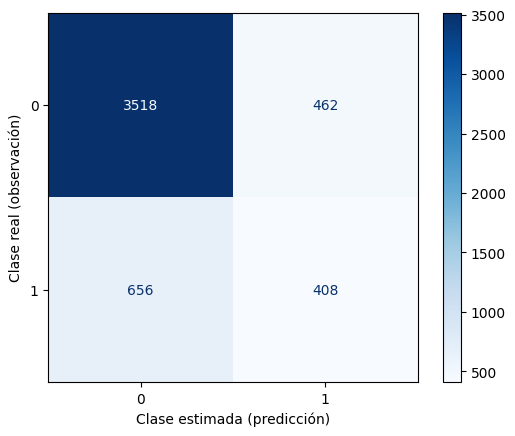

In [ ]:
grafico = ConfusionMatrixDisplay(confusion_matrix=matriz,display_labels=modelo_c1.classes_)
grafico.plot(cmap=plt.cm.Blues,values_format='g')
plt.xlabel('Clase estimada (predicción)')
plt.ylabel('Clase real (observación)')
plt.show()

In [ ]:
VN, FP, FN, VP = matriz.ravel()
print(f'Verdaderos positivos (VP): {VP}')
print(f'Falsos positivos (FP): {FP}')
print(f'Verdaderos negativos (VN): {VN}')
print(f'Falsos negativos (FN): {FN}')

Verdaderos positivos (VP): 408
Falsos positivos (FP): 462
Verdaderos negativos (VN): 3518
Falsos negativos (FN): 656


Una vez realizada la matriz de confusión, se pueden calcular un conjunto de métricas que relacionan los resultados de la matriz con el desempeño del modelo, donde se mide la diferencia entre la clase real (observación) de la variable objetivo $Y$ y la clase estimada (predicción) de ésta $\hat Y$.
Todas estas métricas son ratios que permiten realizar comparaciones entre varios modelos.

➡️ Métricas de error: El resultado de estas métricas fluctúan entre 0 y 1. Una puntuación más cercana a 0 indica un mejor modelo (con menor error) y viceversa.

> ●   `Tasa de FP`: Es la probabilidad de que se produzca una falsa alarma, es decir, que se dé un resultado positivo cuando el valor verdadero sea negativo. Se le conoce como 'Error de tipo I'.

               FP/(FP+VN)

> ●   `Tasa de FN`: Es la probabilidad de que el algoritmo pase por alto los verdaderos positivos. Se le conoce como 'Error de tipo II'.

               FN/(FN+VP)

In [ ]:
#Tasa de error
Tasa_FP_1 = FP/(FP+VN)
Tasa_FN_1 = FN/(FN+VP)

print("Error tipo I: %.2f" % Tasa_FP_1 )
print("Error tipo II: %.2f" % Tasa_FN_1 )

Error tipo I: 0.12
Error tipo II: 0.62


➡️ Métricas de desempeño: El resultado de estas métricas fluctúan entre 0 y 1. Una puntuación más cercana a 1 indica un mejor modelo  y viceversa.

> ●   `Accuracy`: Exactitud del modelo. Mide la proporción de predicciones que el modelo clasificó correctamente. Es una medida global de desempeño para todas las clases (positivas y negativas).

               (VP+VN)/(VP+FP+FN+VN)

> ●   `Precision`: Indica la dispersión del conjunto de valores obtenidos a partir de mediciones repetidas de una magnitud. Cuanto menor es la dispersión mayor la precisión. Muestra la proporción de clases positivas correctamente detectadas entre todos los resultados positivos estimados, sean verdaderos o falsos (VP y FP). Es útil únicamente cuando se tienen clases balanceadas (la cantidad de casos de la clase 0 y de las clase 1 tienen magnitudes similares)

                    VP/(VP+FP)

Para clasificación binaria, la métrica `Recall` tiene dos lecturas:

> ●   `Sensitivity`: Para la clase positiva indica la tasa de verdaderos positivos (VP). Es la proporción de casos positivos que fueron correctamente identificadas por el algoritmo.

                    VP/(VP+FN)

> ●   `Specificity`: Para la clase negativa indica la tasa de verdaderos negativos (VN). Es la proporción de casos negativos que fueron correctamente identificadas por el algoritmo.

                    VN/(VN+FP)

> ●   `F1-score`: Combina Precision y Recall en una sola métrica, calculando la media armónica entre ambas. Es útil si se  tiene una distribución de clases desigual (desbalanceada).

          2 x Precision x Recall/(Precision x Recall)

Conforme a estas métricas podemos obtener  cuatro casos posibles para cada clase:

1. Alta precisión y alto recall: el modelo de Machine Learning escogido maneja perfectamente esa clase.

2. Alta precisión y bajo recall: el modelo de Machine Learning escogido no detecta la clase muy bien, pero cuando lo hace es altamente confiable.

3. Baja precisión y alto recall: El modelo de Machine Learning escogido detecta bien la clase,  pero también incluye muestras de la otra clase.

4. Baja precisión y bajo recall: El modelo de Machine Learning escogido no logra clasificar la clase correctamente.

Cuando tenemos un conjunto de datos desbalanceado, suele ocurrir que obtenemos un alto valor de precisión en la clase mayoritaria y un bajo recall en la clase minoritaria y por ello tenemos que recurrir al balanceo de clases.

✅ Recomendaciones:

▶ Elija mayor Precisión si quiere estar más seguro de sus verdaderos positivos.

▶ La Sensibilidad le servirá para saber si no está perdiendo positivos.

▶ Utilice una Sensibilidad alta cuando la aparición de falsos negativos le resulta inaceptable pero no le importa tener falsos positivos adicionales (falsas alarmas).

▶ Elija alta Especificidad si desea identificar los verdaderos negativo o cuando no desea falsos positivos.

➡️ Otras métricas: El reporte de clasificación que muestra python contiene las métricas vistas anteriormente y además, otras métricas que sirven de guía:

`Support` es la cantidad total de registros de cada clase, la cual debe coincidir con las proporciones calculadas inicialmente.

`Macro avg` indica el promedio de cada métrica para ambas clases.

`Weighted avg` indica el promedio ponderado de cada métrica para ambas clases, considerando la proporción de las clases. Si la proporción de las clases son equilibradas, *macro avg* y *weighted avg* serán iguales. En cambio, si la proporcion de las clases es muy desigual, las metricas de *macro avg* y *weighted avg* serán distintas.

In [ ]:
from sklearn.metrics import classification_report

In [ ]:
#Tabla resumen
print(classification_report(Ytest, Y_hat))

              precision    recall  f1-score   support

           0       0.84      0.88      0.86      3980
           1       0.47      0.38      0.42      1064

    accuracy                           0.78      5044
   macro avg       0.66      0.63      0.64      5044
weighted avg       0.76      0.78      0.77      5044



In [ ]:
from sklearn.metrics import accuracy_score

In [ ]:
#Accuracy
SCORE_1 = accuracy_score(Ytest,Y_hat)
print("ACCURACY: %.2f" % SCORE_1 )

ACCURACY: 0.78


El modelo a pesar de tener un buen Accuracy (78%), tgiene una tasa de Error tipo II demasiado alta (62%), lo que implica que el modelo no es capaz de clasificar correctamente la clase minoritaria correspondiente a la clase positiva (1), sólo es capaz de predecir con mayor exactitud la clase negativa (0) al ser la clase mayoritaria.

Con esto se hace evidente que Accuracy no es la mejor métrica para evaluar el desempeño global del modelo. Al estar las clases muy desbalanceadas, Accuracy muestra una medida engañosa de la realidad, ya que no considera los errores.

La mejor métrica para medir la exactitud del modelo para casos de clases desbalanceadas es F1-Score.

In [ ]:
from sklearn.metrics import f1_score

In [ ]:
#F1-Score
f1_1 = f1_score(Ytest, Y_hat)
print("F1-Score: %.2f" % f1_1 )

F1-Score: 0.42


####**Modelo 2**

✅ Paso 1 - Definición de Variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y test.

➡️ `Normalización`: Se transforman los datos para que sigan una distribución *normal estándar*. La normalización hace que los rangos de valores que puede tomar una serie de datos de una variable sea similar, para que no exista una variable que tenga mayor influencia que otra.

---
⚠️ **NOTA** ⚠️

> ✔️ Se normaliza solamente la variable $X$.

> ⛔ La variable $Y$ no debe ser normalizada ya que perderíamos la información de cada clase.
---

In [ ]:
from sklearn.preprocessing import StandardScaler

In [ ]:
scaler = StandardScaler()

scaler.fit(Xtrain)
Xtrain_sc= scaler.transform(Xtrain)

scaler.fit(Xtest)
Xtest_sc= scaler.transform(Xtest)

✅ Paso 2 - Modelo: Creación del modelo de Regresión Logística.

In [ ]:
modelo_c2 = LogisticRegression(class_weight='balanced', random_state=123)

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain normalizada y Ytrain.

In [ ]:
modelo_c2.fit(Xtrain_sc, Ytrain)

LogisticRegression(class_weight='balanced', random_state=123)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest normalizada. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_c2.predict(Xtest_sc)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas derivadas de la matriz de confusión.

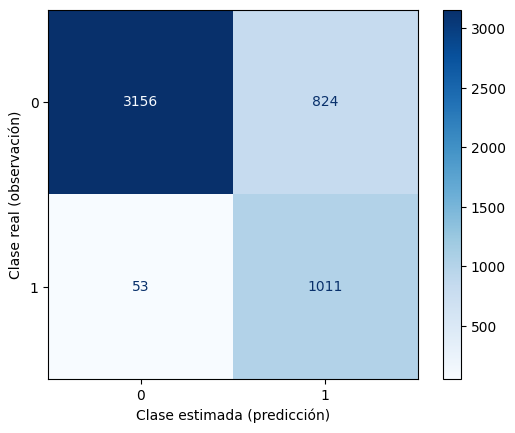

In [ ]:
#Matriz de confusion
matriz = confusion_matrix(Ytest, Y_hat)

grafico = ConfusionMatrixDisplay(confusion_matrix=matriz,display_labels=modelo_c2.classes_)
grafico.plot(cmap=plt.cm.Blues,values_format='g')
plt.xlabel('Clase estimada (predicción)')
plt.ylabel('Clase real (observación)')
plt.show()

In [ ]:
VN, FP, FN, VP = matriz.ravel()
print(f'Verdaderos positivos (VP): {VP}')
print(f'Falsos positivos (FP): {FP}')
print(f'Verdaderos negativos (VN): {VN}')
print(f'Falsos negativos (FN): {FN}')

Verdaderos positivos (VP): 1011
Falsos positivos (FP): 824
Verdaderos negativos (VN): 3156
Falsos negativos (FN): 53


In [ ]:
#Tasa de error
Tasa_FP_2 = FP/(FP+VN)
Tasa_FN_2 = FN/(FN+VP)

print("Error tipo I: %.2f" % Tasa_FP_2 )
print("Error tipo II: %.2f" % Tasa_FN_2 )

Error tipo I: 0.21
Error tipo II: 0.05


In [ ]:
#Metricas
print(classification_report(Ytest, Y_hat))

              precision    recall  f1-score   support

           0       0.98      0.79      0.88      3980
           1       0.55      0.95      0.70      1064

    accuracy                           0.83      5044
   macro avg       0.77      0.87      0.79      5044
weighted avg       0.89      0.83      0.84      5044



In [ ]:
#Accuracy
SCORE_2 = accuracy_score(Ytest,Y_hat)
print("ACCURACY: %.2f" % SCORE_2 )

#F1-Score
f1_2 = f1_score(Ytest, Y_hat)
print("F1-Score: %.2f" % f1_2 )

ACCURACY: 0.83
F1-Score: 0.70


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 3**

✅ Paso 1 - Definición de Variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y test.

✅ Paso 2 - Modelo: Creación del modelo de Regresión Logística.

In [ ]:
modelo_c3 = LogisticRegression(penalty='l1', C=0.5, solver='liblinear', class_weight={0: 1, 1: 5}, random_state=123)

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain normalizada y Ytrain.

In [ ]:
modelo_c3.fit(Xtrain_sc, Ytrain)

LogisticRegression(C=0.5, class_weight={0: 1, 1: 5}, penalty='l1',
                   random_state=123, solver='liblinear')

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest normalizada. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_c3.predict(Xtest_sc)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas derivadas de la matriz de confusión.

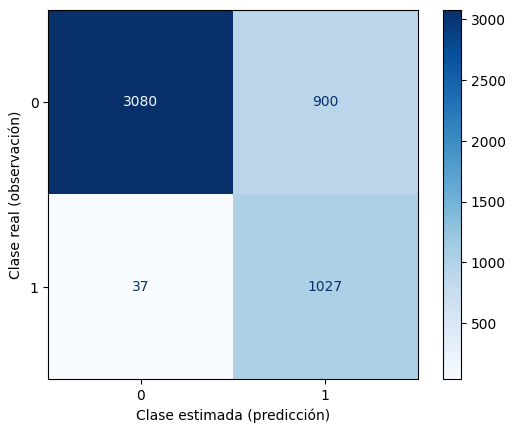

In [ ]:
#Matriz de confusion
matriz = confusion_matrix(Ytest, Y_hat)

grafico = ConfusionMatrixDisplay(confusion_matrix=matriz,display_labels=modelo_c3.classes_)
grafico.plot(cmap=plt.cm.Blues,values_format='g')
plt.xlabel('Clase estimada (predicción)')
plt.ylabel('Clase real (observación)')
plt.show()

In [ ]:
VN, FP, FN, VP = matriz.ravel()
print(f'Verdaderos positivos (VP): {VP}')
print(f'Falsos positivos (FP): {FP}')
print(f'Verdaderos negativos (VN): {VN}')
print(f'Falsos negativos (FN): {FN}')

Verdaderos positivos (VP): 1027
Falsos positivos (FP): 900
Verdaderos negativos (VN): 3080
Falsos negativos (FN): 37


In [ ]:
#Tasa de error
Tasa_FP_3 = FP/(FP+VN)
Tasa_FN_3 = FN/(FN+VP)

print("Error tipo I: %.2f" % Tasa_FP_3 )
print("Error tipo II: %.2f" % Tasa_FN_3 )

Error tipo I: 0.23
Error tipo II: 0.03


In [ ]:
#Metricas
print(classification_report(Ytest, Y_hat))

              precision    recall  f1-score   support

           0       0.99      0.77      0.87      3980
           1       0.53      0.97      0.69      1064

    accuracy                           0.81      5044
   macro avg       0.76      0.87      0.78      5044
weighted avg       0.89      0.81      0.83      5044



In [ ]:
#Accuracy
SCORE_3 = accuracy_score(Ytest,Y_hat)
print("ACCURACY: %.2f" % SCORE_3 )

#F1-Score
f1_3 = f1_score(Ytest, Y_hat)
print("F1-Score: %.2f" % f1_3 )

ACCURACY: 0.81
F1-Score: 0.69


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 4**

✅ Paso 1 - Definición de Variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y test.

✅ Paso 2 - Modelo: Creación del modelo de Regresión Logística.

In [ ]:
from sklearn.model_selection import GridSearchCV

In [ ]:
param_grid = {
    'penalty': ['l1', 'l2'],
    'C': [0.001, 0.01, 0.1, 1, 10],
    'solver': ['liblinear', 'lbfgs'],
    'max_iter': [100, 200, 300,400,500,600,700,1000,2000,3000,4000,5000]
}

grid_search = GridSearchCV(
    estimator=LogisticRegression(class_weight='balanced', random_state=123),
    param_grid=param_grid,
    scoring='accuracy',  # Utiliza la métrica de tu elección (precisión, F1-score, etc.)
    cv=5,  # Número de divisiones para la validación cruzada
    verbose=2,  # Controla la cantidad de información que se muestra durante la búsqueda
    n_jobs=-1  # Utiliza todos los núcleos disponibles para acelerar la búsqueda
)

grid_search.fit(Xtrain_sc, Ytrain)
best_params = grid_search.best_params_
best_params

Fitting 5 folds for each of 240 candidates, totalling 1200 fits


{'C': 10, 'max_iter': 100, 'penalty': 'l1', 'solver': 'liblinear'}

In [ ]:
modelo_c4 = LogisticRegression(**best_params, class_weight='balanced', random_state=123)

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain normalizada y Ytrain.

In [ ]:
modelo_c4.fit(Xtrain_sc, Ytrain)

LogisticRegression(C=10, class_weight='balanced', penalty='l1',
                   random_state=123, solver='liblinear')

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest normalizada. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_c4.predict(Xtest_sc)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas derivadas de la matriz de confusión.

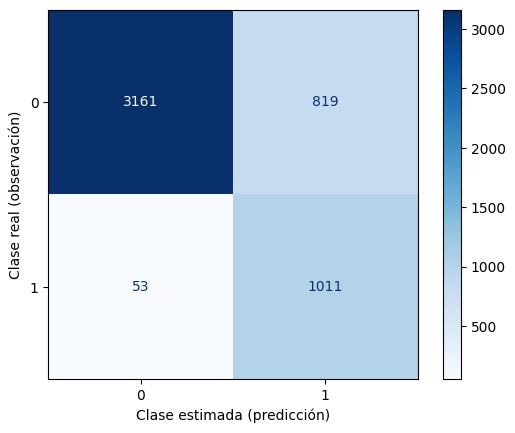

In [ ]:
#Matriz de confusion
matriz = confusion_matrix(Ytest, Y_hat)

grafico = ConfusionMatrixDisplay(confusion_matrix=matriz,display_labels=modelo_c4.classes_)
grafico.plot(cmap=plt.cm.Blues,values_format='g')
plt.xlabel('Clase estimada (predicción)')
plt.ylabel('Clase real (observación)')
plt.show()

In [ ]:
VN, FP, FN, VP = matriz.ravel()
print(f'Verdaderos positivos (VP): {VP}')
print(f'Falsos positivos (FP): {FP}')
print(f'Verdaderos negativos (VN): {VN}')
print(f'Falsos negativos (FN): {FN}')

Verdaderos positivos (VP): 1011
Falsos positivos (FP): 819
Verdaderos negativos (VN): 3161
Falsos negativos (FN): 53


In [ ]:
#Tasa de error
Tasa_FP_4 = FP/(FP+VN)
Tasa_FN_4 = FN/(FN+VP)

print("Error tipo I: %.2f" % Tasa_FP_4 )
print("Error tipo II: %.2f" % Tasa_FN_4 )

Error tipo I: 0.21
Error tipo II: 0.05


In [ ]:
#Metricas
print(classification_report(Ytest, Y_hat))

              precision    recall  f1-score   support

           0       0.98      0.79      0.88      3980
           1       0.55      0.95      0.70      1064

    accuracy                           0.83      5044
   macro avg       0.77      0.87      0.79      5044
weighted avg       0.89      0.83      0.84      5044



In [ ]:
#Accuracy
SCORE_4 = accuracy_score(Ytest,Y_hat)
print("ACCURACY: %.2f" % SCORE_4 )

#F1-Score
f1_4 = f1_score(Ytest, Y_hat)
print("F1-Score: %.2f" % f1_4 )

ACCURACY: 0.83
F1-Score: 0.70


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

###**2.2. Árbol de Decisión**

➡️ `DecisionTreeClassifier()`:  Es un algoritmo de aprendizaje automático que se utiliza para problemas de clasificación. Los árboles de decisión son algoritmos de aprendizaje supervisado que dividen el conjunto de datos en subconjuntos más pequeños basados en las características, con el objetivo de realizar una clasificación.

Parámetros:

> ●   `criterion`: Controla la función utilizada para medir la calidad de una división. Puede ser 'gini' para el índice de Gini o 'entropy' para la ganancia de información. (predeterminado='gini')

> ●   `splitter`:  Especifica la estrategia utilizada para elegir las divisiones en cada nodo del árbol. Puede ser "best" para elegir la mejor división o "random" para elegir una división aleatoria. (predeterminado='best')

> ●   `max_depth`:  Establece la profundidad máxima del árbol. Controla la profundidad máxima de las divisiones y, por lo tanto, la complejidad del árbol. Puede ser un número entero o None para permitir que el árbol crezca hasta que todas las hojas tengan menos de min_samples_split muestras. (predeterminado=None).

> ●   `min_samples_split`:  Es el número mínimo de muestras requeridas para dividir un nodo interno. Puede ser un número entero o un valor flotante que representa una fracción de las muestras totales. (predeterminado=2)

> ●   `min_samples_leaf`:  Es el número mínimo de muestras requeridas para que una hoja sea una hoja válida. Puede ser un número entero o un valor flotante que representa una fracción de las muestras totales. (predeterminado=1)

> ●   `max_features`:  Controla el número máximo de características que se considerarán al buscar la mejor división. Puede ser un número entero, una fracción o una cadena ("auto", "sqrt", "log2"). (predeterminado='auto')

> ●   `min_weight_fraction_leaf`: La fracción mínima ponderada del total de muestras requerida en un nodo hoja. (predeterminado=0)

> ●   `class_weight`: Puede ser utilizado para asignar pesos a las clases en el modelo, útil cuando las clases están desequilibradas, en ese caso se usa 'balanced'. (predeterminado=None)

> ●   `min_impurity_decrease`: Un nodo se dividirá si esta división induce una disminución de la impureza mayor o igual que el valor dado. (predeterminado=0)

> ●   `random_state`:  Permite establecer una semilla para la generación de números aleatorios, lo que garantiza reproducibilidad en los resultados.  (predeterminado=None)

####**Modelo 5**

✅ Paso 1 - Definición de Variables: Utilizamos las variables $X$ e $Y$ previamente definidas, normalizadas y divididas en conjunto de entrenamiento y test.

✅ Paso 2 - Modelo: Creación del modelo de Árbol de Clasificación.

In [ ]:
from sklearn.tree import DecisionTreeClassifier

In [ ]:
modelo_c5 = DecisionTreeClassifier()

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Ytrain y Xtrain normalizada.

In [ ]:
modelo_c5.fit(Xtrain_sc, Ytrain)

DecisionTreeClassifier()

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest normalizada. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_c5.predict(Xtest_sc)

In [ ]:
Ytest = Ytest.rename(columns={'Estado': 'Observación (Y)'})
Y_hat = pd.DataFrame(Y_hat, columns = ['Estimación (Ŷ)'])
Comparacion = pd.merge(Ytest, Y_hat, left_index=True, right_index=True)
Comparacion.head(10)

,Observación (Y),Estimación (Ŷ)
3137,1,0
4197,1,0
4943,0,0
1913,0,0
1205,1,0
1717,0,0
4196,0,0
3769,0,1
2419,0,0
2481,0,0


In [ ]:
from sklearn import tree

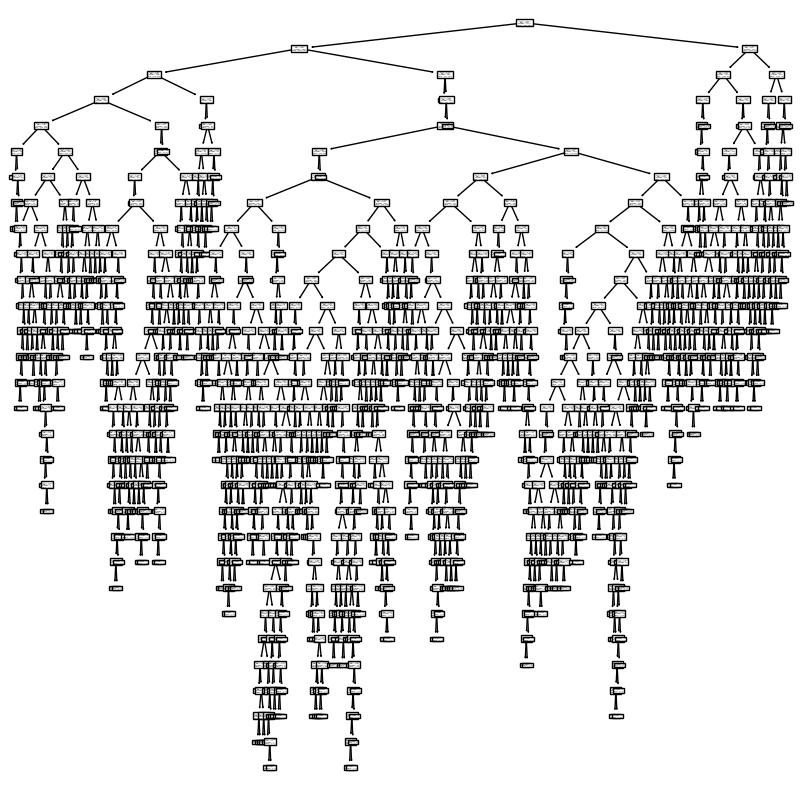

In [ ]:
plt.subplots(1,1,figsize=(10,10))
_= tree.plot_tree(modelo_c5)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas derivadas de la matriz de confusión.

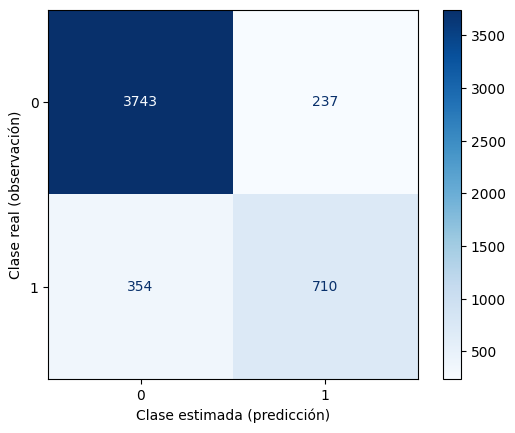

In [ ]:
#Matriz de Confusion
matriz = confusion_matrix(Ytest, Y_hat)

grafico = ConfusionMatrixDisplay(confusion_matrix=matriz,display_labels=modelo_c5.classes_)
grafico.plot(cmap=plt.cm.Blues,values_format='g')
plt.xlabel('Clase estimada (predicción)')
plt.ylabel('Clase real (observación)')
plt.show()

In [ ]:
VN, FP, FN, VP = matriz.ravel()
print(f'Verdaderos positivos (VP): {VP}')
print(f'Falsos positivos (FP): {FP}')
print(f'Verdaderos negativos (VN): {VN}')
print(f'Falsos negativos (FN): {FN}')

Verdaderos positivos (VP): 710
Falsos positivos (FP): 237
Verdaderos negativos (VN): 3743
Falsos negativos (FN): 354


In [ ]:
#Tasa de error
Tasa_FP_5 = FP/(FP+VN)
Tasa_FN_5 = FN/(FN+VP)

print("Error tipo I: %.2f" % Tasa_FP_5 )
print("Error tipo II: %.2f" % Tasa_FN_5 )

Error tipo I: 0.06
Error tipo II: 0.33


In [ ]:
#Metricas
print(classification_report(Ytest, Y_hat))

              precision    recall  f1-score   support

           0       0.91      0.94      0.93      3980
           1       0.75      0.67      0.71      1064

    accuracy                           0.88      5044
   macro avg       0.83      0.80      0.82      5044
weighted avg       0.88      0.88      0.88      5044



In [ ]:
#Accuracy
SCORE_5 = accuracy_score(Ytest,Y_hat)
print("ACCURACY: %.2f" % SCORE_5 )

#F1-Score
f1_5 = f1_score(Ytest, Y_hat)
print("F1-Score: %.2f" % f1_5 )

ACCURACY: 0.88
F1-Score: 0.71


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 6**

✅ Paso 1 - Definición de Variables: Utilizamos las variables $X$ e $Y$ previamente definidas, normalizadas y divididas en conjunto de entrenamiento y test.

➡️`Tuning`: Mejoramos el modelo haciendo una sintonizacion (tuning), donde se modifican los hiperparámetros del modelo con el fin de mejorarlo. Los hiperparámetros son configuraciones que se establecen antes de entrenar el modelo y afectan el proceso de aprendizaje, pero no son aprendidos directamente del conjunto de datos durante el entrenamiento, por lo que deben ser introducidas manualmente.

✅ Paso 2 - Modelo: Creación del modelo de Árbol de Clasificación.

In [ ]:
modelo_c6 = DecisionTreeClassifier(max_depth=10, min_samples_split =3, min_samples_leaf=2, class_weight='balanced', random_state=123)

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain normalizada y Ytrain.

In [ ]:
modelo_c6.fit(Xtrain_sc, Ytrain)

DecisionTreeClassifier(class_weight='balanced', max_depth=10,
                       min_samples_leaf=2, min_samples_split=3,
                       random_state=123)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest normalizada. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_c6.predict(Xtest_sc)

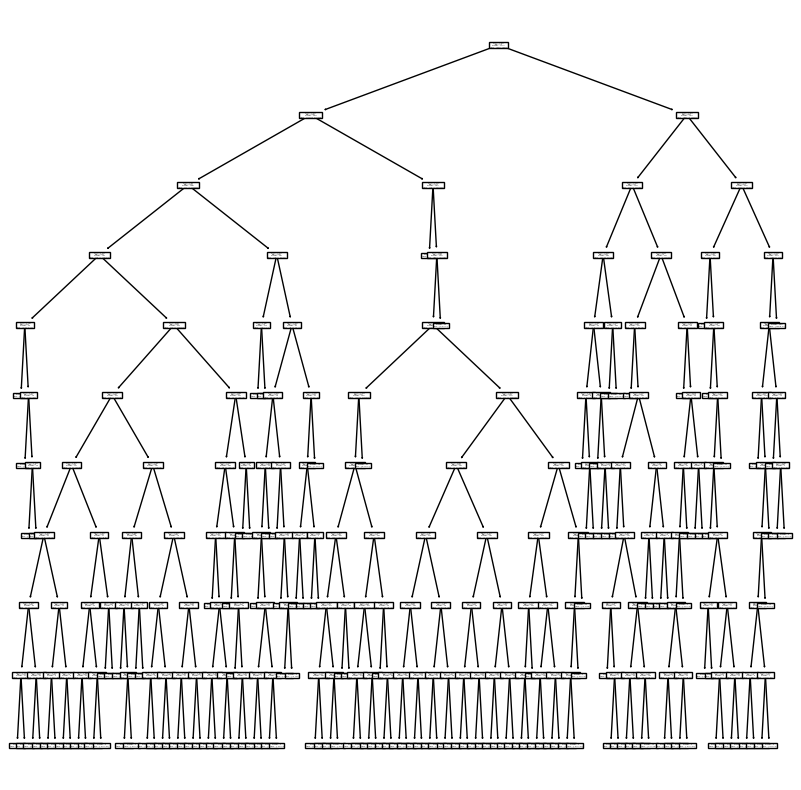

In [ ]:
#Grafico
plt.subplots(1,1,figsize=(10,10))
_= tree.plot_tree(modelo_c6)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas derivadas de la matriz de confusión.

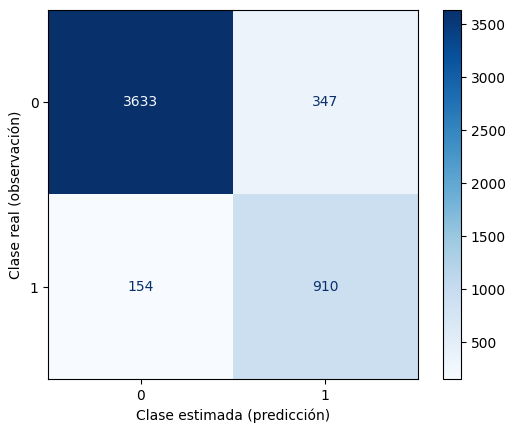

In [ ]:
#Matriz de Confusion
matriz = confusion_matrix(Ytest, Y_hat)

grafico = ConfusionMatrixDisplay(confusion_matrix=matriz,display_labels=modelo_c6.classes_)
grafico.plot(cmap=plt.cm.Blues,values_format='g')
plt.xlabel('Clase estimada (predicción)')
plt.ylabel('Clase real (observación)')
plt.show()

In [ ]:
VN, FP, FN, VP = matriz.ravel()
print(f'Verdaderos positivos (VP): {VP}')
print(f'Falsos positivos (FP): {FP}')
print(f'Verdaderos negativos (VN): {VN}')
print(f'Falsos negativos (FN): {FN}')

Verdaderos positivos (VP): 910
Falsos positivos (FP): 347
Verdaderos negativos (VN): 3633
Falsos negativos (FN): 154


In [ ]:
#Tasa de error
Tasa_FP_6 = FP/(FP+VN)
Tasa_FN_6 = FN/(FN+VP)

print("Error tipo I: %.2f" % Tasa_FP_6 )
print("Error tipo II: %.2f" % Tasa_FN_6 )

Error tipo I: 0.09
Error tipo II: 0.14


In [ ]:
#Metricas
print(classification_report(Ytest, Y_hat))

              precision    recall  f1-score   support

           0       0.96      0.91      0.94      3980
           1       0.72      0.86      0.78      1064

    accuracy                           0.90      5044
   macro avg       0.84      0.88      0.86      5044
weighted avg       0.91      0.90      0.90      5044



In [ ]:
#Accuracy
SCORE_6 = modelo_c6.score(Xtest_sc,Ytest)
print("ACCURACY: %.2f" % SCORE_6)

#F1-Score
f1_6 = f1_score(Ytest, Y_hat)
print("F1-Score: %.2f" % f1_6)

ACCURACY: 0.90
F1-Score: 0.78


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 7**

✅ Paso 1 - Definición de Variables: Utilizamos las variables $X$ e $Y$ previamente definidas, normalizadas y divididas en conjunto de entrenamiento y test.

✅ Paso 2 - Modelo: Creación del modelo de Árbol de Clasificación.

Probar manualmente ajustando todos los hiperparámetros hasta encontrar los valores óptimos puede tomar mucho tiempo, por lo que es mejor utilizar un algoritmo que ayude a encontrar la mejor combinación de éstos.

➡️ `GridSearchCV`: Método para realizar una búsqueda de los hiperparámetros del modelo. Es una técnica de validación cruzada que se ejecuta a través de los diferentes hiperparámetros que se introducen en la cuadrícula de hiperparámetros (matriz o grilla) y extrae los mejores valores y combinaciones de éstos.

In [ ]:
# Definir el espacio de búsqueda de hiperparámetros
param_grid = {
    'criterion': ['gini', 'entropy'],
    'splitter': ['best', 'random'],
    'max_depth': [None,5,6,7,8,9,10,11,12,13,14,15],
    'min_samples_split': [2,3,4,5],
    'min_samples_leaf': [1,2,3,4],
    'max_features': ['auto', 'sqrt', 'log2']
}

# Crear el modelo base con class_weight='balanced'
modelo = DecisionTreeClassifier(class_weight='balanced', random_state=123)

# Inicializar Grid Search con validación cruzada (CV) estratificada
grid_search = GridSearchCV(estimator=modelo, param_grid=param_grid, scoring='accuracy')

# Ajustar Grid Search a los datos de entrenamiento
grid_search.fit(Xtrain_sc, Ytrain)

# Obtener los mejores hiperparámetros
best_params = grid_search.best_params_
print("Mejores hiperparámetros encontrados:")
best_params

Mejores hiperparámetros encontrados:


{'criterion': 'gini',
 'max_depth': 15,
 'max_features': 'auto',
 'min_samples_leaf': 1,
 'min_samples_split': 4,
 'splitter': 'best'}

In [ ]:
#modelo_c7 = DecisionTreeClassifier(**best_params, class_weight='balanced', random_state=123)
modelo_c7 = DecisionTreeClassifier(criterion='gini', max_depth=15, max_features='auto',
                                   min_samples_leaf=1, min_samples_split=4, splitter='best',
                                   class_weight='balanced', random_state=123)

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain normalizada y Ytrain.

In [ ]:
modelo_c7.fit(Xtrain_sc, Ytrain)

DecisionTreeClassifier(class_weight='balanced', max_depth=15,
                       max_features='auto', min_samples_split=4,
                       random_state=123)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest normalizada. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_c7.predict(Xtest_sc)

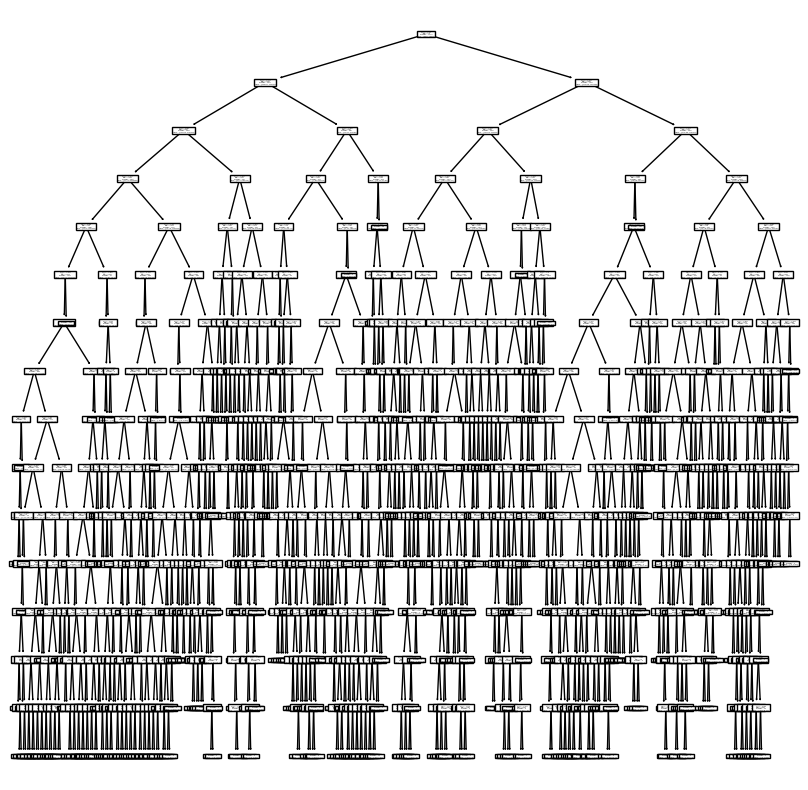

In [ ]:
#Grafico
plt.subplots(1,1,figsize=(10,10))
_= tree.plot_tree(modelo_c7)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas derivadas de la matriz de confusión.

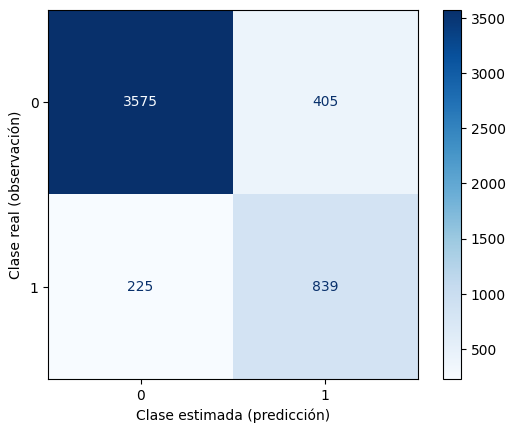

In [ ]:
#Matriz de Confusion
matriz = confusion_matrix(Ytest, Y_hat)

grafico = ConfusionMatrixDisplay(confusion_matrix=matriz,display_labels=modelo_c7.classes_)
grafico.plot(cmap=plt.cm.Blues,values_format='g')
plt.xlabel('Clase estimada (predicción)')
plt.ylabel('Clase real (observación)')
plt.show()

In [ ]:
VN, FP, FN, VP = matriz.ravel()
print(f'Verdaderos positivos (VP): {VP}')
print(f'Falsos positivos (FP): {FP}')
print(f'Verdaderos negativos (VN): {VN}')
print(f'Falsos negativos (FN): {FN}')

Verdaderos positivos (VP): 839
Falsos positivos (FP): 405
Verdaderos negativos (VN): 3575
Falsos negativos (FN): 225


In [ ]:
#Tasa de error
Tasa_FP_7 = FP/(FP+VN)
Tasa_FN_7 = FN/(FN+VP)

print("Error tipo I: %.2f" % Tasa_FP_7 )
print("Error tipo II: %.2f" % Tasa_FN_7 )

Error tipo I: 0.10
Error tipo II: 0.21


In [ ]:
#Metricas
print(classification_report(Ytest, Y_hat))

              precision    recall  f1-score   support

           0       0.94      0.90      0.92      3980
           1       0.67      0.79      0.73      1064

    accuracy                           0.88      5044
   macro avg       0.81      0.84      0.82      5044
weighted avg       0.88      0.88      0.88      5044



In [ ]:
#Accuracy
SCORE_7 = modelo_c7.score(Xtest_sc,Ytest)
print("ACCURACY: %.2f" % SCORE_7)

#F1-Score
f1_7 = f1_score(Ytest, Y_hat)
print("F1-Score: %.2f" % f1_7)

ACCURACY: 0.88
F1-Score: 0.73


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 8**

✅ Paso 1 - Definición de Variables: Utilizamos las variables $X$ e $Y$ previamente definidas, normalizadas y divididas en conjunto de entrenamiento y test.

✅ Paso 2 - Modelo: Creación del modelo de Árbol de Clasificación.

➡️ `BayesSearchCV()`: Se utiliza para realizar una búsqueda bayesiana de hiperparámetros en modelos de aprendizaje automático. BayesSearchCV es una extensión de `GridSearchCV` y `RandomizedSearchCV`, pero utiliza un enfoque de optimización bayesiana más avanzado para explorar el espacio de hiperparámetros de manera eficiente.

In [ ]:
pip install scikit-optimize

In [ ]:
from skopt import BayesSearchCV

In [ ]:
# Define el espacio de búsqueda de hiperparámetros
param_space = {
    'criterion': ['gini', 'entropy'],
    'splitter': ['best', 'random'],
    'max_depth': [None,5,6,7,8,9,10,11,12,13,14,15],
    'min_samples_split': [2,3,4,5],
    'min_samples_leaf': [1,2,3,4],
    'max_features': ['auto', 'sqrt', 'log2']
}

# Crear el modelo base con class_weight='balanced'
modelo = DecisionTreeClassifier(class_weight='balanced', random_state=123)

# Realiza la búsqueda bayesiana de hiperparámetros
bayes = BayesSearchCV(
    modelo,
    param_space,
    n_iter=30,  # Número de iteraciones de la búsqueda bayesiana
    cv=5,  # Número de divisiones para la validación cruzada
    n_jobs=-1,  # Utiliza todos los núcleos del procesador
    verbose=0  # Nivel de verbosidad
)

# Ajusta el modelo con los mejores hiperparámetros encontrados
bayes.fit(Xtrain_sc, Ytrain)

# Muestra los mejores hiperparámetros encontrados
print("Mejores hiperparámetros:")
print(bayes.best_params_)


Mejores hiperparámetros:
OrderedDict([('criterion', 'gini'), ('max_depth', 12), ('max_features', 'sqrt'), ('min_samples_leaf', 1), ('min_samples_split', 4), ('splitter', 'best')])


In [ ]:
#modelo_c8 = DecisionTreeClassifier(**best_params, class_weight='balanced', random_state=123)
modelo_c8 = DecisionTreeClassifier(criterion='gini', max_depth=12, max_features='sqrt',
                                   min_samples_leaf=1, min_samples_split=4, splitter='best',
                                   class_weight='balanced', random_state=123)

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain normalizada y Ytrain.

In [ ]:
modelo_c8.fit(Xtrain_sc, Ytrain)

DecisionTreeClassifier(class_weight='balanced', max_depth=12,
                       max_features='sqrt', min_samples_split=4,
                       random_state=123)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest normalizada. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_c8.predict(Xtest_sc)

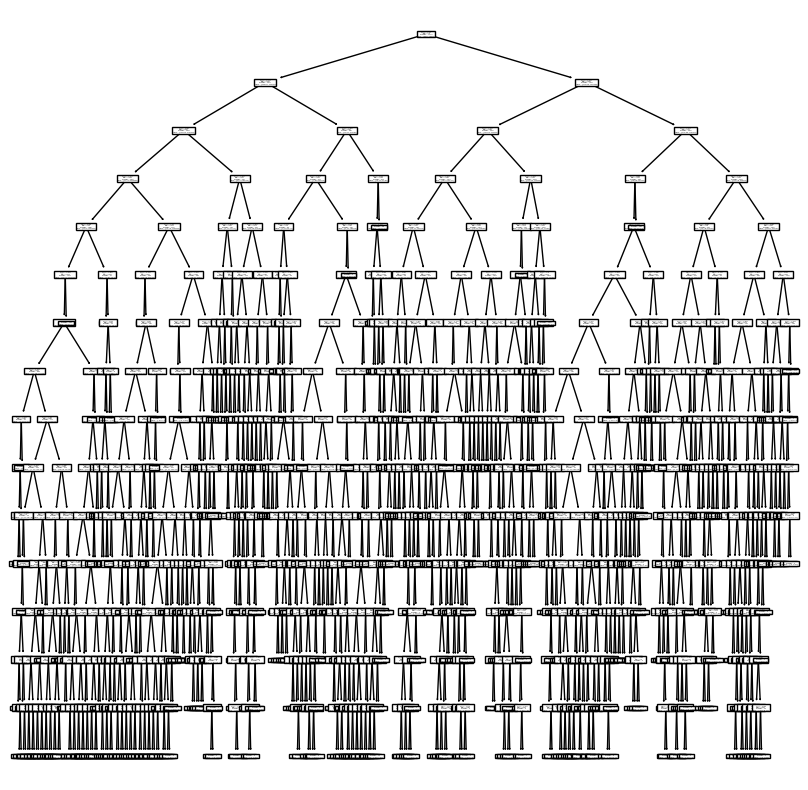

In [ ]:
#Grafico
plt.subplots(1,1,figsize=(10,10))
_= tree.plot_tree(modelo_c8)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas derivadas de la matriz de confusión.

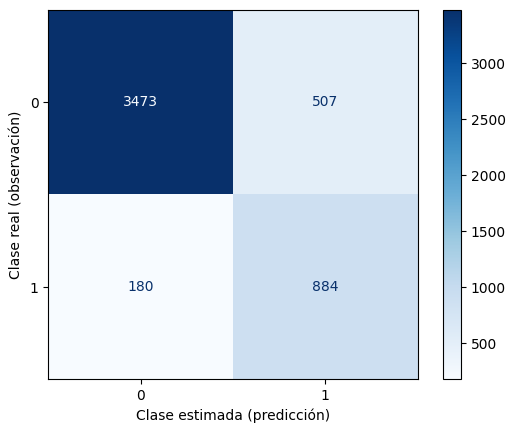

In [ ]:
#Matriz de Confusion
matriz = confusion_matrix(Ytest, Y_hat)

grafico = ConfusionMatrixDisplay(confusion_matrix=matriz,display_labels=modelo_c8.classes_)
grafico.plot(cmap=plt.cm.Blues,values_format='g')
plt.xlabel('Clase estimada (predicción)')
plt.ylabel('Clase real (observación)')
plt.show()

In [ ]:
VN, FP, FN, VP = matriz.ravel()
print(f'Verdaderos positivos (VP): {VP}')
print(f'Falsos positivos (FP): {FP}')
print(f'Verdaderos negativos (VN): {VN}')
print(f'Falsos negativos (FN): {FN}')

Verdaderos positivos (VP): 884
Falsos positivos (FP): 507
Verdaderos negativos (VN): 3473
Falsos negativos (FN): 180


In [ ]:
#Tasa de error
Tasa_FP_8 = FP/(FP+VN)
Tasa_FN_8 = FN/(FN+VP)

print("Error tipo I: %.2f" % Tasa_FP_8 )
print("Error tipo II: %.2f" % Tasa_FN_8 )

Error tipo I: 0.13
Error tipo II: 0.17


In [ ]:
#Metricas
print(classification_report(Ytest, Y_hat))

              precision    recall  f1-score   support

           0       0.95      0.87      0.91      3980
           1       0.64      0.83      0.72      1064

    accuracy                           0.86      5044
   macro avg       0.79      0.85      0.82      5044
weighted avg       0.88      0.86      0.87      5044



In [ ]:
#Accuracy
SCORE_8 = modelo_c8.score(Xtest_sc,Ytest)
print("ACCURACY: %.2f" % SCORE_8)

#F1-Score
f1_8 = f1_score(Ytest, Y_hat)
print("F1-Score: %.2f" % f1_8)

ACCURACY: 0.86
F1-Score: 0.72


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

###**3. K-Nearest Neighbors (KNN)**

➡️ `KNeighborsClassifier()`: Se utiliza para clasificar puntos de datos en función de la mayoría de las clases a las que pertenecen sus vecinos más cercanos en el espacio de características.

Parámetros (sci-kit learn):

> ●   `n_neighbors`:  Define el número de vecinos cercanos (k) que se utilizarán para hacer predicciones. Valores más pequeños de "k" pueden llevar a un modelo más sensible al ruido, mientras que valores más grandes pueden suavizar la decisión, pero podrían perder detalles. (predeterminado = 5)

> ●   `metric`: Especifica la métrica de distancia utilizada para medir la similitud entre los puntos de datos. Algunas opciones comunes incluyen 'euclidean', 'manhattan', 'chebyshev', 'minkowski', y 'hamming', entre otras. (predeterminado = 'minkowski')

> ●   `p`: Controla la potencia en la métrica de Minkowski. Cuando p = 2, se utiliza la distancia euclidiana; cuando p = 1, se utiliza la distancia de Manhattan. Valores más bajos de p dan más peso a las diferencias individuales en las características, mientras que valores más altos de p dan menos peso a las diferencias individuales y tienden a considerarlas más uniformemente.(predeterminado = 2)

> ●   `weights`: Controla cómo se ponderan las contribuciones de los vecinos al hacer una predicción. Puede tomar dos valores principales: 'uniform' donde todos los vecinos tienen el mismo peso en la predicción y 'distance' donde los vecinos más cercanos tienen un mayor peso en la predicción que los vecinos más lejanos, y el peso se calcula en función de la inversa de la distancia. (predeterminado = 'uniform')

> ●   `algorithm`: Controla el algoritmo utilizado para calcular los vecinos más cercanos. Los valores posibles incluyen 'auto', 'ball_tree', 'kd_tree' y 'brute'. El valor predeterminado es 'auto', que selecciona el algoritmo más adecuado automáticamente según el tamaño y la naturaleza del conjunto de datos.(predeterminado = 'auto')

####**Modelo 9**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo KNN.

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

In [ ]:
modelo_c9 = KNeighborsClassifier(n_neighbors=3)

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_c9.fit(Xtrain_sc, Ytrain)

KNeighborsClassifier(n_neighbors=3)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_c9.predict(Xtest_sc)

Con este modelo se predece el precio de una casa basado en las características de casas similares cercanas.

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas derivadas de la matriz de confusión.

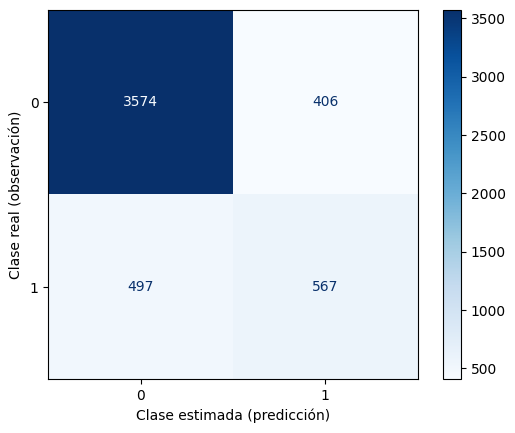

In [ ]:
#Matriz de Confusion
matriz = confusion_matrix(Ytest, Y_hat)

grafico = ConfusionMatrixDisplay(confusion_matrix=matriz,display_labels=modelo_c9.classes_)
grafico.plot(cmap=plt.cm.Blues,values_format='g')
plt.xlabel('Clase estimada (predicción)')
plt.ylabel('Clase real (observación)')
plt.show()

In [ ]:
VN, FP, FN, VP = matriz.ravel()
print(f'Verdaderos positivos (VP): {VP}')
print(f'Falsos positivos (FP): {FP}')
print(f'Verdaderos negativos (VN): {VN}')
print(f'Falsos negativos (FN): {FN}')

Verdaderos positivos (VP): 567
Falsos positivos (FP): 406
Verdaderos negativos (VN): 3574
Falsos negativos (FN): 497


In [ ]:
#Tasa de error
Tasa_FP_9 = FP/(FP+VN)
Tasa_FN_9 = FN/(FN+VP)

print("Error tipo I: %.2f" % Tasa_FP_9 )
print("Error tipo II: %.2f" % Tasa_FN_9 )

Error tipo I: 0.10
Error tipo II: 0.47


In [ ]:
#Metricas
print(classification_report(Ytest, Y_hat))

              precision    recall  f1-score   support

           0       0.88      0.90      0.89      3980
           1       0.58      0.53      0.56      1064

    accuracy                           0.82      5044
   macro avg       0.73      0.72      0.72      5044
weighted avg       0.82      0.82      0.82      5044



In [ ]:
#Accuracy
SCORE_9 = modelo_c9.score(Xtest_sc,Ytest)
print("ACCURACY: %.2f" % SCORE_9)

#F1-Score
f1_9 = f1_score(Ytest, Y_hat)
print("F1-Score: %.2f" % f1_9)

ACCURACY: 0.82
F1-Score: 0.56


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 10**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo KNN.

In [ ]:
modelo_c10 = KNeighborsClassifier(n_neighbors=10, p=1, weights='distance')

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_c10.fit(Xtrain_sc, Ytrain)

KNeighborsClassifier(n_neighbors=10, p=1, weights='distance')

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

Se pone a prueba el modelo realizando una predicción con datos fuera de la muestra (out-of-sample).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_c10.predict(Xtest_sc)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

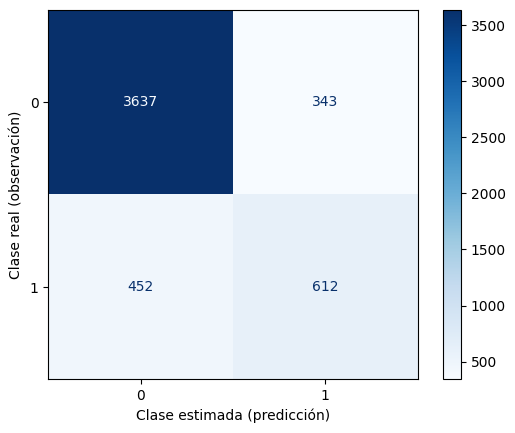

In [ ]:
#Matriz de Confusion
matriz = confusion_matrix(Ytest, Y_hat)

grafico = ConfusionMatrixDisplay(confusion_matrix=matriz,display_labels=modelo_c10.classes_)
grafico.plot(cmap=plt.cm.Blues,values_format='g')
plt.xlabel('Clase estimada (predicción)')
plt.ylabel('Clase real (observación)')
plt.show()

In [ ]:
VN, FP, FN, VP = matriz.ravel()
print(f'Verdaderos positivos (VP): {VP}')
print(f'Falsos positivos (FP): {FP}')
print(f'Verdaderos negativos (VN): {VN}')
print(f'Falsos negativos (FN): {FN}')

Verdaderos positivos (VP): 612
Falsos positivos (FP): 343
Verdaderos negativos (VN): 3637
Falsos negativos (FN): 452


In [ ]:
#Tasa de error
Tasa_FP_10 = FP/(FP+VN)
Tasa_FN_10 = FN/(FN+VP)

print("Error tipo I: %.2f" % Tasa_FP_10)
print("Error tipo II: %.2f" % Tasa_FN_10)

Error tipo I: 0.09
Error tipo II: 0.42


In [ ]:
#Metricas
print(classification_report(Ytest, Y_hat))

              precision    recall  f1-score   support

           0       0.89      0.91      0.90      3980
           1       0.64      0.58      0.61      1064

    accuracy                           0.84      5044
   macro avg       0.77      0.74      0.75      5044
weighted avg       0.84      0.84      0.84      5044



In [ ]:
#Accuracy
SCORE_10 = modelo_c10.score(Xtest_sc,Ytest)
print("ACCURACY: %.2f" % SCORE_10)

#F1-Score
f1_10 = f1_score(Ytest, Y_hat)
print("F1-Score: %.2f" % f1_10)

ACCURACY: 0.84
F1-Score: 0.61


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 11**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo KNN.

In [ ]:
modelo_c11 = KNeighborsClassifier(n_neighbors=10, p=3, weights='distance', algorithm='brute')

'''
'brute' calcula la distancia entre todos los puntos en el conjunto de entrenamiento,
lo que puede ser extremadamente lento en conjuntos de datos grandes o de alta dimensionalidad.
El rendimiento se vuelve ineficiente a medida que el tamaño del conjunto de entrenamiento crece.
'''

"\n'brute' calcula la distancia entre todos los puntos en el conjunto de entrenamiento,\nlo que puede ser extremadamente lento en conjuntos de datos grandes o de alta dimensionalidad.\nEl rendimiento se vuelve ineficiente a medida que el tamaño del conjunto de entrenamiento crece.\n"

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_c11.fit(Xtrain_sc, Ytrain)

KNeighborsClassifier(algorithm='brute', n_neighbors=10, p=3, weights='distance')

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

Se pone a prueba el modelo realizando una predicción con datos fuera de la muestra (out-of-sample).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_c11.predict(Xtest_sc)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

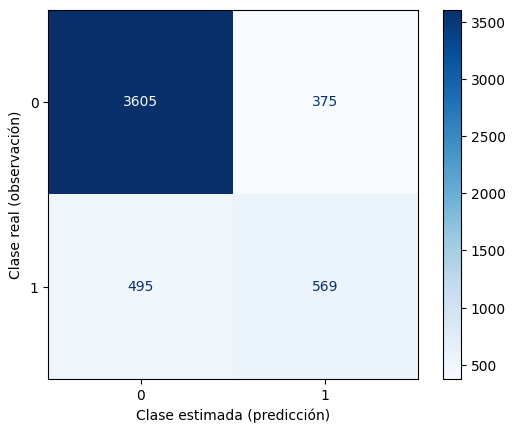

In [ ]:
#Matriz de Confusion
matriz = confusion_matrix(Ytest, Y_hat)

grafico = ConfusionMatrixDisplay(confusion_matrix=matriz,display_labels=modelo_c11.classes_)
grafico.plot(cmap=plt.cm.Blues,values_format='g')
plt.xlabel('Clase estimada (predicción)')
plt.ylabel('Clase real (observación)')
plt.show()

In [ ]:
VN, FP, FN, VP = matriz.ravel()
print(f'Verdaderos positivos (VP): {VP}')
print(f'Falsos positivos (FP): {FP}')
print(f'Verdaderos negativos (VN): {VN}')
print(f'Falsos negativos (FN): {FN}')

Verdaderos positivos (VP): 569
Falsos positivos (FP): 375
Verdaderos negativos (VN): 3605
Falsos negativos (FN): 495


In [ ]:
#Tasa de error
Tasa_FP_11 = FP/(FP+VN)
Tasa_FN_11 = FN/(FN+VP)

print("Error tipo I: %.2f" % Tasa_FP_11)
print("Error tipo II: %.2f" % Tasa_FN_11)

Error tipo I: 0.09
Error tipo II: 0.47


In [ ]:
#Metricas
print(classification_report(Ytest, Y_hat))

              precision    recall  f1-score   support

           0       0.88      0.91      0.89      3980
           1       0.60      0.53      0.57      1064

    accuracy                           0.83      5044
   macro avg       0.74      0.72      0.73      5044
weighted avg       0.82      0.83      0.82      5044



In [ ]:
#Accuracy
SCORE_11 = modelo_c11.score(Xtest_sc,Ytest)
print("ACCURACY: %.2f" % SCORE_11)

#F1-Score
f1_11 = f1_score(Ytest, Y_hat)
print("F1-Score: %.2f" % f1_11)

ACCURACY: 0.83
F1-Score: 0.57


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 12**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo KNN.

In [ ]:
# Definir la lista de hiperparámetros a probar
param_grid = {
    'n_neighbors': [2,3,5,7,9,12],  # Valores de K
    'p': [1,2,3,4,5],
    'algorithm':['auto', 'ball_tree', 'kd_tree','brute']
}

# Crear el modelo KNN
modelo = KNeighborsClassifier(weights='distance')

# Realizar la búsqueda en cuadrícula
grid_search = GridSearchCV(estimator=modelo, param_grid=param_grid, scoring='f1', cv=5)
grid_search.fit(Xtrain_sc, Ytrain)

# Obtener los mejores hiperparámetros
best_params = grid_search.best_params_
best_params

{'algorithm': 'ball_tree', 'n_neighbors': 12, 'p': 1}

In [ ]:
#modelo_c12 = KNeighborsClassifier(**best_params, weights='distance')
modelo_c12 = KNeighborsClassifier(algorithm='ball_tree',n_neighbors=12,
                                  p=1, weights='distance')

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_c12.fit(Xtrain_sc, Ytrain)

KNeighborsClassifier(algorithm='ball_tree', n_neighbors=12, p=1,
                     weights='distance')

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

Se pone a prueba el modelo realizando una predicción con datos fuera de la muestra (out-of-sample).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_c12.predict(Xtest_sc)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

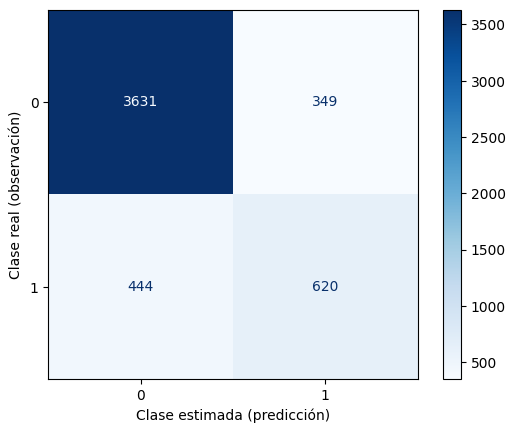

In [ ]:
#Matriz de Confusion
matriz = confusion_matrix(Ytest, Y_hat)

grafico = ConfusionMatrixDisplay(confusion_matrix=matriz,display_labels=modelo_c12.classes_)
grafico.plot(cmap=plt.cm.Blues,values_format='g')
plt.xlabel('Clase estimada (predicción)')
plt.ylabel('Clase real (observación)')
plt.show()

In [ ]:
VN, FP, FN, VP = matriz.ravel()
print(f'Verdaderos positivos (VP): {VP}')
print(f'Falsos positivos (FP): {FP}')
print(f'Verdaderos negativos (VN): {VN}')
print(f'Falsos negativos (FN): {FN}')

Verdaderos positivos (VP): 620
Falsos positivos (FP): 349
Verdaderos negativos (VN): 3631
Falsos negativos (FN): 444


In [ ]:
#Tasa de error
Tasa_FP_12 = FP/(FP+VN)
Tasa_FN_12 = FN/(FN+VP)

print("Error tipo I: %.2f" % Tasa_FP_12)
print("Error tipo II: %.2f" % Tasa_FN_12)

Error tipo I: 0.09
Error tipo II: 0.42


In [ ]:
#Metricas
print(classification_report(Ytest, Y_hat))

              precision    recall  f1-score   support

           0       0.89      0.91      0.90      3980
           1       0.64      0.58      0.61      1064

    accuracy                           0.84      5044
   macro avg       0.77      0.75      0.76      5044
weighted avg       0.84      0.84      0.84      5044



In [ ]:
#Accuracy
SCORE_12 = modelo_c12.score(Xtest_sc,Ytest)
print("ACCURACY: %.2f" % SCORE_12)

#F1-Score
f1_12 = f1_score(Ytest, Y_hat)
print("F1-Score: %.2f" % f1_12)

ACCURACY: 0.84
F1-Score: 0.61


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

###**4. Random Forest**

➡️ `RandomForestClassifier()`:  Se basa en el concepto de "ensamblaje de árboles" y pertenece a la categoría de métodos de ensamblaje, lo que significa que combina múltiples modelos de árbol de decisión para mejorar la precisión y la robustez del modelo.

Parámetros:

> ●   `n_estimators`:  Controla el número de árboles en el bosque. Un valor mayor generalmente mejora la calidad del modelo, pero también puede aumentar el costo computacional. Debes ajustarlo según tus necesidades, pero valores típicos suelen oscilar entre 50 y 500. (predeterminado=100)

> ●   `criterion`:  Define la función utilizada para medir la calidad de una división en un árbol. Puede ser 'gini' para el índice de Gini o 'entropy' para la ganancia de información. Ambas métricas miden la pureza de las divisiones. (predeterminado='gini')

> ●   `max_depth`:  Controla la profundidad máxima de cada árbol en el bosque. Limitar la profundidad puede ayudar a prevenir el sobreajuste (overfitting). Si no se establece un valor, los árboles se expandirán hasta que todas las hojas contengan un número mínimo de muestras (controlado por min_samples_split o min_samples_leaf), es decir que no hay una restriccion en la profundidad de cada árbol (None). Ajustar max_depth es útil para controlar la complejidad del modelo. (predeterminado=None)

> ●   `min_samples_split`:  Define el número mínimo de muestras requeridas para dividir un nodo interno de cada árbol. Si un nodo tiene menos de este número de muestras, no se dividirá más. Ajustar este valor puede ayudar a controlar el sobreajuste. (predeterminado=2)

> ●   `min_samples_leaf`:  Establece el número mínimo de muestras requeridas en una hoja (nodo terminal) de cada árbol. Similar a min_samples_split, este parámetro controla el sobreajuste regulando la cantidad de datos necesarios en cada hoja. (predeterminado=1)

> ●   `max_features`:  Controla la cantidad de características que se consideran al buscar la mejor división en cada nodo de cada árbol. Se puede establecer como un número entero (el número exacto de características a considerar) o como una fracción (por ejemplo, "sqrt" para la raíz cuadrada del número total de características). La elección de características aleatorias en cada división ayuda a reducir la correlación entre los árboles y mejora la generalización. (predeterminado='auto')

> ●   `class_weight`: Puede ser utilizado para asignar pesos a las clases en el modelo, útil cuando las clases están desequilibradas, en ese caso se usa 'balanced'. (predeterminado=None)

> ●   `bootstrap`: Indica si se deben tomar muestras con reemplazo al construir árboles individuales en el bosque. Si es True, se utiliza el muestreo con reemplazo (bootstrap). Si es False, se utiliza el muestreo sin reemplazo. (predeterminado=True)

> ●   `random_state`:  Permite establecer una semilla para la generación de números aleatorios, lo que garantiza reproducibilidad en los resultados.

####**Modelo 13**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo Random Forest.

In [ ]:
from sklearn.ensemble import RandomForestClassifier

In [ ]:
modelo_c13 = RandomForestClassifier(n_estimators=50, max_depth=10)

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_c13.fit(Xtrain_sc, Ytrain)

RandomForestClassifier(max_depth=10, n_estimators=50)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_c13.predict(Xtest_sc)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

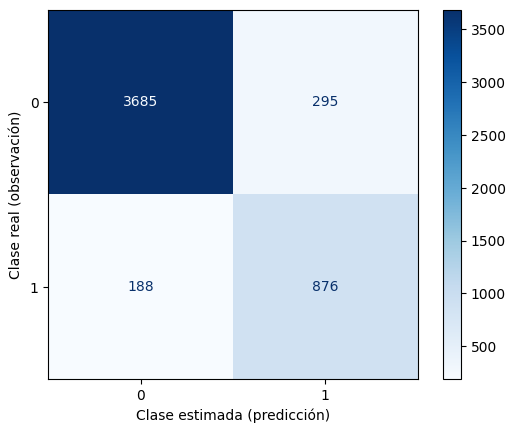

In [ ]:
#Matriz de Confusion
matriz = confusion_matrix(Ytest, Y_hat)

grafico = ConfusionMatrixDisplay(confusion_matrix=matriz,display_labels=modelo_c13.classes_)
grafico.plot(cmap=plt.cm.Blues,values_format='g')
plt.xlabel('Clase estimada (predicción)')
plt.ylabel('Clase real (observación)')
plt.show()

In [ ]:
VN, FP, FN, VP = matriz.ravel()
print(f'Verdaderos positivos (VP): {VP}')
print(f'Falsos positivos (FP): {FP}')
print(f'Verdaderos negativos (VN): {VN}')
print(f'Falsos negativos (FN): {FN}')

Verdaderos positivos (VP): 876
Falsos positivos (FP): 295
Verdaderos negativos (VN): 3685
Falsos negativos (FN): 188


In [ ]:
#Tasa de error
Tasa_FP_13 = FP/(FP+VN)
Tasa_FN_13 = FN/(FN+VP)

print("Error tipo I: %.2f" % Tasa_FP_13)
print("Error tipo II: %.2f" % Tasa_FN_13)

Error tipo I: 0.07
Error tipo II: 0.18


In [ ]:
#Metricas
print(classification_report(Ytest, Y_hat))

              precision    recall  f1-score   support

           0       0.95      0.93      0.94      3980
           1       0.75      0.82      0.78      1064

    accuracy                           0.90      5044
   macro avg       0.85      0.87      0.86      5044
weighted avg       0.91      0.90      0.91      5044



In [ ]:
#Accuracy
SCORE_13 = modelo_c13.score(Xtest_sc,Ytest)
print("ACCURACY: %.2f" % SCORE_13)

#F1-Score
f1_13 = f1_score(Ytest, Y_hat)
print("F1-Score: %.2f" % f1_13)

ACCURACY: 0.90
F1-Score: 0.78


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 14**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo Random Forest.

In [ ]:
modelo_c14 = RandomForestClassifier(n_estimators=50, max_depth=10, min_samples_split=2,min_samples_leaf=2,class_weight='balanced')

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_c14.fit(Xtrain_sc, Ytrain)

RandomForestClassifier(class_weight='balanced', max_depth=10,
                       min_samples_leaf=2, n_estimators=50)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_c14.predict(Xtest_sc)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

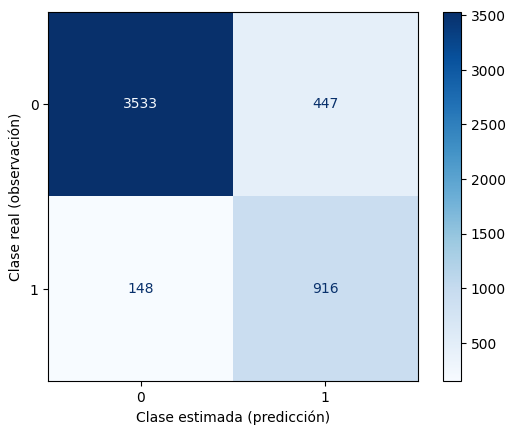

In [ ]:
#Matriz de Confusion
matriz = confusion_matrix(Ytest, Y_hat)

grafico = ConfusionMatrixDisplay(confusion_matrix=matriz,display_labels=modelo_c14.classes_)
grafico.plot(cmap=plt.cm.Blues,values_format='g')
plt.xlabel('Clase estimada (predicción)')
plt.ylabel('Clase real (observación)')
plt.show()

In [ ]:
VN, FP, FN, VP = matriz.ravel()
print(f'Verdaderos positivos (VP): {VP}')
print(f'Falsos positivos (FP): {FP}')
print(f'Verdaderos negativos (VN): {VN}')
print(f'Falsos negativos (FN): {FN}')

Verdaderos positivos (VP): 916
Falsos positivos (FP): 447
Verdaderos negativos (VN): 3533
Falsos negativos (FN): 148


In [ ]:
#Tasa de error
Tasa_FP_14 = FP/(FP+VN)
Tasa_FN_14 = FN/(FN+VP)

print("Error tipo I: %.2f" % Tasa_FP_14)
print("Error tipo II: %.2f" % Tasa_FN_14)

Error tipo I: 0.11
Error tipo II: 0.14


In [ ]:
#Metricas
print(classification_report(Ytest, Y_hat))

              precision    recall  f1-score   support

           0       0.96      0.89      0.92      3980
           1       0.67      0.86      0.75      1064

    accuracy                           0.88      5044
   macro avg       0.82      0.87      0.84      5044
weighted avg       0.90      0.88      0.89      5044



In [ ]:
#Accuracy
SCORE_14 = modelo_c14.score(Xtest_sc,Ytest)
print("ACCURACY: %.2f" % SCORE_14)

#F1-Score
f1_14 = f1_score(Ytest, Y_hat)
print("F1-Score: %.2f" % f1_14)

ACCURACY: 0.88
F1-Score: 0.75


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 15**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo Random Forest.

In [ ]:
# Ajuste de hiperparámetros utilizando GridSearchCV
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 5, 10, 20],
    'min_samples_split': [2, 3, 5,7],
    'min_samples_leaf': [1, 2, 3, 4],
    'max_features': ['auto', 'sqrt', 'log2']
}

# Crear una instancia del modelo Random Forest
modelo = RandomForestClassifier(class_weight='balanced', random_state=123)

# Utilizar GridSearchCV para encontrar la mejor combinación de hiperparámetros
grid_search = GridSearchCV(estimator=modelo, param_grid=param_grid, cv=5, scoring='f1')
grid_search.fit(Xtrain, Ytrain)

# Obtener la mejor combinación de hiperparámetros
mejores_parametros = grid_search.best_params_
mejores_parametros

{'max_depth': None,
 'max_features': 'auto',
 'min_samples_leaf': 2,
 'min_samples_split': 7,
 'n_estimators': 100}

In [ ]:
# Crear un modelo Random Forest con los mejores parámetros
modelo_c15 = RandomForestClassifier(**mejores_parametros, class_weight='balanced')

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_c15.fit(Xtrain_sc, Ytrain)

RandomForestClassifier(class_weight='balanced', max_features='auto',
                       min_samples_leaf=2, min_samples_split=7)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_c15.predict(Xtest_sc)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

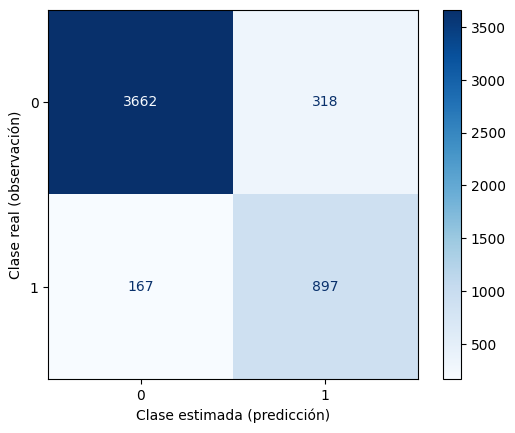

In [ ]:
#Matriz de Confusion
matriz = confusion_matrix(Ytest, Y_hat)

grafico = ConfusionMatrixDisplay(confusion_matrix=matriz,display_labels=modelo_c15.classes_)
grafico.plot(cmap=plt.cm.Blues,values_format='g')
plt.xlabel('Clase estimada (predicción)')
plt.ylabel('Clase real (observación)')
plt.show()

In [ ]:
VN, FP, FN, VP = matriz.ravel()
print(f'Verdaderos positivos (VP): {VP}')
print(f'Falsos positivos (FP): {FP}')
print(f'Verdaderos negativos (VN): {VN}')
print(f'Falsos negativos (FN): {FN}')

Verdaderos positivos (VP): 897
Falsos positivos (FP): 318
Verdaderos negativos (VN): 3662
Falsos negativos (FN): 167


In [ ]:
#Tasa de error
Tasa_FP_15 = FP/(FP+VN)
Tasa_FN_15 = FN/(FN+VP)

print("Error tipo I: %.2f" % Tasa_FP_15)
print("Error tipo II: %.2f" % Tasa_FN_15)

Error tipo I: 0.08
Error tipo II: 0.16


In [ ]:
#Metricas
print(classification_report(Ytest, Y_hat))

              precision    recall  f1-score   support

           0       0.96      0.92      0.94      3980
           1       0.74      0.84      0.79      1064

    accuracy                           0.90      5044
   macro avg       0.85      0.88      0.86      5044
weighted avg       0.91      0.90      0.91      5044



In [ ]:
#Accuracy
SCORE_15 = modelo_c15.score(Xtest_sc,Ytest)
print("ACCURACY: %.2f" % SCORE_15)

#F1-Score
f1_15 = f1_score(Ytest, Y_hat)
print("F1-Score: %.2f" % f1_15)

ACCURACY: 0.90


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

###**5. Support Vector Machines (SVM)**

➡️ `SVC()`: Máquinas de Soporte Vectorial de Clasificación se utiliza para clasificar puntos de datos en dos o más clases, encontrando el hiperplano que mejor separa las clases en el espacio de características.

Parámetros:

> ●   `kernel`:  especifica el tipo de kernel a utilizar en el modelo SVR. Algunas opciones comunes son 'linear' (kernel lineal), 'poly' (kernel polinómico), 'rbf' (kernel radial), entre otros. Un kernel es una función matemática que se utiliza para transformar los datos de entrada desde un espacio de características original a un espacio de características de mayor dimensión. (predeterminado='rbf')

> ●   `degree`:  Solo se utiliza cuando kernel='poly'. Controla el grado del polinomio para el núcleo polinómico. (predeterminado=3)

> ●   `C`: Controla el término de regularización en SVR. Determina el equilibrio entre la maximización del margen y la minimización del error de regresión. Valores más grandes de C permiten un margen más pequeño pero pueden reducir el error de entrenamiento, lo que podría llevar a un sobreajuste. (predeterminado=1.0)

> ●   `gamma`: Este parámetro es relevante solo para algunos kernels, como el kernel 'rbf' (radial basis function) y el kernel 'poly' (polinómico). Controla la influencia de los puntos de datos en la función de decisión. Valores más pequeños de gamma dan como resultado una función de decisión más suave, mientras que valores más grandes hacen que la función sea más sensible a los puntos de datos cercanos. (predeterminado= 'scale' (valor que depende de la escala de las características) para 'rbf' y 'auto' (1/n_features) para 'poly' y 'sigmoid'.)

> ●   `coef0`: Solo se utiliza en los núcleos 'poly' y 'sigmoid'. Controla la constante independiente en estas funciones de kernel. (predeterminado=0)

> ●   `class_weight`: Permite asignar pesos a las clases para manejar conjuntos de datos desbalanceados. Se establece en 'balanced' para asignar automáticamente pesos inversamente proporcionales a las frecuencias de clase en los datos de entrenamiento. (predeterminado=None)

####**Modelo 16**



✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo SVM.


In [ ]:
from sklearn.svm import SVC

In [ ]:
modelo_c16 = SVC(C=1, class_weight='balanced')

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_c16.fit(Xtrain, Ytrain)

SVC(C=1, class_weight='balanced')

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_c16.predict(Xtest)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

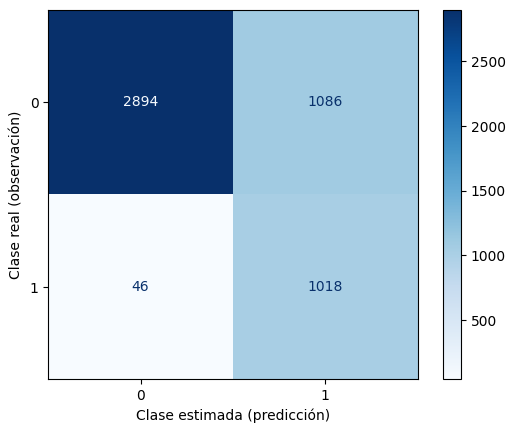

In [ ]:
#Matriz de Confusion
matriz = confusion_matrix(Ytest, Y_hat)

grafico = ConfusionMatrixDisplay(confusion_matrix=matriz,display_labels=modelo_c16.classes_)
grafico.plot(cmap=plt.cm.Blues,values_format='g')
plt.xlabel('Clase estimada (predicción)')
plt.ylabel('Clase real (observación)')
plt.show()

In [ ]:
VN, FP, FN, VP = matriz.ravel()
print(f'Verdaderos positivos (VP): {VP}')
print(f'Falsos positivos (FP): {FP}')
print(f'Verdaderos negativos (VN): {VN}')
print(f'Falsos negativos (FN): {FN}')

Verdaderos positivos (VP): 1018
Falsos positivos (FP): 1086
Verdaderos negativos (VN): 2894
Falsos negativos (FN): 46


In [ ]:
#Tasa de error
Tasa_FP_16 = FP/(FP+VN)
Tasa_FN_16 = FN/(FN+VP)

print("Error tipo I: %.2f" % Tasa_FP_16)
print("Error tipo II: %.2f" % Tasa_FN_16)

Error tipo I: 0.27
Error tipo II: 0.04


In [ ]:
#Metricas
print(classification_report(Ytest, Y_hat))

              precision    recall  f1-score   support

           0       0.98      0.73      0.84      3980
           1       0.48      0.96      0.64      1064

    accuracy                           0.78      5044
   macro avg       0.73      0.84      0.74      5044
weighted avg       0.88      0.78      0.80      5044



In [ ]:
#Accuracy
SCORE_16 = modelo_c16.score(Xtest_sc,Ytest)
print("ACCURACY: %.2f" % SCORE_16)

#F1-Score
f1_16 = f1_score(Ytest, Y_hat)
print("F1-Score: %.2f" % f1_16)

ACCURACY: 0.79
F1-Score: 0.64


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 17**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo SVM.

In [ ]:
modelo_c17 = SVC(C=5.0,class_weight='balanced')

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_c17.fit(Xtrain_sc, Ytrain)

SVC(C=5.0, class_weight='balanced')

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

Se pone a prueba el modelo realizando una predicción con datos fuera de la muestra (out-of-sample).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_c17.predict(Xtest_sc)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

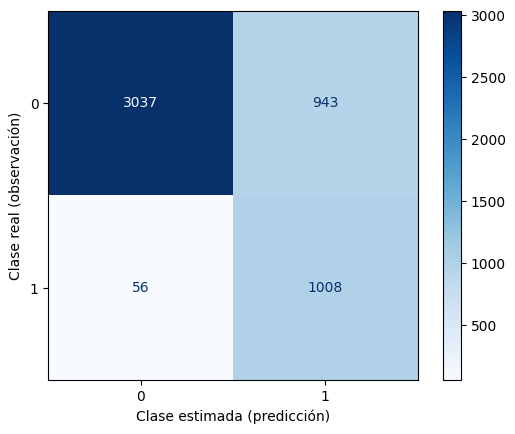

In [ ]:
#Matriz de Confusion
matriz = confusion_matrix(Ytest, Y_hat)

grafico = ConfusionMatrixDisplay(confusion_matrix=matriz,display_labels=modelo_c17.classes_)
grafico.plot(cmap=plt.cm.Blues,values_format='g')
plt.xlabel('Clase estimada (predicción)')
plt.ylabel('Clase real (observación)')
plt.show()

In [ ]:
VN, FP, FN, VP = matriz.ravel()
print(f'Verdaderos positivos (VP): {VP}')
print(f'Falsos positivos (FP): {FP}')
print(f'Verdaderos negativos (VN): {VN}')
print(f'Falsos negativos (FN): {FN}')

Verdaderos positivos (VP): 1008
Falsos positivos (FP): 943
Verdaderos negativos (VN): 3037
Falsos negativos (FN): 56


In [ ]:
#Tasa de error
Tasa_FP_17 = FP/(FP+VN)
Tasa_FN_17 = FN/(FN+VP)

print("Error tipo I: %.2f" % Tasa_FP_17)
print("Error tipo II: %.2f" % Tasa_FN_17)

Error tipo I: 0.24
Error tipo II: 0.05


In [ ]:
#Metricas
print(classification_report(Ytest, Y_hat))

              precision    recall  f1-score   support

           0       0.98      0.76      0.86      3980
           1       0.52      0.95      0.67      1064

    accuracy                           0.80      5044
   macro avg       0.75      0.86      0.76      5044
weighted avg       0.88      0.80      0.82      5044



In [ ]:
#Accuracy
SCORE_17 = modelo_c17.score(Xtest_sc,Ytest)
print("ACCURACY: %.2f" % SCORE_17)

#F1-Score
f1_17 = f1_score(Ytest, Y_hat)
print("F1-Score: %.2f" % f1_17)

ACCURACY: 0.80
F1-Score: 0.67


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 18**

✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo SVM.

In [ ]:
pip install scikit-optimize

In [ ]:
from sklearn.model_selection import StratifiedKFold

In [ ]:
# Define el espacio de búsqueda de hiperparámetros
param_space = {
    'C': (0.1, 100.0, 'log-uniform'),  # Rango logarítmico para C
    'gamma': (0.001, 10.0, 'log-uniform'),  # Rango logarítmico para gamma
    'kernel': ['linear', 'rbf', 'poly'],  # Kernels lineal, RBF y polinómico
    'degree': (1, 5),  # Grado del kernel polinómico
    'coef0': (0.0, 1.0),  # Coeficiente independiente del kernel polinómico
}

# Crea un modelo SVM
modelo = SVC(class_weight='balanced')

# Realiza la búsqueda bayesiana de hiperparámetros
bayes = BayesSearchCV(
    modelo,
    param_space,
    n_iter=30,  # Número de iteraciones de la búsqueda bayesiana
    cv=StratifiedKFold(n_splits=5, shuffle=True, random_state=42),  # Validación cruzada estratificada
    n_jobs=-1,  # Utiliza todos los núcleos del procesador
    verbose=0  # Nivel de verbosidad
)

# Ajusta el modelo SVM con los mejores hiperparámetros encontrados
bayes.fit(Xtrain_sc, Ytrain)

# Muestra los mejores hiperparámetros encontrados
print("Mejores hiperparámetros:")
print(bayes.best_params_)

KeyboardInterrupt: ignored

In [ ]:
modelo_c18 = SVC(**bayes.best_params_,class_weight='balanced')

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_c18.fit(Xtrain_sc, Ytrain)

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

Se pone a prueba el modelo realizando una predicción con datos fuera de la muestra (out-of-sample).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_c18.predict(Xtest_sc)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

In [ ]:
#Matriz de Confusion
matriz = confusion_matrix(Ytest, Y_hat)

grafico = ConfusionMatrixDisplay(confusion_matrix=matriz,display_labels=modelo_c18.classes_)
grafico.plot(cmap=plt.cm.Blues,values_format='g')
plt.xlabel('Clase estimada (predicción)')
plt.ylabel('Clase real (observación)')
plt.show()

In [ ]:
VN, FP, FN, VP = matriz.ravel()
print(f'Verdaderos positivos (VP): {VP}')
print(f'Falsos positivos (FP): {FP}')
print(f'Verdaderos negativos (VN): {VN}')
print(f'Falsos negativos (FN): {FN}')

In [ ]:
#Tasa de error
Tasa_FP_18 = FP/(FP+VN)
Tasa_FN_18 = FN/(FN+VP)

print("Error tipo I: %.2f" % Tasa_FP_18)
print("Error tipo II: %.2f" % Tasa_FN_18)

In [ ]:
#Metricas
print(classification_report(Ytest, Y_hat))

In [ ]:
#Accuracy
SCORE_18 = modelo_c18.score(Xtest_sc,Ytest)
print("ACCURACY: %.2f" % SCORE_18)

#F1-Score
f1_18 = f1_score(Ytest, Y_hat)
print("F1-Score: %.2f" % f1_18)

   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

###**6. Naive Bayes (NB)**

➡️ `Naive Bayes`: Es un conjunto de algoritmos basados en el teorema de Bayes que se utiliza para la clasificación supervisada. El enfoque "naive" asume independencia condicional entre las características, lo que significa que asume que las características son independientes dado el valor de la clase. Para clasificar clases discretas o categóricas, se utiliza el Naive Bayes Multinomial (MultinomialNB) o el Naive Bayes Bernoulli (BernoulliNB).

Bernoulli Naive Bayes (BernoulliNB): Este algoritmo es adecuado cuando tus características son binarias (0/1)

Multinomial Naive Bayes (MultinomialNB): Este algoritmo es adecuado cuando tus características tienen multiples clases (multiclase).

➡️ `BernoulliNB()`: Es un algoritmo de clasificación Naive Bayes que se utiliza cuando las características son binarias (0/1), lo que significa que cada característica puede tomar uno de dos valores posibles. Este algoritmo se basa en el modelo de distribución de Bernoulli, que es apropiado para datos binarios.

Parámetros:



> ●   `alpha` (valor predeterminado: 1.0): Este parámetro controla la suavización de Laplace (Laplace smoothing) aplicada a las frecuencias de las características binarias. Un valor más alto de alpha aumenta la suavización.

> ●   `binarize` (valor predeterminado: 0.0): Este parámetro establece el umbral para binarizar las características. Todas las características con valores iguales o mayores que binarize se establecen en 1, y todas las características con valores menores que binarize se establecen en 0.

> ●   `fit_prior` (valor predeterminado: True): Controla si se deben aprender las probabilidades a priori de clase a partir de los datos de entrenamiento. Si es True, se estimarán las probabilidades a priori; si es False, se utilizarán probabilidades a priori uniformes.

> ●   `class_prior` (valor predeterminado: None): Si se proporciona una lista de probabilidades a priori para las clases, este parámetro permite especificar las probabilidades a priori de clase en lugar de aprenderlas a partir de los datos de entrenamiento.

####**Modelo 19**



✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo NB.


In [ ]:
from sklearn.naive_bayes import BernoulliNB

In [ ]:
modelo_c19 = BernoulliNB()

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_c19.fit(Xtrain_sc, Ytrain)

BernoulliNB()

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_c19.predict(Xtest_sc)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

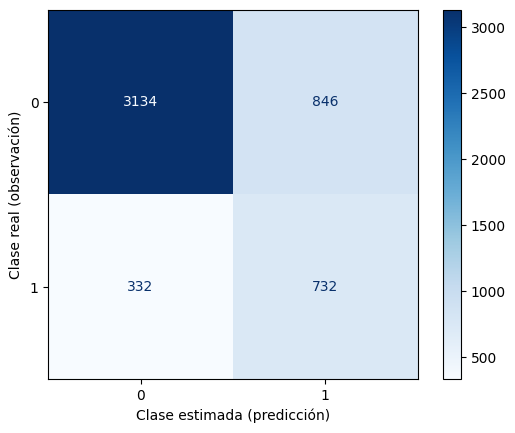

In [ ]:
#Matriz de Confusion
matriz = confusion_matrix(Ytest, Y_hat)

grafico = ConfusionMatrixDisplay(confusion_matrix=matriz,display_labels=modelo_c19.classes_)
grafico.plot(cmap=plt.cm.Blues,values_format='g')
plt.xlabel('Clase estimada (predicción)')
plt.ylabel('Clase real (observación)')
plt.show()

In [ ]:
VN, FP, FN, VP = matriz.ravel()
print(f'Verdaderos positivos (VP): {VP}')
print(f'Falsos positivos (FP): {FP}')
print(f'Verdaderos negativos (VN): {VN}')
print(f'Falsos negativos (FN): {FN}')

Verdaderos positivos (VP): 732
Falsos positivos (FP): 846
Verdaderos negativos (VN): 3134
Falsos negativos (FN): 332


In [ ]:
#Tasa de error
Tasa_FP_19 = FP/(FP+VN)
Tasa_FN_19 = FN/(FN+VP)

print("Error tipo I: %.2f" % Tasa_FP_19)
print("Error tipo II: %.2f" % Tasa_FN_19)

Error tipo I: 0.21
Error tipo II: 0.31


In [ ]:
#Metricas
print(classification_report(Ytest, Y_hat))

              precision    recall  f1-score   support

           0       0.90      0.79      0.84      3980
           1       0.46      0.69      0.55      1064

    accuracy                           0.77      5044
   macro avg       0.68      0.74      0.70      5044
weighted avg       0.81      0.77      0.78      5044



In [ ]:
#Accuracy
SCORE_19 = modelo_c19.score(Xtest_sc,Ytest)
print("ACCURACY: %.2f" % SCORE_19)

#F1-Score
f1_19 = f1_score(Ytest, Y_hat)
print("F1-Score: %.2f" % f1_19)

ACCURACY: 0.77
F1-Score: 0.55


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 20**



✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo NB.


In [ ]:
# Ajustar los pesos de clase en función del desequilibrio de clases
class_weights = {0: 0.1, 1: 0.9}
# Peso menor para la clase mayoritaria (0) y mayor peso para la clase minoritaria (1)

# Crear un modelo Bernoulli Naive Bayes con pesos de clase personalizados
modelo_c20 = BernoulliNB(class_prior=list(class_weights.values()))

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_c20.fit(Xtrain_sc, Ytrain)

BernoulliNB(class_prior=[0.1, 0.9])

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_c20.predict(Xtest_sc)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

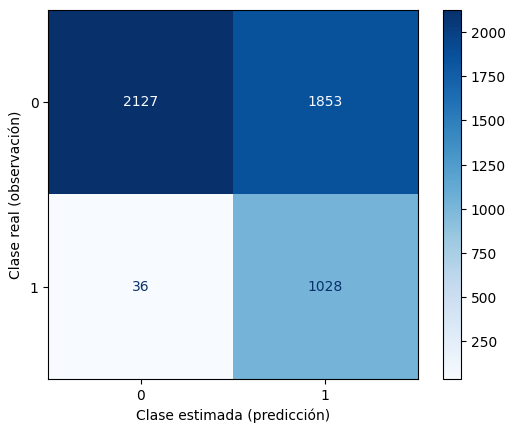

In [ ]:
#Matriz de Confusion
matriz = confusion_matrix(Ytest, Y_hat)

grafico = ConfusionMatrixDisplay(confusion_matrix=matriz,display_labels=modelo_c20.classes_)
grafico.plot(cmap=plt.cm.Blues,values_format='g')
plt.xlabel('Clase estimada (predicción)')
plt.ylabel('Clase real (observación)')
plt.show()

In [ ]:
VN, FP, FN, VP = matriz.ravel()
print(f'Verdaderos positivos (VP): {VP}')
print(f'Falsos positivos (FP): {FP}')
print(f'Verdaderos negativos (VN): {VN}')
print(f'Falsos negativos (FN): {FN}')

Verdaderos positivos (VP): 1028
Falsos positivos (FP): 1853
Verdaderos negativos (VN): 2127
Falsos negativos (FN): 36


In [ ]:
#Tasa de error
Tasa_FP_20 = FP/(FP+VN)
Tasa_FN_20 = FN/(FN+VP)

print("Error tipo I: %.2f" % Tasa_FP_20)
print("Error tipo II: %.2f" % Tasa_FN_20)

Error tipo I: 0.47
Error tipo II: 0.03


In [ ]:
#Metricas
print(classification_report(Ytest, Y_hat))

              precision    recall  f1-score   support

           0       0.98      0.53      0.69      3980
           1       0.36      0.97      0.52      1064

    accuracy                           0.63      5044
   macro avg       0.67      0.75      0.61      5044
weighted avg       0.85      0.63      0.66      5044



In [ ]:
#Accuracy
SCORE_20 = modelo_c20.score(Xtest_sc,Ytest)
print("ACCURACY: %.2f" % SCORE_20)

#F1-Score
f1_20 = f1_score(Ytest, Y_hat)
print("F1-Score: %.2f" % f1_20)

ACCURACY: 0.63
F1-Score: 0.52


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

####**Modelo 21**



✅ Paso 1 - Definición de variables: Utilizamos las variables $X$ e $Y$ previamente definidas y divididas en conjunto de entrenamiento y prueba.

✅ Paso 2 - Modelo: Creación del modelo NB.


In [ ]:
# Definir los hiperparámetros para optimizar
param_grid = {
    'alpha': [0.1, 0.5, 1.0, 1.5, 2.0],  # Valores posibles para el hiperparámetro alpha
}

# Ajustar los pesos de clase en función del desequilibrio de clases
class_weights = {0: 0.1, 1: 0.9}
# Peso menor para la clase mayoritaria (0) y mayor peso para la clase minoritaria (1)

# Crear un modelo Bernoulli Naive Bayes con pesos de clase personalizados
modelo = BernoulliNB(class_prior=list(class_weights.values()))

# Crear un objeto GridSearchCV para buscar los mejores hiperparámetros
grid_search = GridSearchCV(estimator=modelo, param_grid=param_grid, scoring='f1', cv=5)

# Entrenar el modelo con búsqueda de hiperparámetros en los datos de entrenamiento
grid_search.fit(Xtrain_sc, Ytrain)

# Obtener el mejor modelo y los mejores hiperparámetros
best_model = grid_search.best_estimator_
best_params = grid_search.best_params_

In [ ]:
modelo_c21 = BernoulliNB(alpha=best_params['alpha'], class_prior=list(class_weights.values()))

✅ Paso 3 - Entrenamiento: Entrenamiento del modelo ajustándolo con Xtrain y Ytrain.

In [ ]:
modelo_c21.fit(Xtrain_sc, Ytrain)

BernoulliNB(alpha=0.5, class_prior=[0.1, 0.9])

✅ Paso 4 - Predicción: Estimación de la variable Ytest usando como entrada la variable Xtest. Como resultado obtenemos $\hat Y$ (Y_hat).

In [ ]:
#Estimacion de Y (Y "gorro")
Y_hat = modelo_c21.predict(Xtest_sc)

✅ Paso 5 - Métricas: Evaluamos el desempeño del modelo a través del cálculo de métricas.

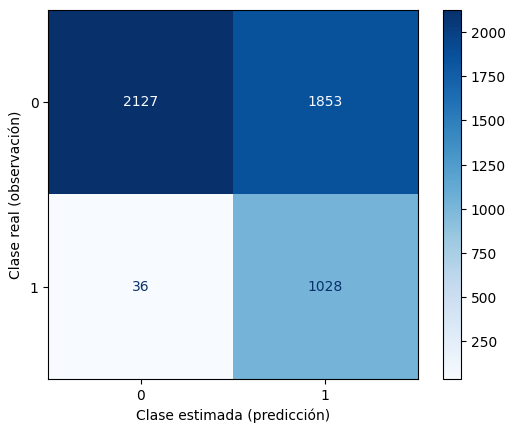

In [ ]:
#Matriz de Confusion
matriz = confusion_matrix(Ytest, Y_hat)

grafico = ConfusionMatrixDisplay(confusion_matrix=matriz,display_labels=modelo_c21.classes_)
grafico.plot(cmap=plt.cm.Blues,values_format='g')
plt.xlabel('Clase estimada (predicción)')
plt.ylabel('Clase real (observación)')
plt.show()

In [ ]:
VN, FP, FN, VP = matriz.ravel()
print(f'Verdaderos positivos (VP): {VP}')
print(f'Falsos positivos (FP): {FP}')
print(f'Verdaderos negativos (VN): {VN}')
print(f'Falsos negativos (FN): {FN}')

Verdaderos positivos (VP): 1028
Falsos positivos (FP): 1853
Verdaderos negativos (VN): 2127
Falsos negativos (FN): 36


In [ ]:
#Tasa de error
Tasa_FP_21 = FP/(FP+VN)
Tasa_FN_21 = FN/(FN+VP)

print("Error tipo I: %.2f" % Tasa_FP_21)
print("Error tipo II: %.2f" % Tasa_FN_21)

Error tipo I: 0.47
Error tipo II: 0.03


In [ ]:
#Metricas
print(classification_report(Ytest, Y_hat))

              precision    recall  f1-score   support

           0       0.98      0.53      0.69      3980
           1       0.36      0.97      0.52      1064

    accuracy                           0.63      5044
   macro avg       0.67      0.75      0.61      5044
weighted avg       0.85      0.63      0.66      5044



In [ ]:
#Accuracy
SCORE_21 = modelo_c21.score(Xtest_sc,Ytest)
print("ACCURACY: %.2f" % SCORE_21)

#F1-Score
f1_21 = f1_score(Ytest, Y_hat)
print("F1-Score: %.2f" % f1_21)

ACCURACY: 0.63
F1-Score: 0.52


   🟠  ¡Ahora es tu turno de interpretar los resultados!  🟠

#**ETAPA V: EVALUACIÓN**

✅ Una vez realizados todos los experimentos, se comparan los modelos para definir el modelo ganador con el que se trabajará.

##**1. Evaluación Regresión**

In [ ]:
tabla = pd.DataFrame({'Métrica':['MAE:','MSE:','RMSE:','r2:'],
                      'Regresión lineal':[MAE_2,MSE_2,RMSE_2,r2_2],
                      'Árbol de Decisión':[MAE_8,MSE_8,RMSE_8,r2_8],
                      'KNN':[MAE_12,MSE_12,RMSE_12,r2_12],
                      'Random Forest':[MAE_15,MSE_15,RMSE_15,r2_15],
                      'SVM':[MAE_19,MSE_19,RMSE_19,r2_19],
                      'Regresión Lasso':[MAE_23,MSE_23,RMSE_23,r2_23],
                      'Regresión Ridge':[MAE_26,MSE_26,RMSE_26,r2_26]})

# Obtener la fila 'RMSE:' y convertirla a números flotantes
fila_rmse = tabla.loc[2, tabla.columns != 'Métrica']
fila_rmse = fila_rmse.astype(float)

# Aplicar el formato a dos decimales a la fila 'RMSE:'
tabla.loc[2, tabla.columns != 'Métrica'] = fila_rmse.apply("{:.2f}".format)

# Tabla resultante
tabla

,Métrica,Regresión lineal,Árbol de Decisión,KNN,Random Forest,SVM,Regresión Lasso,Regresión Ridge
0,MAE:,3347.52,1985.37,1562.86,1463.30,3197.25,3347.52,3347.52
1,MSE:,20699477.64,11433858.17,9368021.15,7598393.58,23412875.19,20699477.94,20699486.03
2,RMSE:,4549.67,3381.40,3060.72,2756.52,4838.69,4549.67,4549.67
3,r2:,0.51,0.73,0.78,0.82,0.44,0.51,0.51


Considerando el modelo con menor error y el mayor ajuste, el modelo ganador sería el modelo número 15 de Random Forest.

Se guarda el modelo ganador para ser utilizado para realizar pronósticos en la etapa de despliegue.

In [ ]:
import joblib

# Guardar el modelo en un archivo
joblib.dump(modelo_15, 'modelo_regresion.pkl')

['modelo_regresion.pkl']

##**2. Evaluación Clasificación**

In [ ]:
tabla = pd.DataFrame({'Métrica':['Error Tipo I:','Error Tipo II:','Accuracy:','F1-Score'],
                      'Regresión Logística':[Tasa_FP_4,Tasa_FN_4,SCORE_4,f1_4],
                      'Árbol de Decisión':[Tasa_FP_6,Tasa_FN_6,SCORE_6,f1_6],
                      'KNN':[Tasa_FP_10,Tasa_FN_10,SCORE_10,f1_10],
                      'Random Forest':[Tasa_FP_14,Tasa_FN_14,SCORE_14,f1_14],
                      'SVM':[Tasa_FP_17,Tasa_FN_17,SCORE_17,f1_17],
                      'Naive Bayes':[Tasa_FP_21,Tasa_FN_21,SCORE_21,f1_21]})

# Tabla resultante
tabla

,Métrica,Regresión Logística,Árbol de Decisión,KNN,Random Forest,SVM,Naive Bayes
0,Error Tipo I:,0.205779,0.087186,0.086181,0.112312,0.236935,0.465578
1,Error Tipo II:,0.049812,0.144737,0.424812,0.139098,0.052632,0.033835
2,Accuracy:,0.827121,0.900674,0.842387,0.882038,0.801943,0.625496
3,F1-Score,0.698687,0.784145,0.606241,0.754841,0.668657,0.521166


In [ ]:
import joblib

# Guardar el modelo en un archivo
joblib.dump(modelo_c6, 'modelo_clasificacion.pkl')

['modelo_clasificacion.pkl']



---


#**ETAPA VI: DESPLIEGUE**

✅ Se ponen a prueba los modelos ganadores de las tareas de regresión y clasificación realizando una predicción con datos nuevos fuera de la muestra que no forman parte del conjunto de datos de entrenamiento ni de validación, es decir, con datos en tiempo real (generalización). Este es un aspecto fundamental a considerar al evaluar y aplicar un modelo predictivo en entornos reales.

➡️ `Generalización`: Predicción con datos que no han sido utilizados durante el entrenamiento ni la validación del modelo. Cuando se utilizan datos nuevos en tiempo real para hacer predicciones out-of-sample, se pone a prueba la capacidad de generalización del modelo en situaciones completamente nuevas y desconocidas.

##**1. Pronóstico Regresión**

Para probar el poder de generallización del modelo ganador, se usan datos nuevos de las variables $X$ con las características de otras casas para predecir el valor de $Y$, para comprobar si se acerca al valor real del Precio en UF de casas a la venta en la RM.

✅ Pronóstico con datos simulados: Si no se tienen datos reales, se pueden generar valores aleatorios sintéticos de $X$ para realizar un pronóstico. Para esto se define una función para generar numeros aleatorios dentro del rango de las variables explicativas $X$, utilizando el minimo y el maximo del dataset original:

In [ ]:
import numpy as np # Programación vectorial
import pandas as pd # Estructura y manipulación de datos
import random # Generación de números aleatorios

In [ ]:
# Importación del dataset original
data = pd.read_excel("Guia_Modelos_de_Regresion.xlsx")
X = df.drop(columns=['Precio_UF','Precio_CLP'])
X.sample(5)

,Comuna,N_Habitaciones,N_Baños,Superficie_Construida_M2,Total_Superficie_M2,N_Estacionamientos,Estado
11562,5,3,3,140,355.00,3,0
6275,42,3,3,200,675.50,0,0
13235,1,4,2,157,229.00,0,0
5358,42,4,2,329,84.00,1,1
6185,51,4,2,139,519.00,3,0


In [ ]:
#Función para generar variables X dentro de los rangos minimos y maximos:
def generate_random_data(num_rows):
    np.random.seed(123) #Puedes quitar la semilla para probar con distintos resultados aleatorios
    random_data = {
        key: np.random.randint(low, high, size=num_rows) for key, low, high in [
            ('Comuna', X['Comuna'].min(), X['Comuna'].max()+1),
            ('N_Habitaciones', X['N_Habitaciones'].min(), X['N_Habitaciones'].max()+1),
            ('N_Baños', X['N_Baños'].min(), X['N_Baños'].max()+1),
            ('Superficie_Construida_M2', X['Superficie_Construida_M2'].min(), X['Superficie_Construida_M2'].max()+1),
            ('Total_Superficie_M2', X['Total_Superficie_M2'].min(), X['Total_Superficie_M2'].max()+1),
            ('N_Estacionamientos',X['N_Estacionamientos'].min(), X['N_Estacionamientos'].max()+1),
            ('Estado', 0, 1+1)
        ]
    }

    X_rand = pd.DataFrame(random_data)

    return X_rand

In [ ]:
# Uso de la función para generar un DataFrame con X filas
X_rand = generate_random_data(10) #Puedes cambiar el numero para probar con más registros
X_rand.head(10)

,Comuna,N_Habitaciones,N_Baños,Superficie_Construida_M2,Total_Superficie_M2,N_Estacionamientos,Estado
0,45,1,4,3,631,3,1
1,2,2,3,40,412,3,1
2,28,7,2,323,291,5,0
3,34,8,1,85,589,4,1
4,38,2,1,48,107,4,1
5,17,1,1,177,577,5,1
6,19,7,1,136,419,3,0
7,42,1,2,100,395,2,1
8,22,8,4,181,147,0,1
9,33,2,4,214,485,4,1


✅ Predicción de la variable objetivo $Y$ usando el modelo ganador:

In [ ]:
import joblib

In [ ]:
# Cargar el modelo desde el archivo
regresion = joblib.load('modelo_regresion.pkl')

In [ ]:
# Pronóstico de la variable objetivo usando el modelo ganador
Y_hat = regresion.predict(X_rand)

In [ ]:
# Crear un DataFrame a partir de las predicciones Y_hat
resultados = pd.DataFrame(X_rand)
resultados['Pronostico'] = Y_hat
resultados

,Comuna,N_Habitaciones,N_Baños,Superficie_Construida_M2,Total_Superficie_M2,N_Estacionamientos,Estado,Pronostico
0,45,1,4,3,631,3,1,5030.01
1,2,2,3,40,412,3,1,3452.27
2,28,7,2,323,291,5,0,12057.68
3,34,8,1,85,589,4,1,2908.89
4,38,2,1,48,107,4,1,1992.67
5,17,1,1,177,577,5,1,2575.06
6,19,7,1,136,419,3,0,8440.31
7,42,1,2,100,395,2,1,3905.36
8,22,8,4,181,147,0,1,3388.74
9,33,2,4,214,485,4,1,12193.78


In [ ]:
# Exportar los resultados a un archivo Excel
resultados.to_excel('resultados.xlsx', index=False)
# index=False para no incluir el índice en el archivo

✅ Pronósticos con datos reales: Se toman datos nuevos de la misma fuente donde se obtuvieron, para buscar características de un nuevo registro (en este caso, una casa) que no haya sido utilizado en el proceso de modelado. De esta forma se puede comparar si el valor real del precio en UF de la casa elegida es cercano al pronóstico realizado.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

regresion = joblib.load("/content/drive/My Drive/MATERIAL CLASES/Machine Learning/modelo_regresion.pkl")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


**Ejemplo 1:** Se elije la casa en venta extraída desde : https://chilepropiedades.cl/ver-publicacion/venta/maipu/casa/las-cruces-300/24141590

In [ ]:
casa_maipu = {'Comuna':25,
            'N_Habitaciones':3,
            'N_Baños':2,
            'Superficie_Construida_M2':70,
            'Total_Superficie_M2':113,
            'N_Estacionamientos':1,
            'Estado': 0}

casa_maipu = pd.DataFrame(casa_maipu, index=[0])

In [ ]:
# Pronóstico de la variable objetivo usando el modelo ganador
Y_hat = regresion.predict(casa_maipu)
print(f"El precio pronosticado de la nueva casa es: UF {round(float(Y_hat),2)}")

El precio pronosticado de la nueva casa es: UF 3600.01


In [ ]:
print(f"El precio real de la casa es de UF 2872.93, por lo tanto, el error es de: UF {round(float((Y_hat)- 2872.93),2)}")

El precio real de la casa es de UF 2872.93, por lo tanto, el error es de: UF 727.08


**Ejemplo 2:**

In [ ]:
casa_laflorida = {'Comuna':15,
                  'N_Habitaciones':3,
                  'N_Baños':2,
                  'Superficie_Construida_M2':80,
                  'Total_Superficie_M2':125,
                  'N_Estacionamientos':3,
                  'Estado': 0}

casa_laflorida = pd.DataFrame(casa_laflorida, index=[0])

In [ ]:
# Pronóstico de la variable objetivo usando el modelo ganador
Y_hat = regresion.predict(casa_laflorida)
print(f"El precio pronosticado de la nueva casa es: UF {round(float(Y_hat),2)}")

El precio pronosticado de la nueva casa es: UF 4337.96


In [ ]:
print(f"El precio real de la casa es de UF 2734.81, por lo tanto, el error es de: UF {round(float((Y_hat)- 2872.93),2)}")

El precio real de la casa es de UF 2734.81, por lo tanto, el error es de: UF 1465.03


**Ejemplo 3**

In [ ]:
casa_estcentral = {'Comuna':10,
                  'N_Habitaciones':3,
                  'N_Baños':1,
                  'Superficie_Construida_M2':77.5,
                  'Total_Superficie_M2':171,
                  'N_Estacionamientos':2,
                  'Estado': 0}

casa_estcentral = pd.DataFrame(casa_estcentral, index=[0])

In [ ]:
# Pronóstico de la variable objetivo usando el modelo ganador
Y_hat = regresion.predict(casa_estcentral)
print(f"El precio pronosticado de la nueva casa es: UF {round(float(Y_hat),2)}")

El precio pronosticado de la nueva casa es: UF 3365.69


In [ ]:
print(f"El precio real de la casa es de UF 3563.54, por lo tanto, el error es de: UF {round(float((Y_hat)- 3563.54),2)}")

El precio real de la casa es de UF 3563.54, por lo tanto, el error es de: UF -197.85


##**2. Pronóstico Clasificación**

Si no se tienen datos reales, se pueden generar valores aleatorios sintéticos de $X$ para realizar un pronóstico. Para esto se define una función para generar numeros aleatorios dentro del rango de las variables explicativas $X$, utilizando el minimo y el maximo del dataset original:

In [ ]:
import numpy as np # Programación vectorial
import pandas as pd # Estructura y manipulación de datos
import random # Generación de números aleatorios

In [ ]:
# Importación del dataset preprocesado
df = pd.read_excel("Guia_Machine_Learning_Preprocesado.xlsx")
X = df.drop(columns=['Estado','Precio_CLP'])
X.sample(5)

,Precio_UF,Comuna,N_Habitaciones,N_Baños,Superficie_Construida_M2,Total_Superficie_M2,N_Estacionamientos
5062,2700.0,36,4,1,72,98.0,2
654,10800.0,18,4,3,136,360.0,3
3266,5090.0,28,3,2,90,180.0,2
7499,6180.0,20,3,4,133,229.0,5
395,6000.0,7,4,4,200,200.0,0


In [ ]:
#Función para generar variables X dentro de los rangos minimos y maximos:
def generate_random_data(num_rows):
    np.random.seed(123) #Puedes quitar la semilla para probar con distintos resultados aleatorios
    random_data = {
        key: np.random.randint(low, high, size=num_rows) for key, low, high in [
            ('Comuna', X['Comuna'].min(), X['Comuna'].max()+1),
            ('N_Habitaciones', X['N_Habitaciones'].min(), X['N_Habitaciones'].max()+1),
            ('N_Baños', X['N_Baños'].min(), X['N_Baños'].max()+1),
            ('Superficie_Construida_M2', X['Superficie_Construida_M2'].min(), X['Superficie_Construida_M2'].max()+1),
            ('Total_Superficie_M2', X['Total_Superficie_M2'].min(), X['Total_Superficie_M2'].max()+1),
            ('N_Estacionamientos',X['N_Estacionamientos'].min(), X['N_Estacionamientos'].max()+1),
            ('Precio_UF',X['Precio_UF'].min(), X['Precio_UF'].max()+1)
        ]
    }

    X_rand = pd.DataFrame(random_data)

    return X_rand

In [ ]:
# Uso de la función para generar un DataFrame con X filas
X_rand = generate_random_data(10) #Puedes cambiar el numero para probar con más registros
X_rand.head(10)

,Comuna,N_Habitaciones,N_Baños,Superficie_Construida_M2,Total_Superficie_M2,N_Estacionamientos,Precio_UF
0,45,1,4,3,631,3,20839
1,2,2,3,40,412,3,17334
2,28,7,2,323,291,5,22471
3,34,8,1,85,589,4,17537
4,38,2,1,48,107,4,8747
5,17,1,1,177,577,5,3258
6,19,7,1,136,419,3,9573
7,42,1,2,100,395,2,8887
8,22,8,4,181,147,0,6578
9,33,2,4,214,485,4,10196


✅ Predicción de la variable objetivo $Y$ usando el modelo ganador:

In [ ]:
# Cargar el modelo desde el archivo
clasificacion = joblib.load('modelo_clasificacion.pkl')

In [ ]:
# Pronóstico de la variable objetivo usando el modelo ganador
Y_hat = clasificacion.predict(X_rand)

In [ ]:
# Crear un DataFrame a partir de las predicciones Y_hat
resultados = pd.DataFrame(X_rand)
resultados['Pronostico'] = Y_hat
resultados

,Comuna,N_Habitaciones,N_Baños,Superficie_Construida_M2,Total_Superficie_M2,N_Estacionamientos,Precio_UF,Pronostico
0,45,1,4,3,631,3,20839,0
1,2,2,3,40,412,3,17334,0
2,28,7,2,323,291,5,22471,0
3,34,8,1,85,589,4,17537,0
4,38,2,1,48,107,4,8747,0
5,17,1,1,177,577,5,3258,0
6,19,7,1,136,419,3,9573,0
7,42,1,2,100,395,2,8887,0
8,22,8,4,181,147,0,6578,0
9,33,2,4,214,485,4,10196,0


In [ ]:
# Exportar los resultados a un archivo Excel
resultados.to_excel('resultados_clasificacion.xlsx', index=False)
# index=False para no incluir el índice en el archivo

---
---
# **DOCUMENTACIÓN**

Numpy: https://numpy.org/devdocs/user/index.html#user

Pandas: https://pandas.pydata.org/docs/user_guide/index.html

Matplotlib: https://matplotlib.org/stable/users/index.html

Seaborn: https://seaborn.pydata.org/tutorial.html

Scikit-learn: https://scikit-learn.org/stable/user_guide.html

Statsmodels: https://www.statsmodels.org/stable/user-guide.html